In [ ]:
!pip install opencv-python==3.4.2.17
!pip install opencv-contrib-python==3.4.2.17

     |████████████████████████████████| 25.0 MB 6.2 MB/s 
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
     |████████████████████████████████| 30.6 MB 1.5 MB/s 
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.30


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.ndimage.filters import convolve as convolveim
import scipy.ndimage.filters as filters
import scipy.ndimage as ndimage
import math

#%matplotlib inline

In [ ]:
def cylindrical_projection(img , f) :
    # f = radius of cylinder or focal length
    rows = img.shape[0]
    cols = img.shape[1]

    blank = np.zeros_like(img)
    center_x = int(cols / 2)
    center_y = int(rows / 2)
   
    for  y in range(rows):
        for x in range(cols):
            theta = math.atan((x- center_x )/ f)
            point_x = int(f * math.tan( (x-center_x) / f) + center_x)
            point_y = int( (y-center_y) / math.cos(theta) + center_y)
            
            if point_x >= cols or point_x < 0 or point_y >= rows or point_y < 0:
                pass
            else:
                #blank[y , x, :] = img[point_y , point_x ,:]
                blank[y , x] = img[point_y , point_x]
    return blank

In [ ]:
def stitch(img1, img2):

    # pad top side of img1 and img2 with zero values
    col_scale = 1
    row_scale = 1.25
    (rows, cols) = img1.shape[:2]
    (rows2, cols2) = img2.shape[:2]

    rows_pad = int(row_scale*rows)
    img1_pad = np.zeros((rows_pad, cols))
    img1_pad[-rows:,:] = img1

    img1 = img1_pad.astype(np.uint8)
    '''
    plt.figure(figsize=(10,10))
    plt.imshow(img1, cmap='gray')
    '''

    rows2_pad = int(row_scale*rows2)
    img2_pad = np.zeros((rows2_pad, cols2))
    img2_pad[-rows2:,:] = img2
    img2 = img2_pad.astype(np.uint8)

    # use SIFT to detect features
    sift = cv2.xfeatures2d.SIFT_create()

    kp1 = sift.detect(img1, None)
    kp2 = sift.detect(img2, None)

    # Visualize the keypoints
    img1_kps = cv2.drawKeypoints(img1,kp1,None,flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    img2_kps = cv2.drawKeypoints(img2,kp2,None,flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    # Use sift.compute to generate sift descriptors/features
    (kp1, features1) = sift.compute(img1,kp1)
    (kp2, features2) = sift.compute(img2,kp2)


    kp1 = np.float32([kp.pt for kp in kp1])
    kp2 = np.float32([kp.pt for kp in kp2])

    matcher = cv2.DescriptorMatcher_create("BruteForce")

    # Use knnMatch function in matcher to find corresonding features
    # For robustness of the matching results, we'd like to find 2 best matches (i.e. k=2 for knnMatch) 
    # and return their matching distances 
    rawMatches = matcher.knnMatch(features1, features2, k=2)
    matches = []

    # validate if the matching is reliable by checking if the best maching distance is less than 
    # the second matching by a threshold, for example, 20% of the 2nd best maching distance
    for m in rawMatches:
        # Ensure the distance is within a certain ratio of each other (i.e. Lowe's ratio test)
        # Test the distance between points. use m[0].distance and m[1].distance
        if len(m) == 2 and (m[0].distance < 0.8 * m[1].distance) : 
            matches.append((m[0].trainIdx, m[0].queryIdx))

    ptsA = np.float32([kp1[i] for (_,i) in matches])
    ptsB = np.float32([kp2[i] for (i,_) in matches])

    # Find homography with RANSAC
    (H, status) = cv2.findHomography(ptsB ,ptsA, cv2.RANSAC)

    '''
    img_ransac = drawMatches(img1,img2,kp1,kp2,matches,status)
    plt.figure(figsize=(15,15))
    plt.imshow(img_ransac,'gray')
    plt.title('Matching points (After RANSAC)')
    plt.show()
    '''

    # fill in the arguments to warp the second image to fit the first image.
    # First transform the right image, then fill in the left part with the orignal left image

    result = cv2.warpPerspective(img2, H, dsize=(int((cols + cols2)*col_scale), int(rows*row_scale)))

    preliminary = result.copy()
    #preliminary[0:rows, 0:cols] = img1
    plt.figure(figsize=(10,10))
    plt.imshow(preliminary, cmap='gray')
    plt.title('Preliminary result of Cylindrical Projection')

    # Blend images and eluminate black borders
    # Inspired by https://blog.csdn.net/wgz52157/article/details/117607646
    for col in range(0,cols):
        if img1[:, col].any() and result[:, col].any():
            left = col
            break
    for col in range(cols-1, 0, -1):
        if img1[:, col].any() and result[:, col].any():
            right = col
            break

    res = np.zeros([rows_pad, cols], np.uint8)
    for row in range(0, rows_pad):
        for col in range(0, cols):
            if not img1[row, col].any():
                res[row, col] = result[row, col]
            elif not result[row, col].any():
                res[row, col] = img1[row, col]
            else:
                left_dis = float(abs(col - left))
                right_dis = float(abs(col - right))
                ratio = left_dis / (left_dis + right_dis)
                res[row, col] = np.clip(img1[row, col] * (1-ratio) + result[row, col] * ratio, 0, 255)

    result[0:img1.shape[0], 0:img1.shape[1]]=res


    plt.figure(figsize=(10,10))
    plt.imshow(result, 'gray')
    plt.title('Final Result of Cylindrical Projection')
    plt.show()

    return result

In [ ]:
def edge_delete(img):
    rows, cols = img.shape

    left = 0
    right = 0
    top = 0
    bott = 0
    for col in range(0, cols):
        if img[:, col].any():
            left = col
            break
    for col in range(cols - 1, 0, -1):
        if img[:, col].any():
            right = col
            break

    for row in range(0, rows):
        if img[row, :].any():
            top = row
            break
    for row in range(rows - 1, 0, -1):
        if img[row, :].any():
            bott = row
            break

    blank = np.zeros((right - left + 1, bott - top + 1))
    blank = img[top:bott + 1, left:right + 1].astype(np.uint8)

    plt.figure(figsize=(20,20))
    plt.imshow(blank, cmap='gray')
    return blank

# Stitch more than two images

In [ ]:
path = '/content/drive/MyDrive/IVP Image/'

In [ ]:
# Read images
i01 = cv2.imread(path + '1.jpg',0)
i02 = cv2.imread(path + '2.jpg',0)
i03 = cv2.imread(path + '3.jpg',0)
i04 = cv2.imread(path + '4.jpg',0)
i05 = cv2.imread(path + '5.jpg',0)
i06 = cv2.imread(path + '6.jpg',0)
i07 = cv2.imread(path + '7.jpg',0)
i08 = cv2.imread(path + '8.jpg',0)
i09 = cv2.imread(path + '9.jpg',0)
i010 = cv2.imread(path + '10.jpg',0)
i011 = cv2.imread(path + '11.jpg',0)

In [ ]:
# Resized image to reduce computation of finding features and stitching
k = 5
height = int((i01.shape[0])/k)
width = int((i01.shape[1])/k)

# resize the image by resize() function of openCV library
i01 = cv2.resize(i01, (width, height), interpolation=cv2.INTER_AREA)
i02 = cv2.resize(i02, (width, height), interpolation=cv2.INTER_AREA)
i03 = cv2.resize(i03, (width, height), interpolation=cv2.INTER_AREA)
i04 = cv2.resize(i04, (width, height), interpolation=cv2.INTER_AREA)
i05 = cv2.resize(i05, (width, height), interpolation=cv2.INTER_AREA)
i06 = cv2.resize(i06, (width, height), interpolation=cv2.INTER_AREA)
i07 = cv2.resize(i07, (width, height), interpolation=cv2.INTER_AREA)
i08 = cv2.resize(i08, (width, height), interpolation=cv2.INTER_AREA)
i09 = cv2.resize(i09, (width, height), interpolation=cv2.INTER_AREA)
i010 = cv2.resize(i010, (width, height), interpolation=cv2.INTER_AREA)
i011 = cv2.resize(i011, (width, height), interpolation=cv2.INTER_AREA)

i01.shape

## f = 1000 with pad

Text(0.5, 1.0, 'I6')

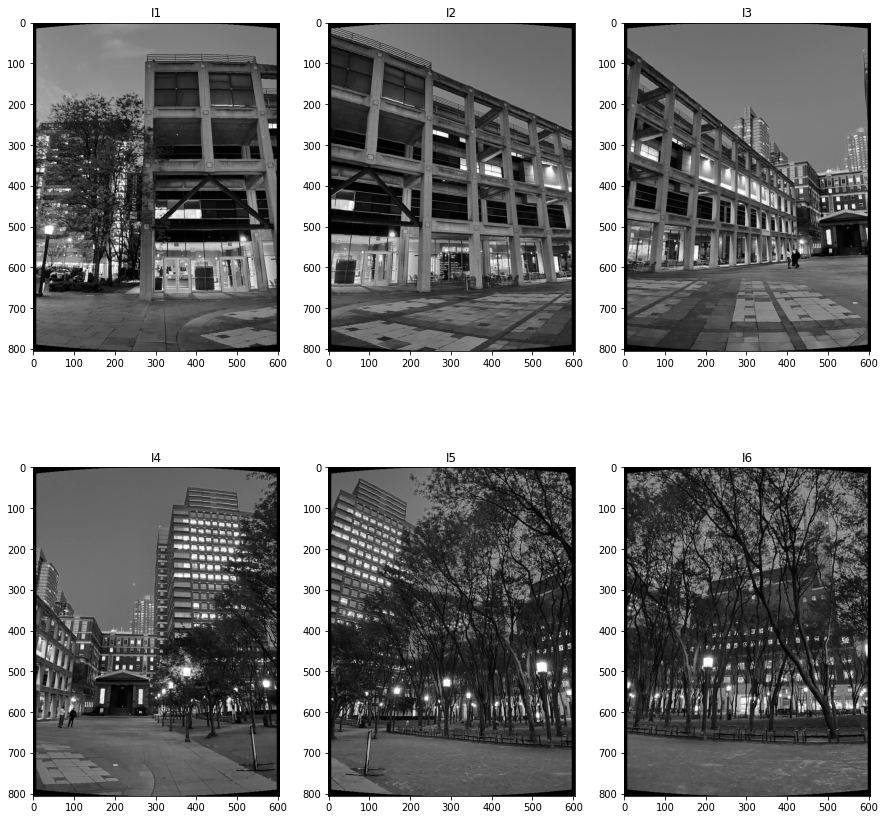

In [ ]:
# apply cylindrical projection
f = 1000
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)
i8 = cylindrical_projection(i08, f)
i9 = cylindrical_projection(i09, f)
i10 = cylindrical_projection(i010, f)
i11 = cylindrical_projection(i011, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

Text(0.5, 1.0, 'I11')

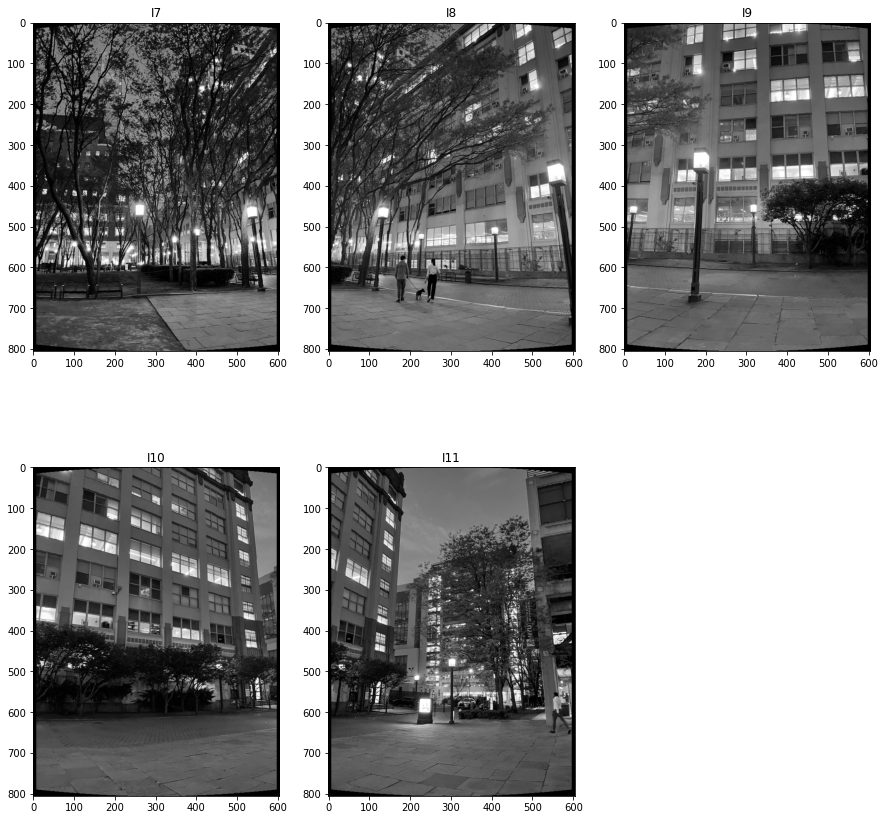

In [ ]:
plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i7, 'gray')
plt.title('I7')
plt.subplot(232)
plt.imshow(i8, 'gray')
plt.title('I8')
plt.subplot(233)
plt.imshow(i9, 'gray')
plt.title('I9')
plt.subplot(234)
plt.imshow(i10, 'gray')
plt.title('I10')
plt.subplot(235)
plt.imshow(i11, 'gray')
plt.title('I11')

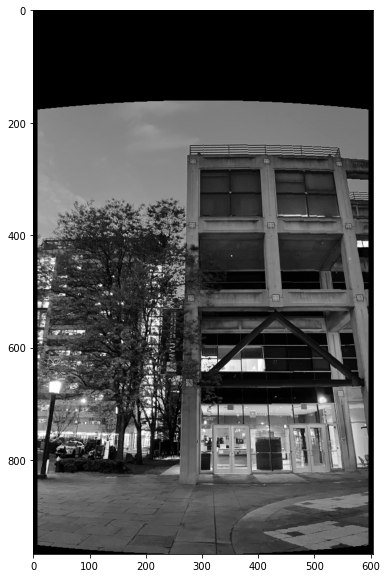

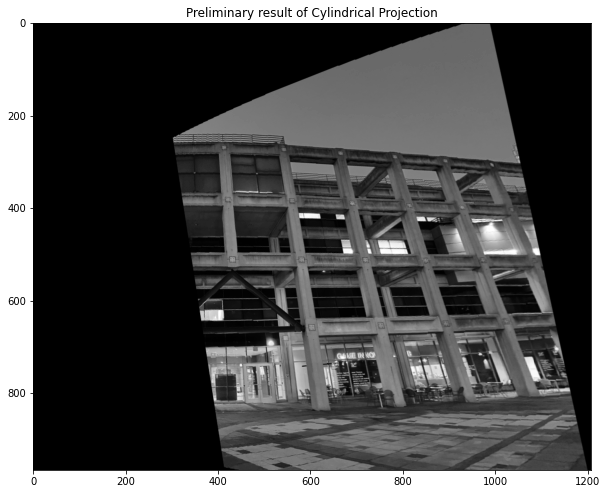

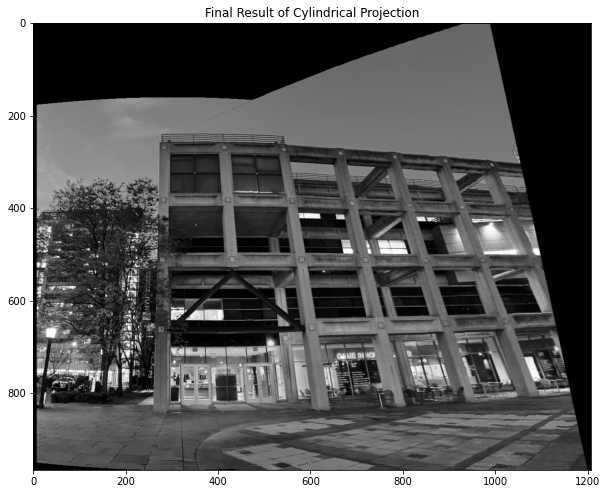

In [ ]:
i12 = stitch(i1,i2)

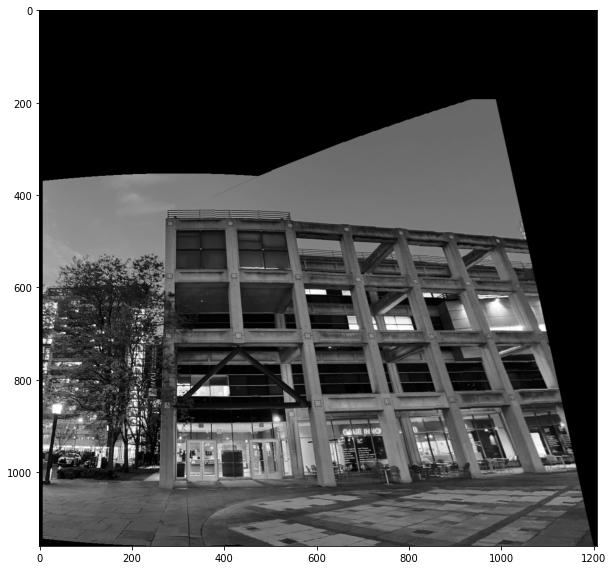

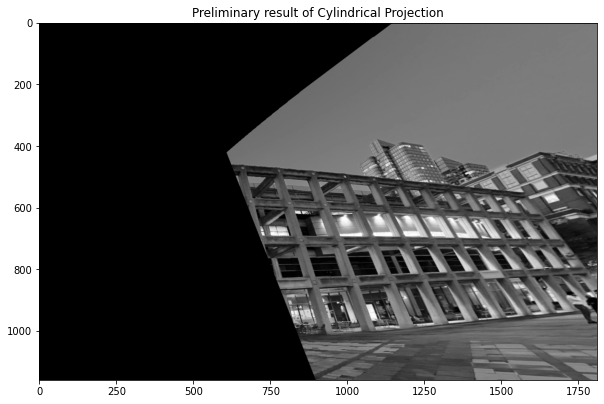

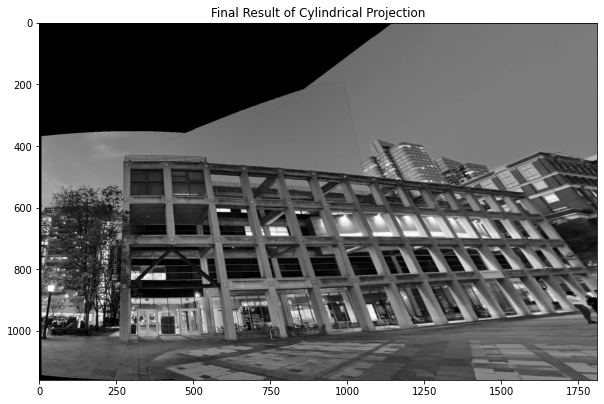

In [ ]:
i123 = stitch(i12,i3)

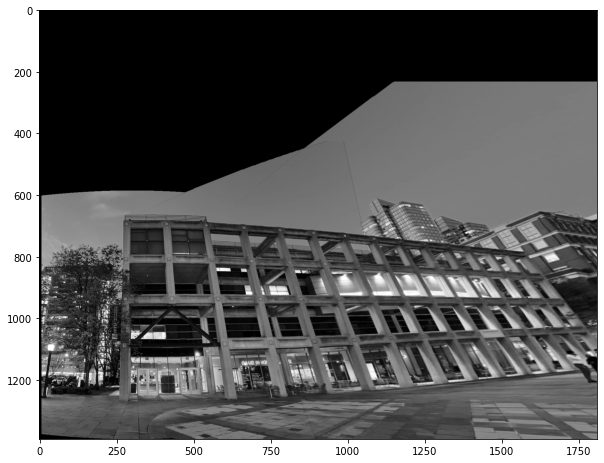

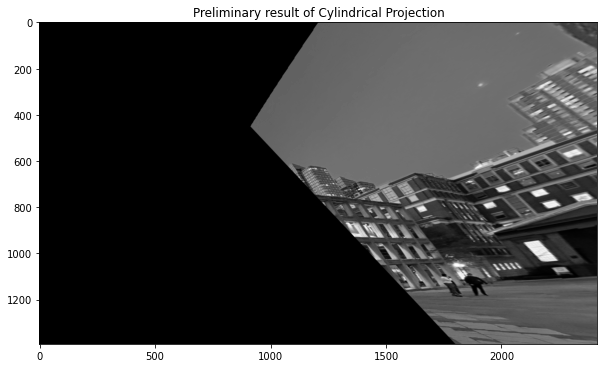

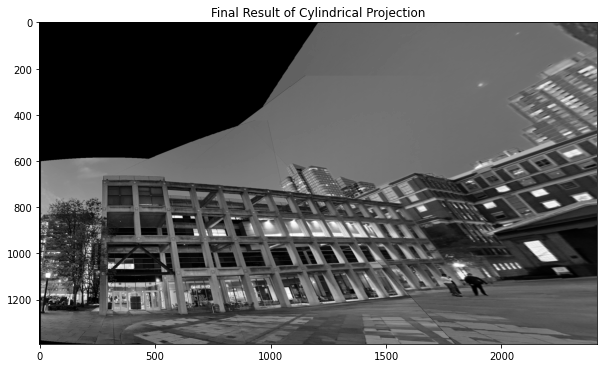

In [ ]:
i1234 = stitch(i123,i4)

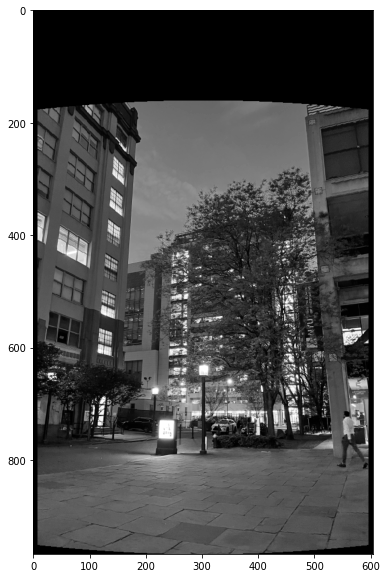

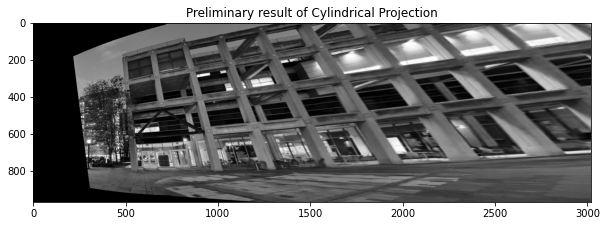

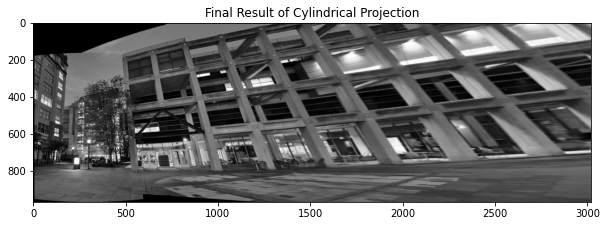

In [ ]:
i111234 = stitch(i11,i1234)

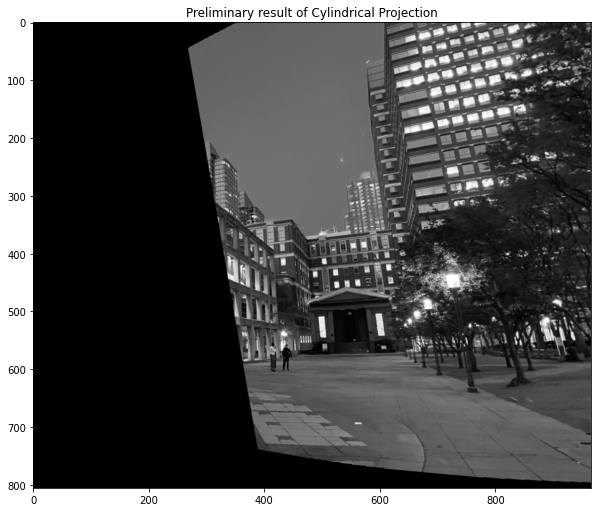

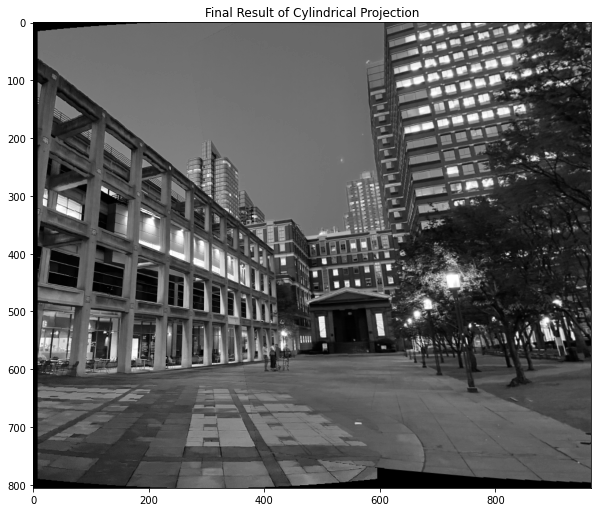

In [ ]:
i34 = stitch(i3,i4)

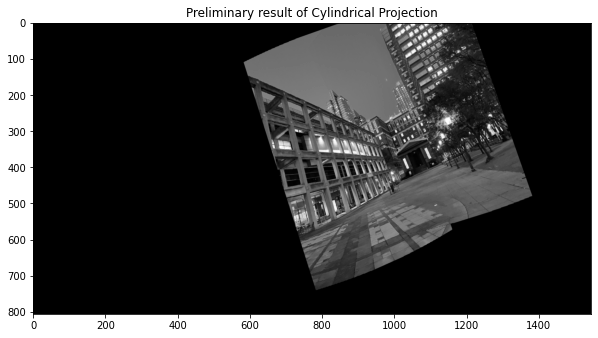

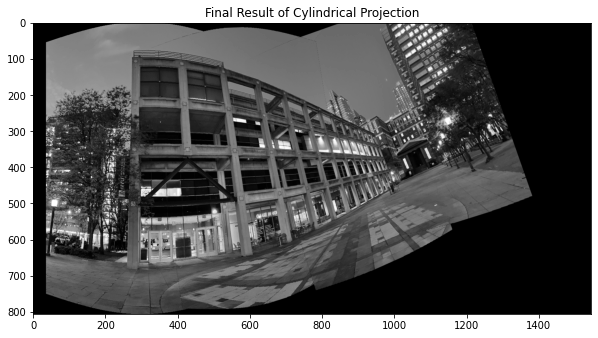

In [ ]:
i1234_2 = stitch(i12,i34)

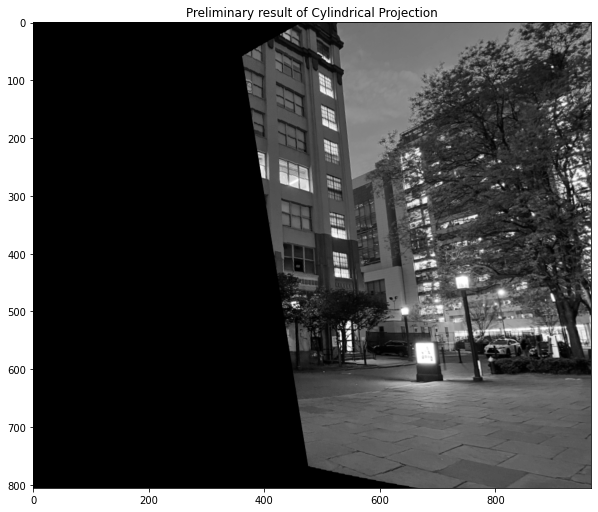

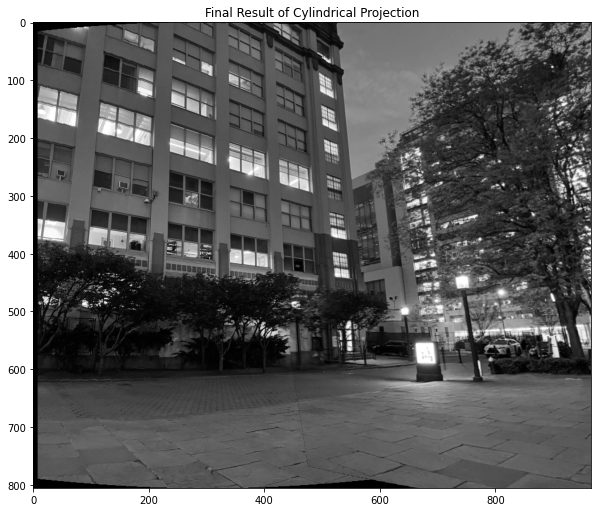

In [ ]:
i1011 = stitch(i10,i11)

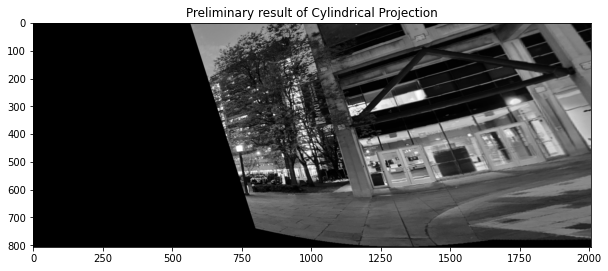

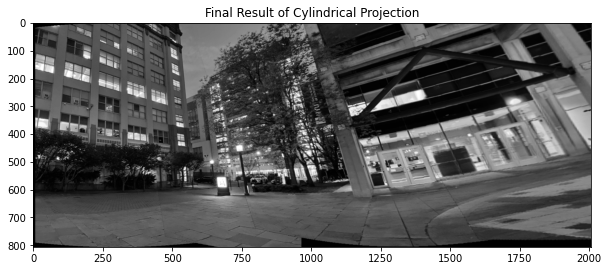

In [ ]:
i10111234 = stitch(i1011, i1234_2)

## f=700

Text(0.5, 1.0, 'I6')

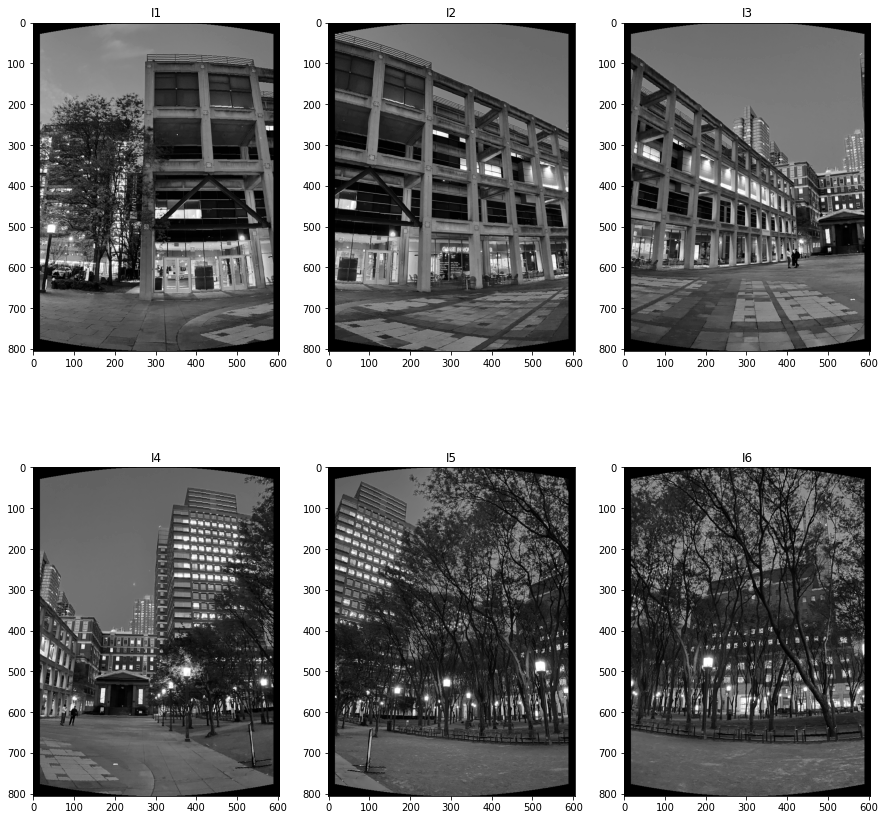

In [ ]:
# apply cylindrical projection
f = 700
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)
i8 = cylindrical_projection(i08, f)
i9 = cylindrical_projection(i09, f)
i10 = cylindrical_projection(i010, f)
i11 = cylindrical_projection(i011, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

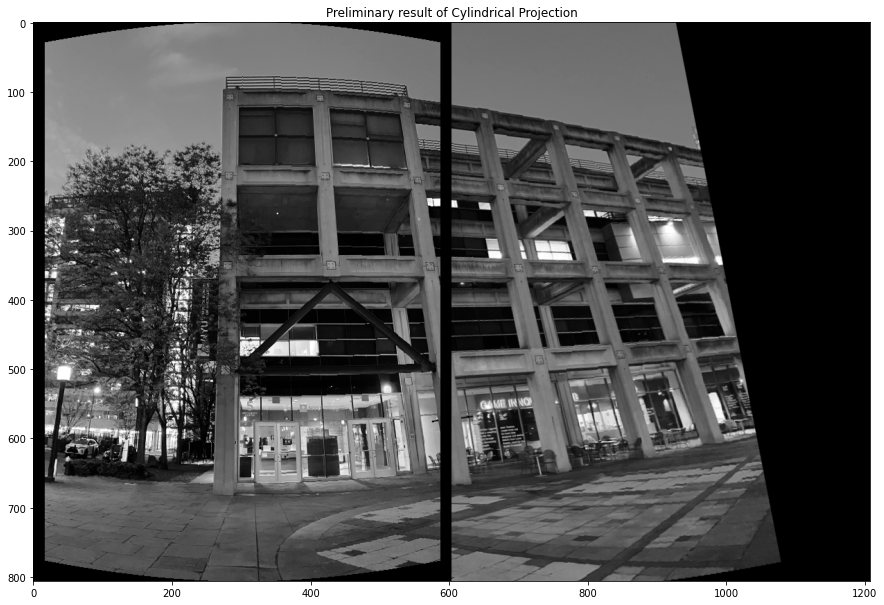

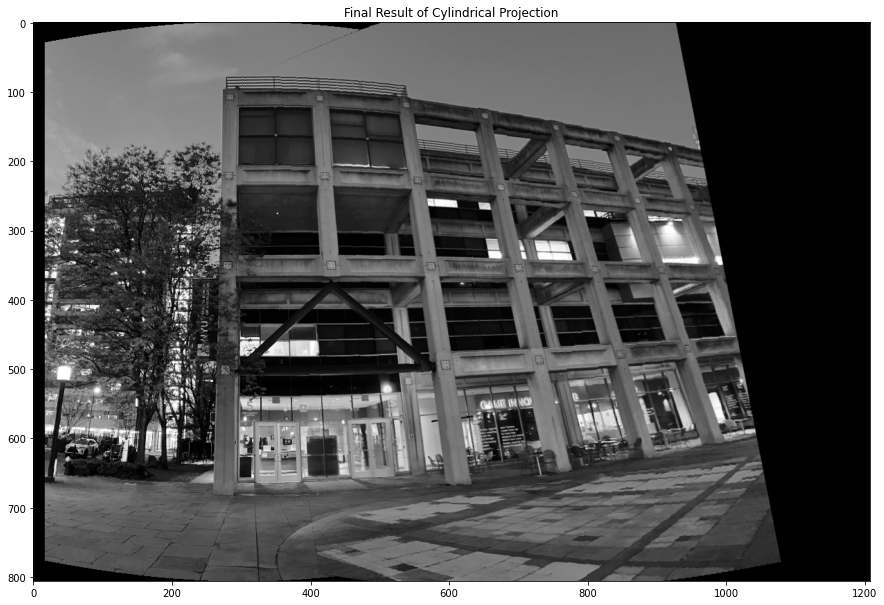

In [ ]:
i12 = stitch(i1,i2)

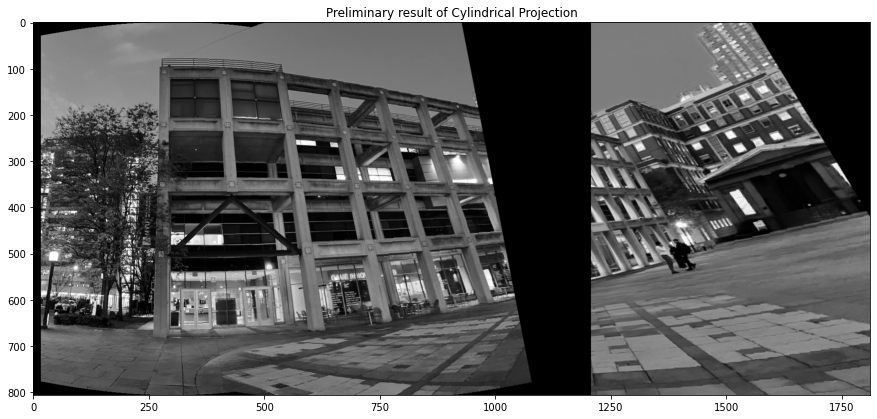

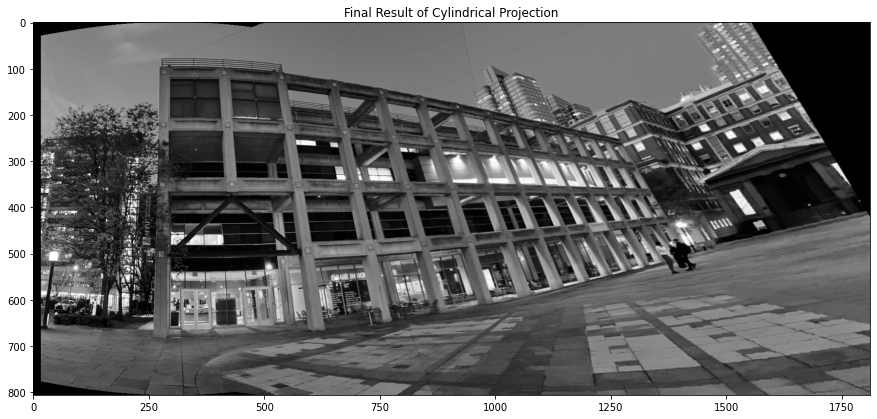

In [ ]:
i123 = stitch(i12,i3)

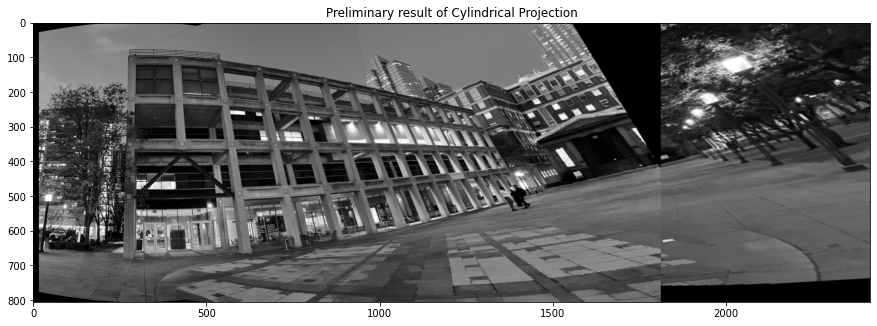

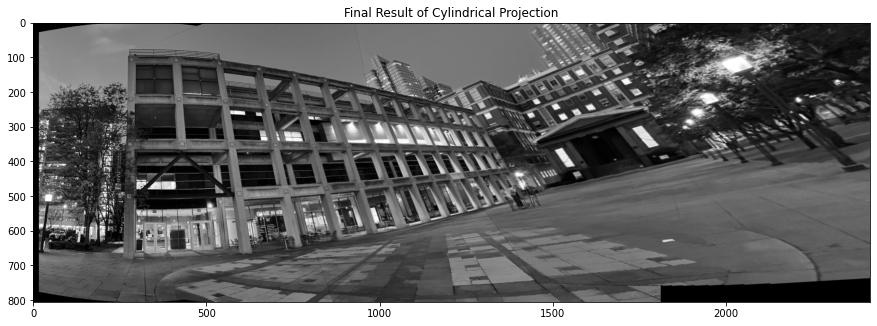

In [ ]:
i1234 = stitch(i123,i4)

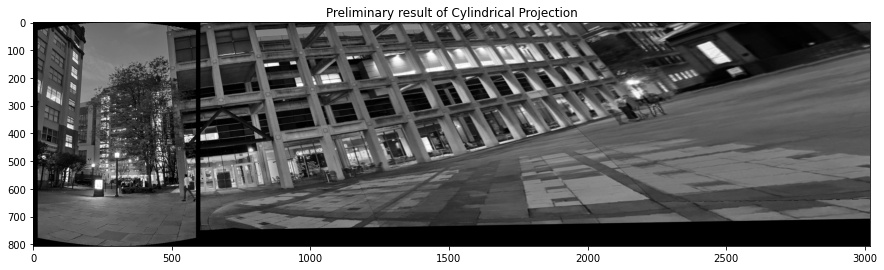

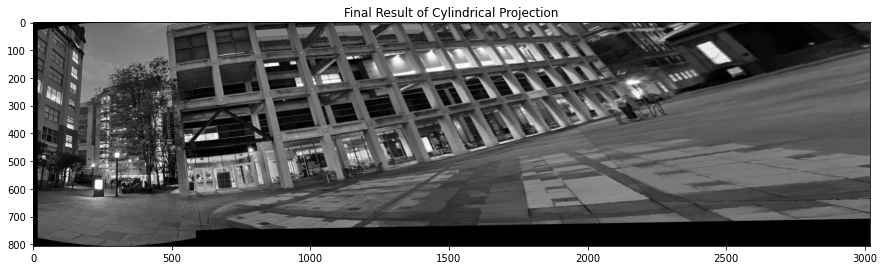

In [ ]:
i111234 = stitch(i11,i1234)

## f = 400

Text(0.5, 1.0, 'I6')

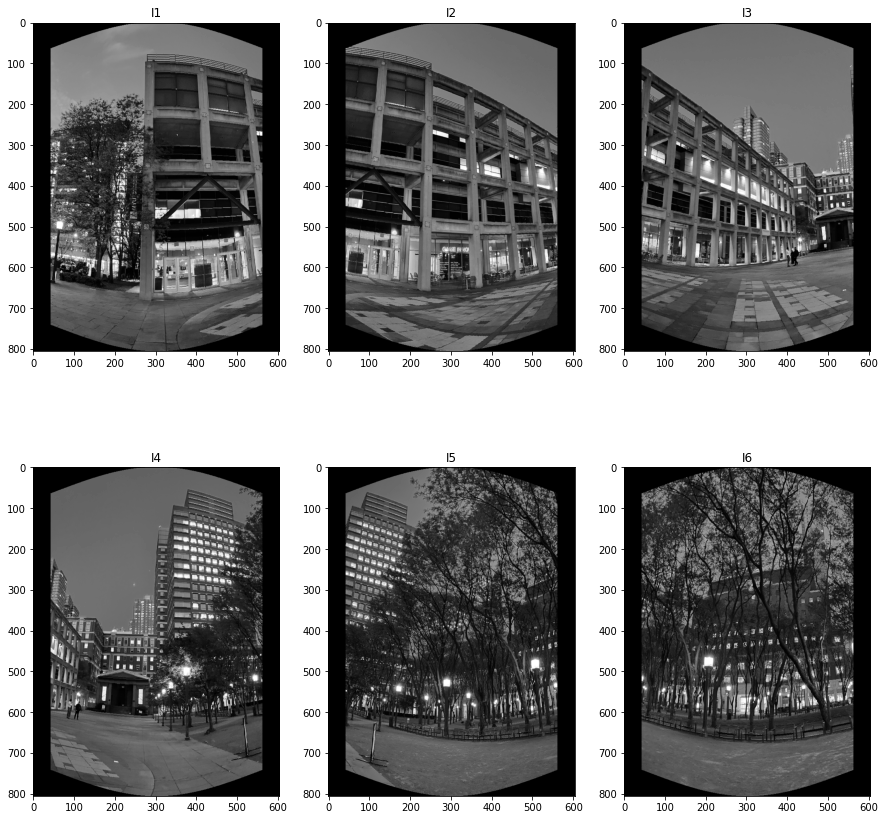

In [ ]:
# apply cylindrical projection
f = 400
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)
i8 = cylindrical_projection(i08, f)
i9 = cylindrical_projection(i09, f)
i10 = cylindrical_projection(i010, f)
i11 = cylindrical_projection(i011, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

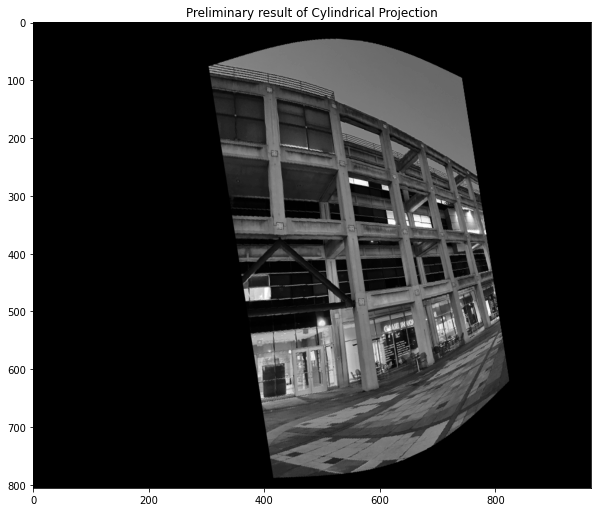

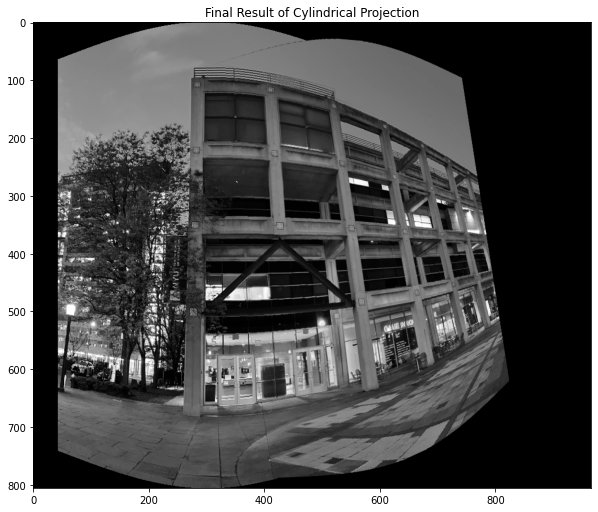

In [ ]:
i12 = stitch(i1,i2)

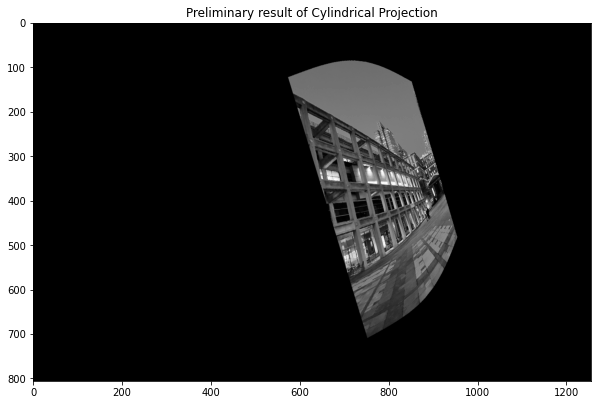

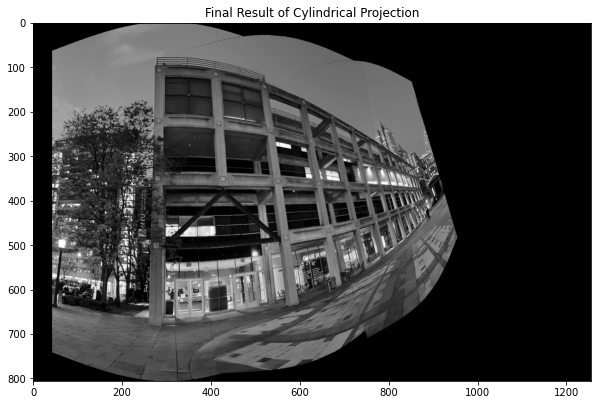

In [ ]:
i123 = stitch(i12,i3)

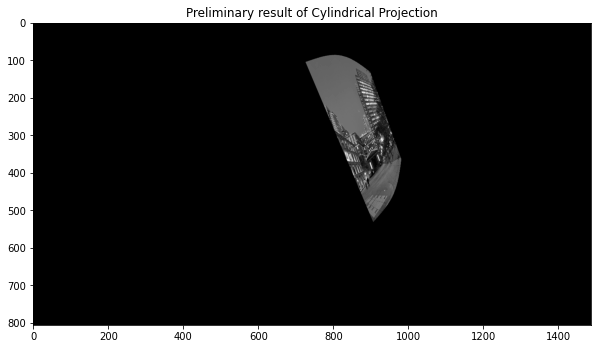

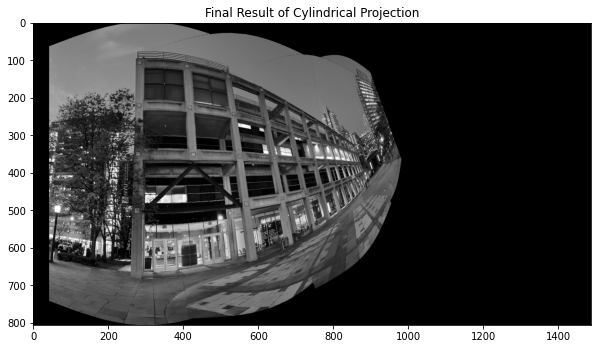

In [ ]:
i1234 = stitch(i123,i4)

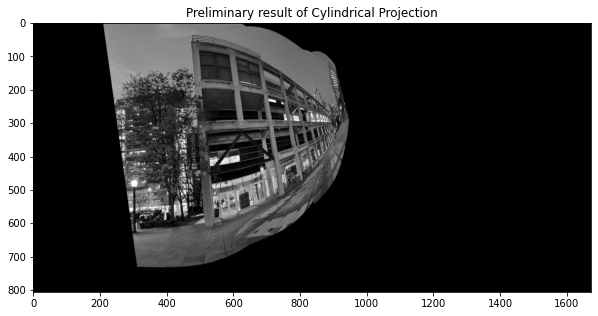

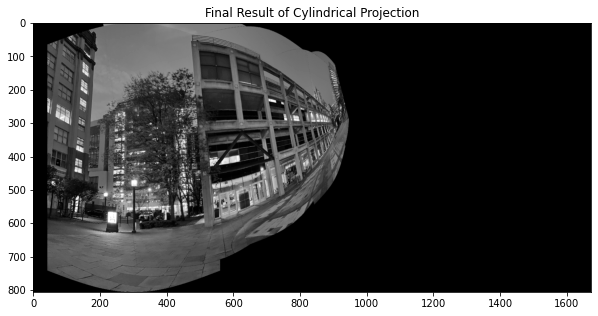

In [ ]:
i111234 = stitch(i11,i1234)

## f = 450

Text(0.5, 1.0, 'I6')

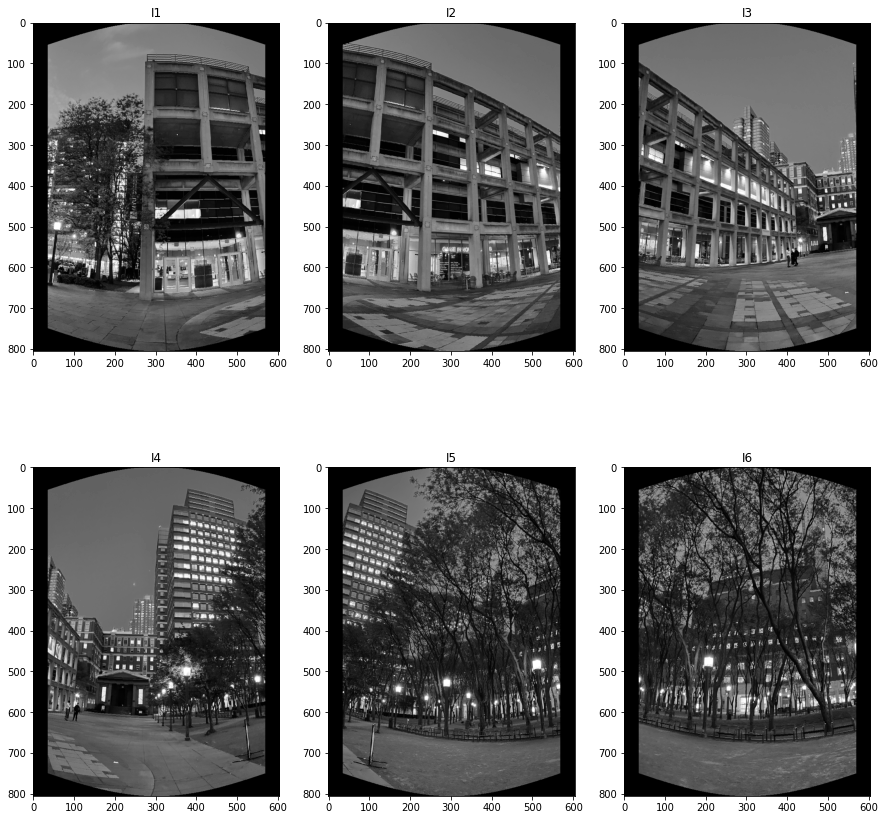

In [ ]:
# apply cylindrical projection
f = 450
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)
i8 = cylindrical_projection(i08, f)
i9 = cylindrical_projection(i09, f)
i10 = cylindrical_projection(i010, f)
i11 = cylindrical_projection(i011, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

Text(0.5, 1.0, 'I11')

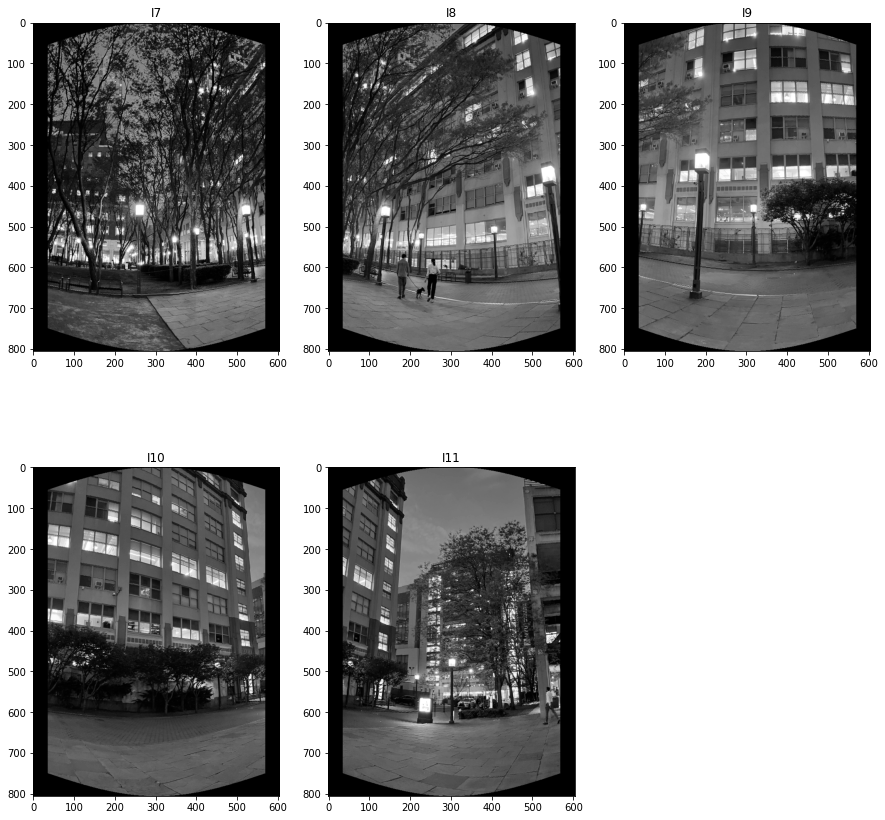

In [ ]:
plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i7, 'gray')
plt.title('I7')
plt.subplot(232)
plt.imshow(i8, 'gray')
plt.title('I8')
plt.subplot(233)
plt.imshow(i9, 'gray')
plt.title('I9')
plt.subplot(234)
plt.imshow(i10, 'gray')
plt.title('I10')
plt.subplot(235)
plt.imshow(i11, 'gray')
plt.title('I11')

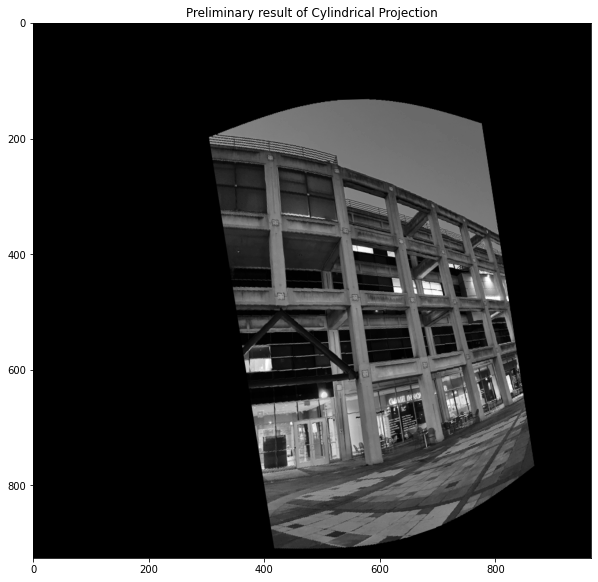

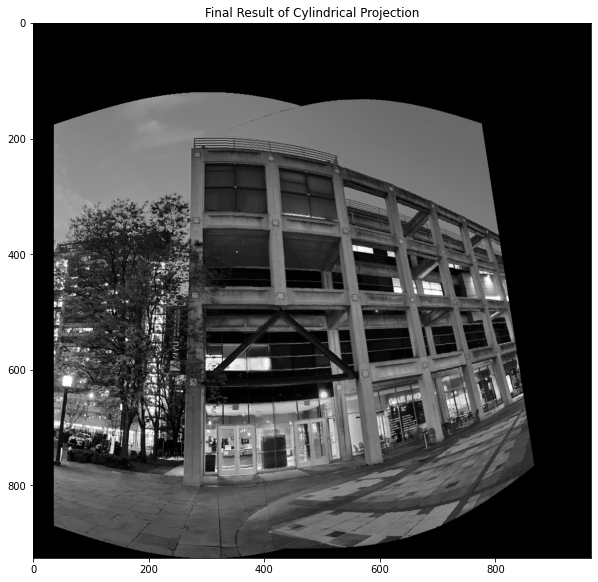

In [ ]:
i1_2 = stitch(i1,i2)

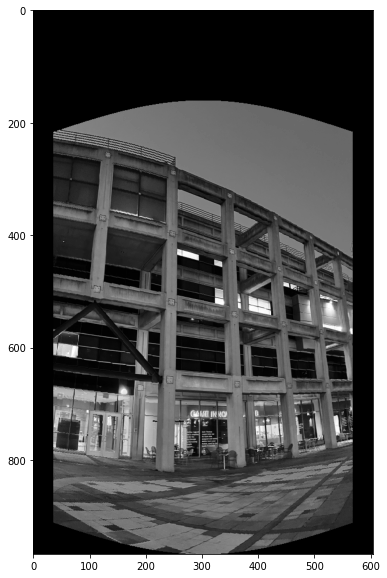

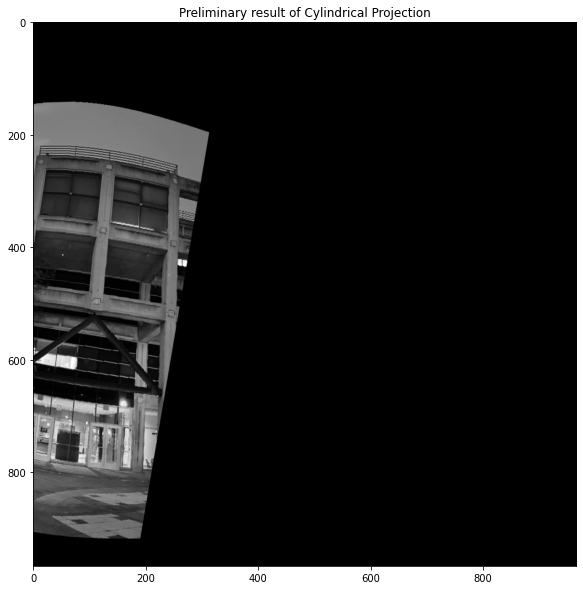

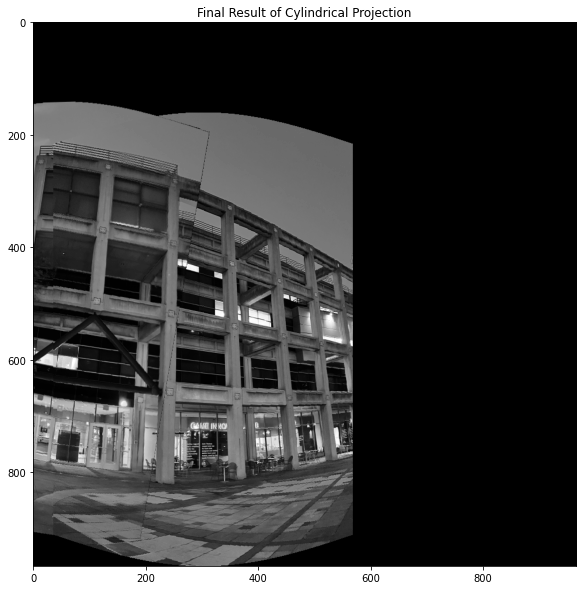

In [ ]:
i21 = stitch(i2,i1)

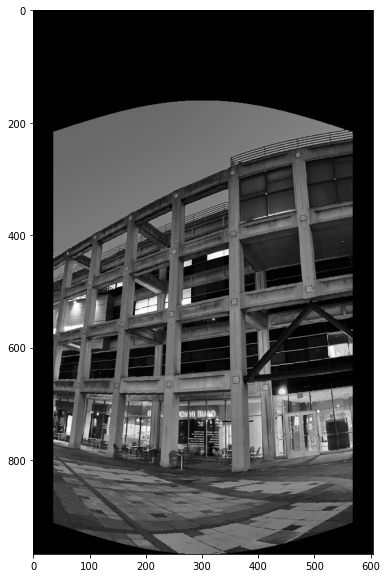

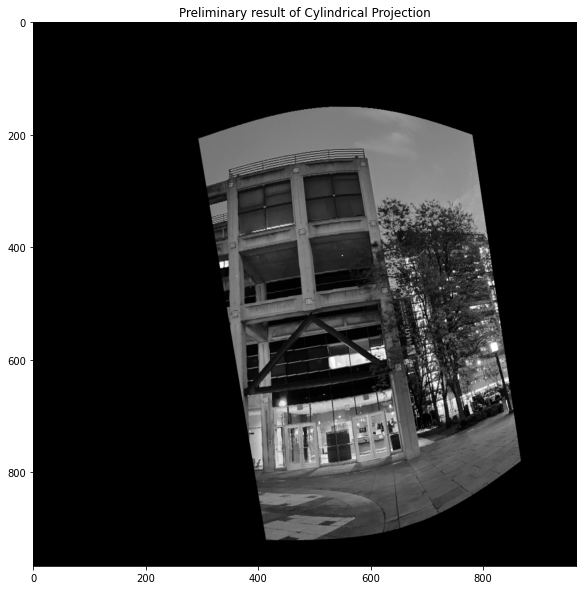

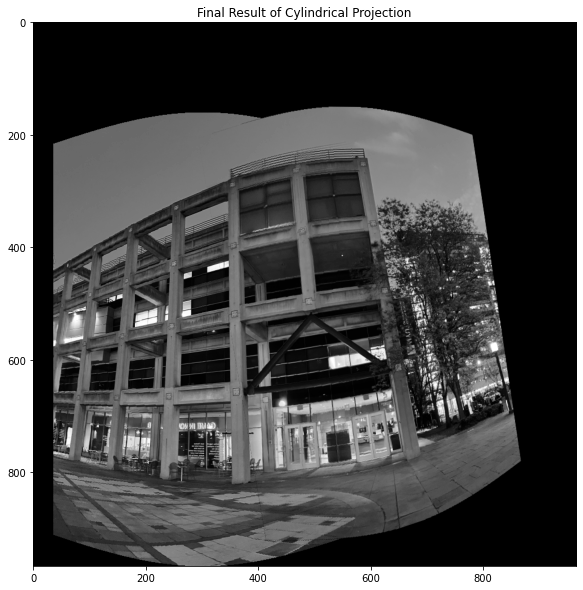

In [ ]:
i1_flip = np.flip(i1, 1)
i2_flip = np.flip(i2, 1)
i21 = stitch(i2_flip, i1_flip)

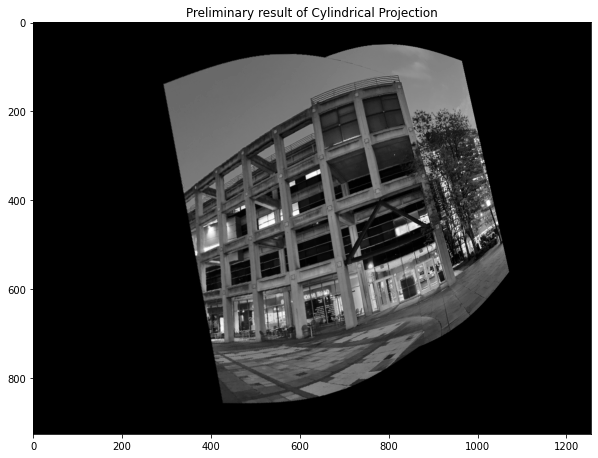

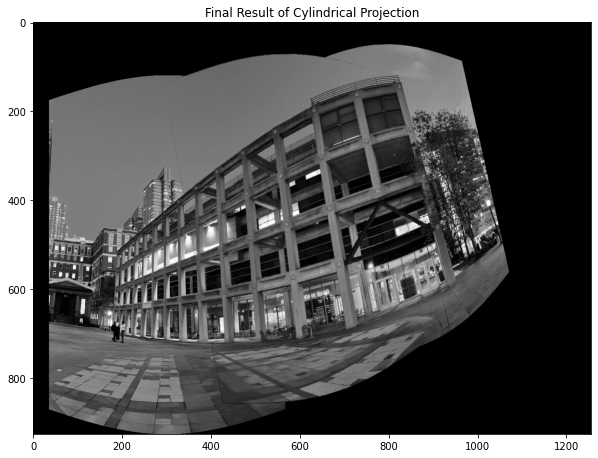

In [ ]:
i1_3_flip = stitch(np.flip(i3, 1), np.flip(i1_2, 1))

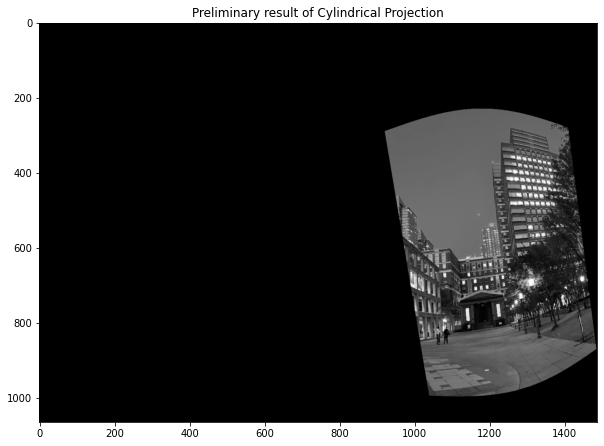

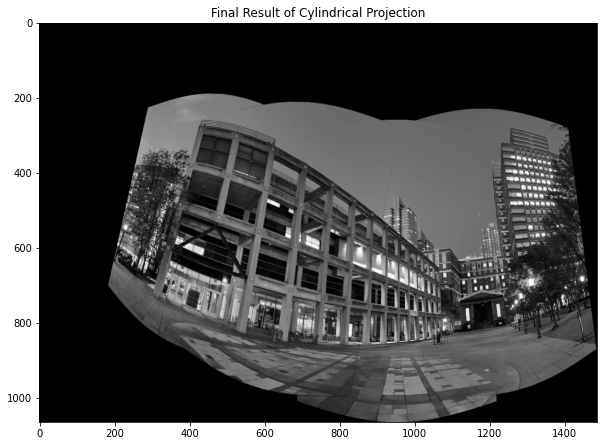

In [ ]:
i1_4 = stitch(np.flip(i1_3_flip, 1),i4)

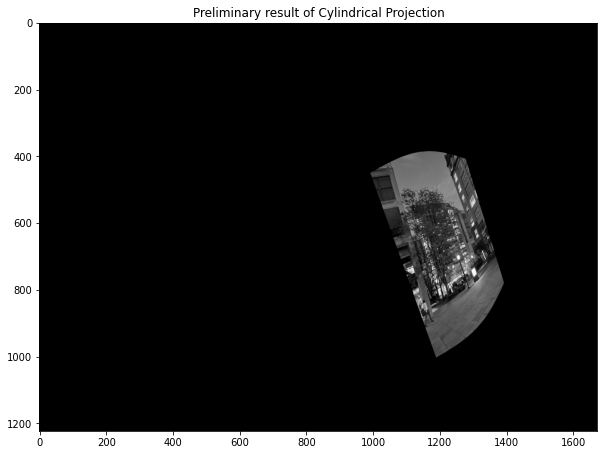

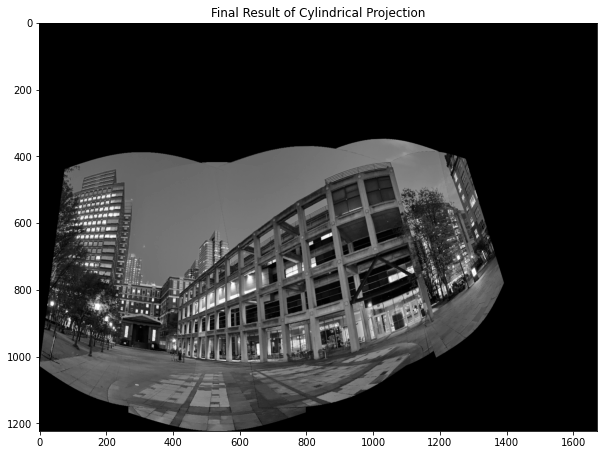

In [ ]:
i11_4_flip = stitch(np.flip(i1_4, 1),np.flip(i11, 1))

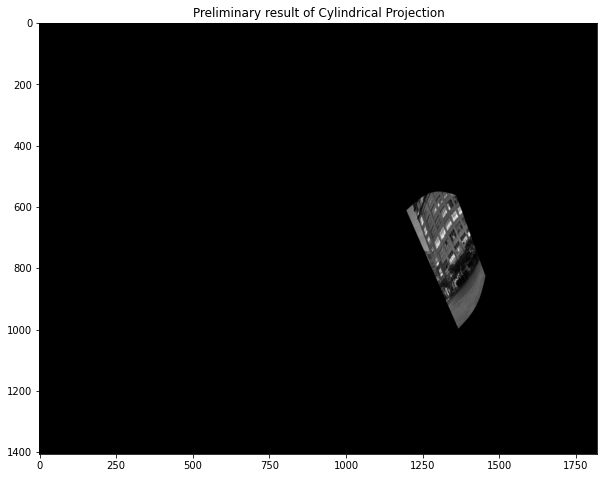

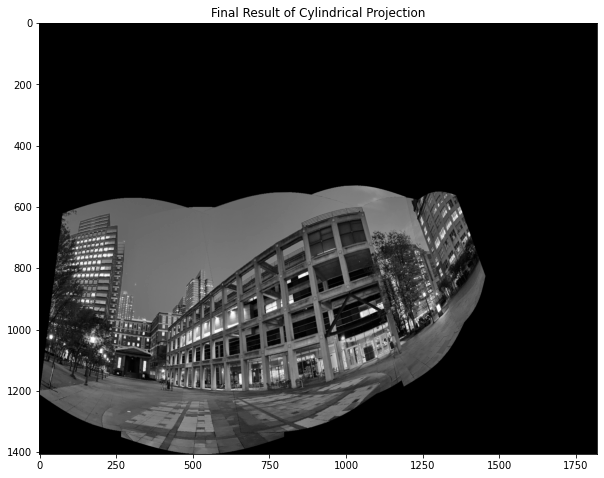

In [ ]:
i10_4_flip = stitch(i11_4_flip, np.flip(i10, 1))

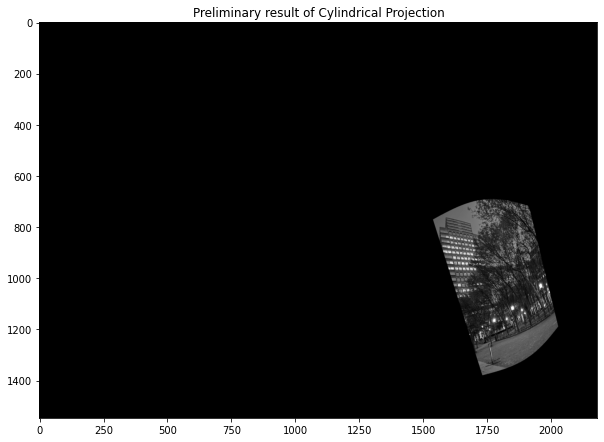

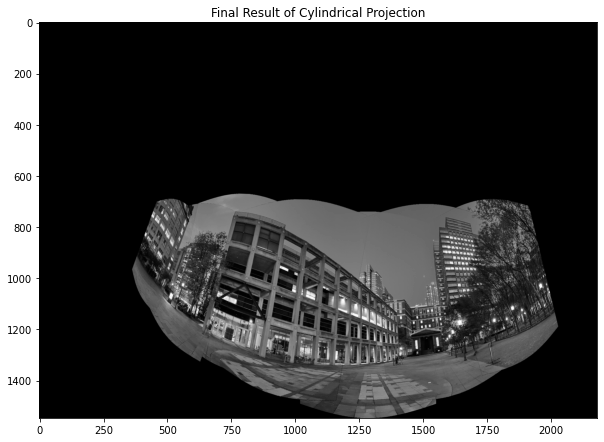

In [ ]:
i10_5 = stitch(np.flip(i10_4_flip, 1), i5)

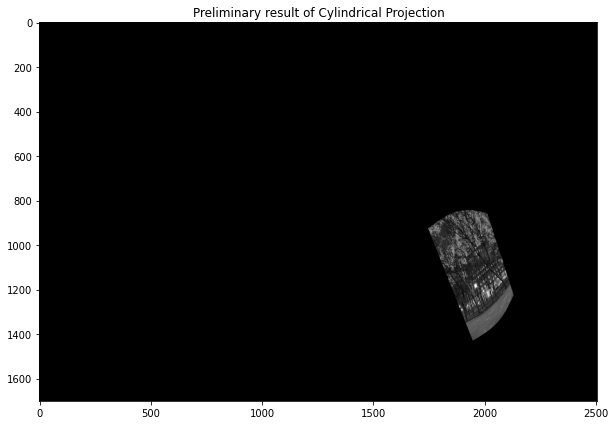

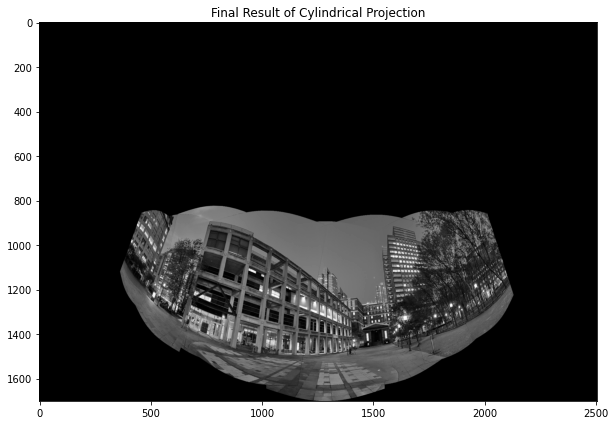

In [ ]:
i10_6 = stitch(i10_5, i6)

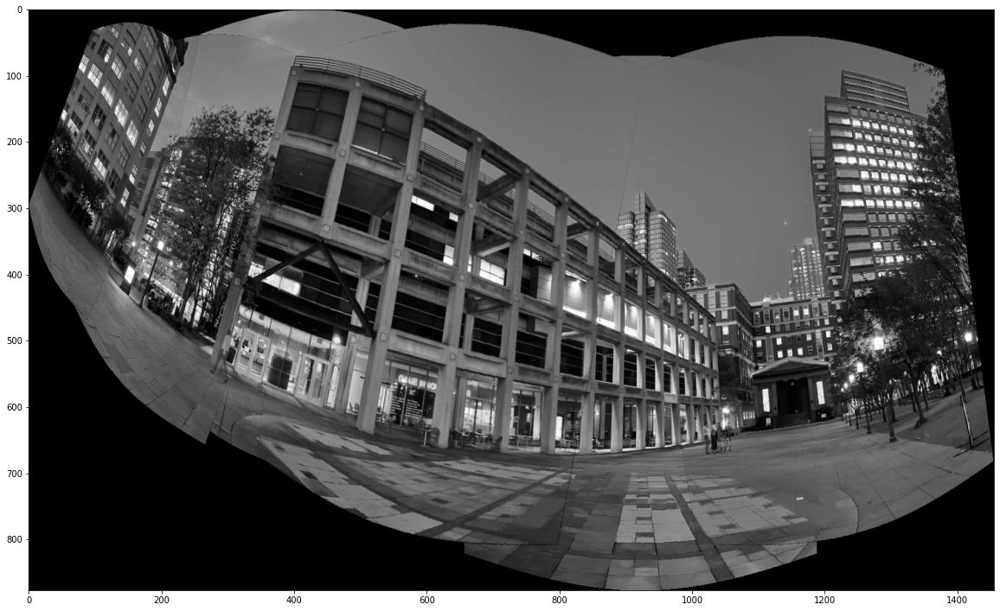

In [ ]:
i10_4_final = edge_delete(np.flip(i10_4_flip, 1))

In [ ]:
cv2.imwrite('i10_4_f450.jpg', i10_4_final)

True

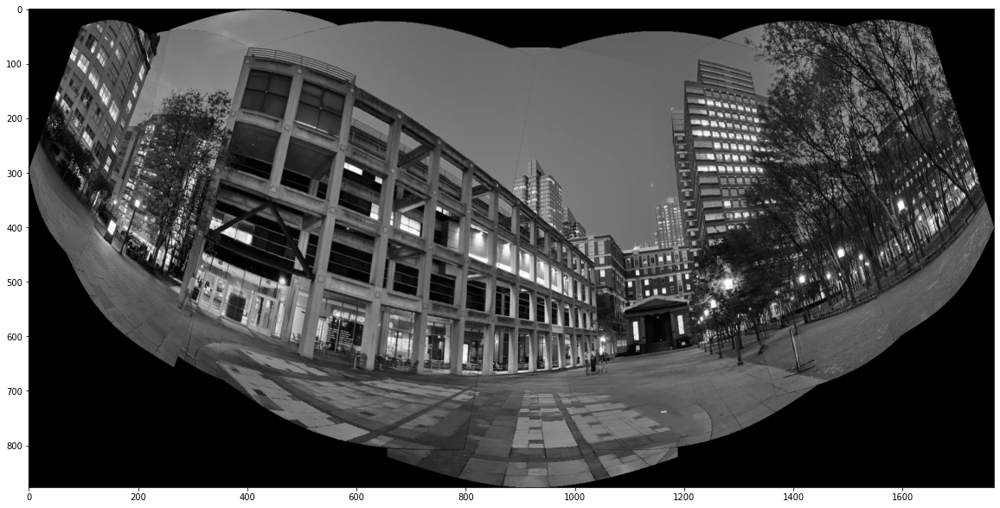

In [ ]:
i10_6_final = edge_delete(i10_6)

In [ ]:
cv2.imwrite('i10_6_f450.jpg', i10_6_final)

True

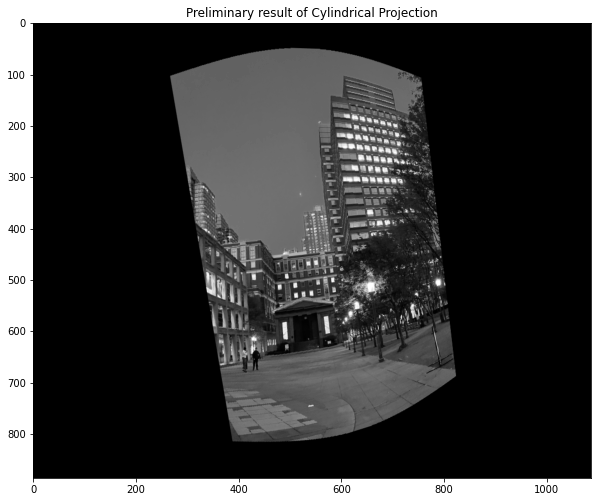

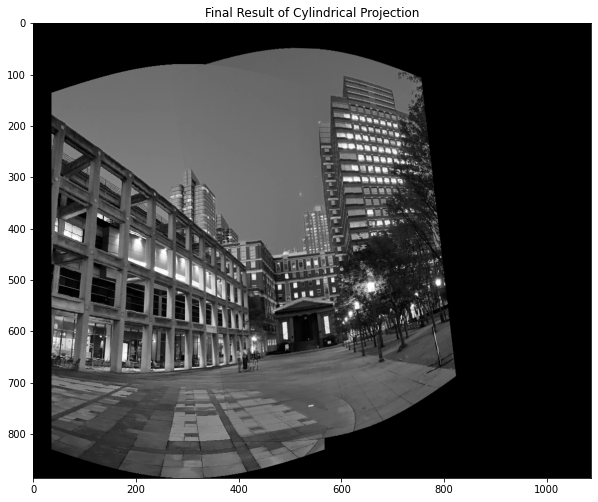

In [ ]:
i3_4 = stitch(i3,i4)

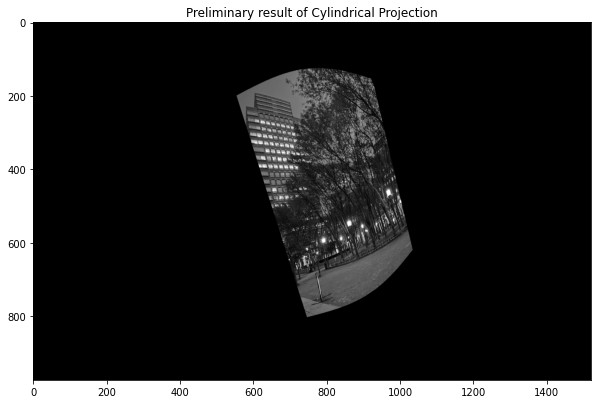

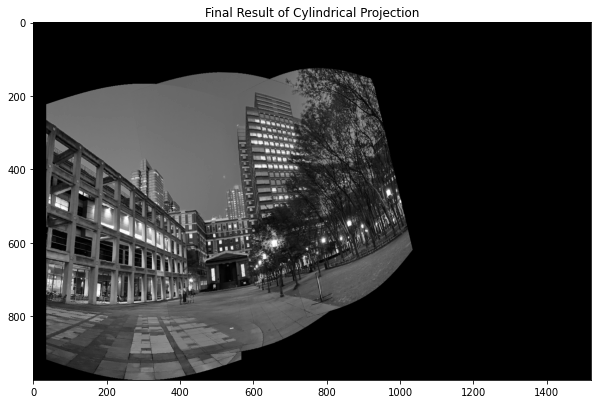

In [ ]:
i3_5 = stitch(i3_4,i5)

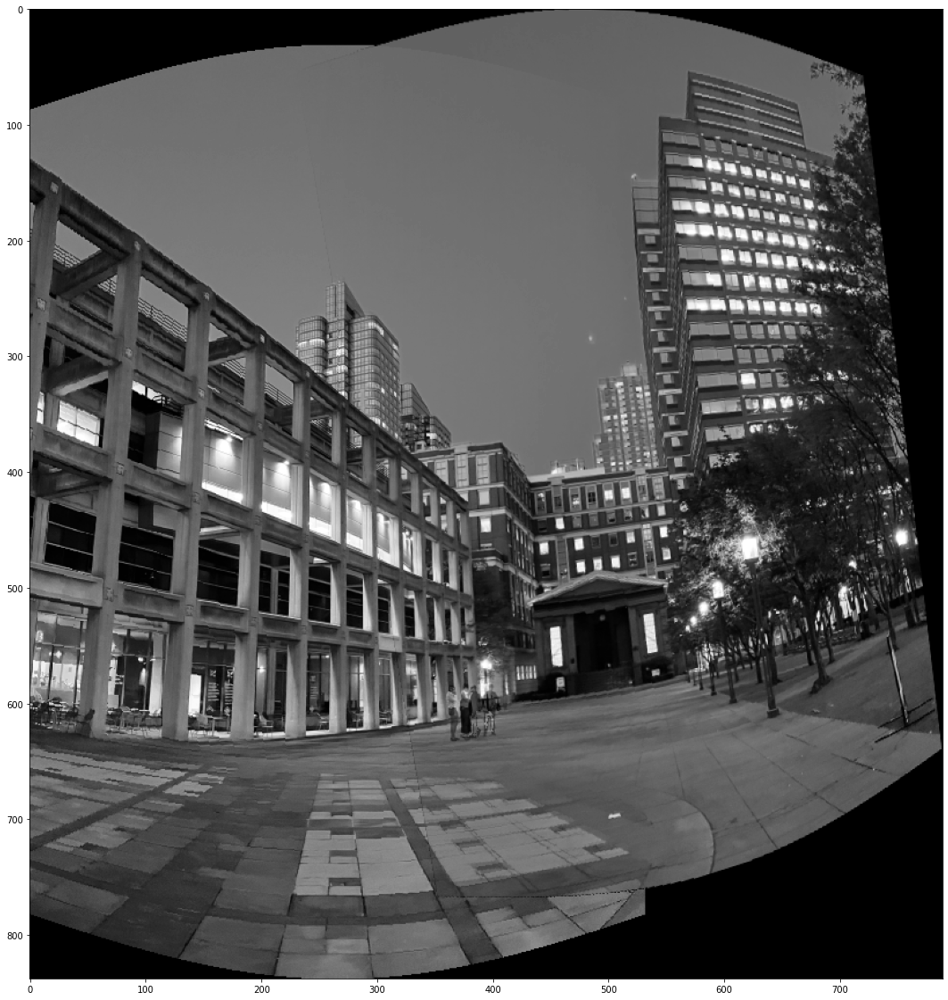

In [ ]:
i3_4_final = edge_delete(i3_4)

In [ ]:
cv2.imwrite('i3_4_Cylindrical.jpg', i3_4_final)

True

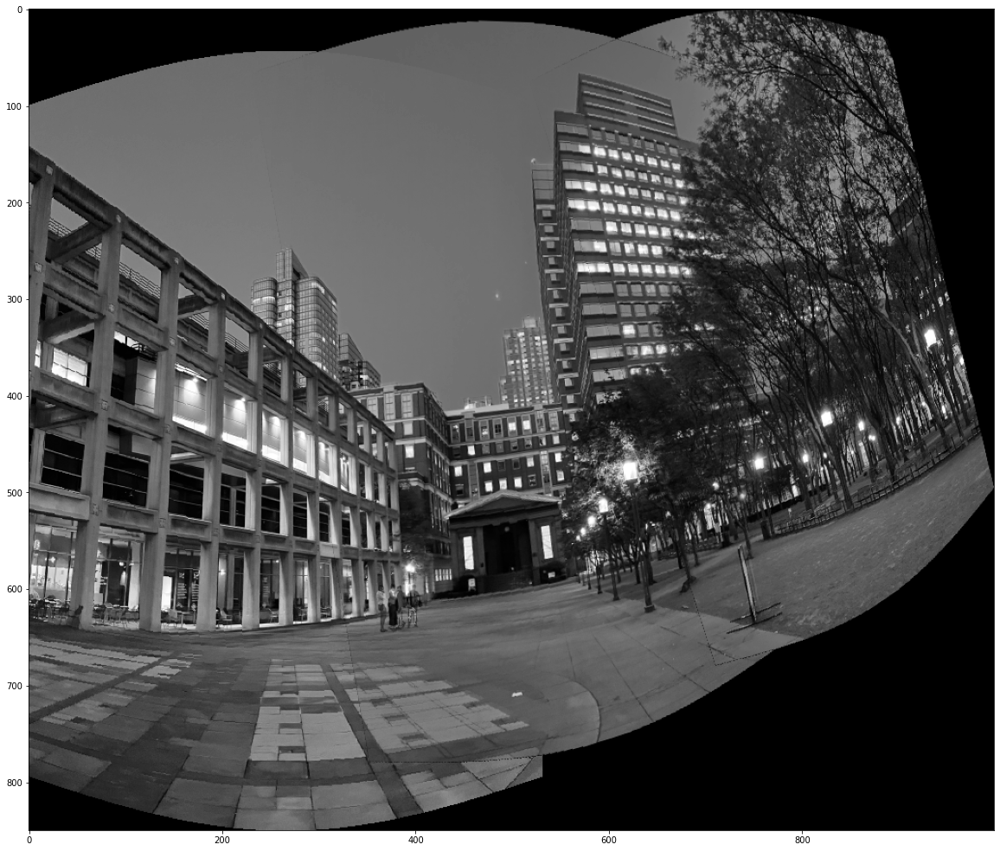

In [ ]:
i3_5_final = edge_delete(i3_5)

In [ ]:
cv2.imwrite('i3_5_Cylindrical.jpg', i3_5_final)

True

## f = 500

Text(0.5, 1.0, 'I6')

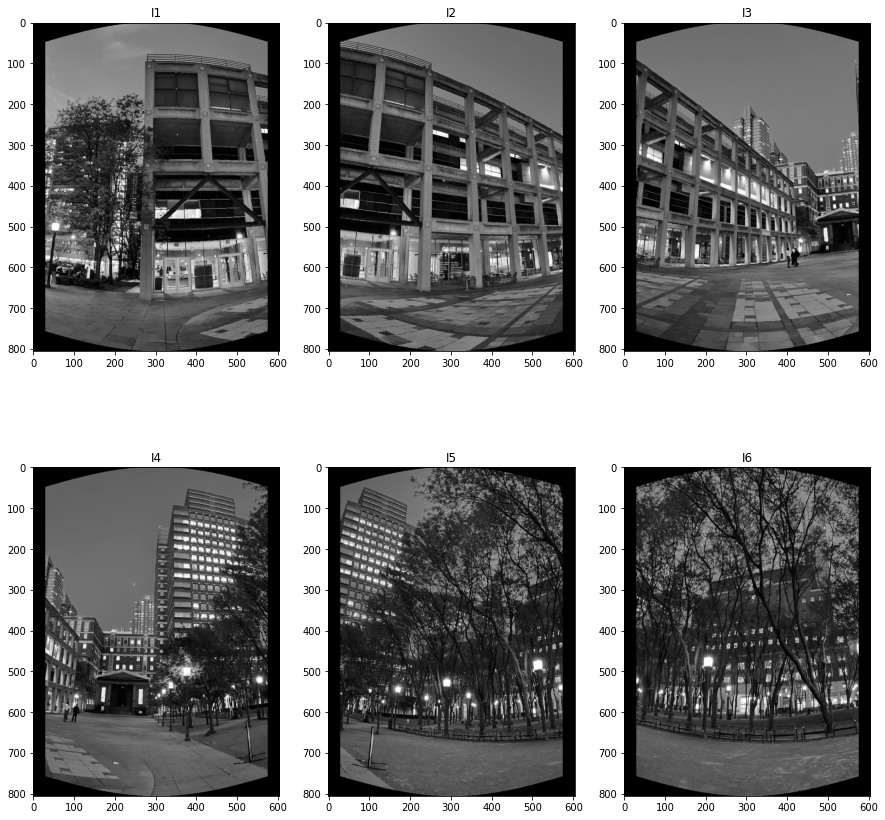

In [ ]:
# apply cylindrical projection
f = 500
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)
i8 = cylindrical_projection(i08, f)
i9 = cylindrical_projection(i09, f)
i10 = cylindrical_projection(i010, f)
i11 = cylindrical_projection(i011, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

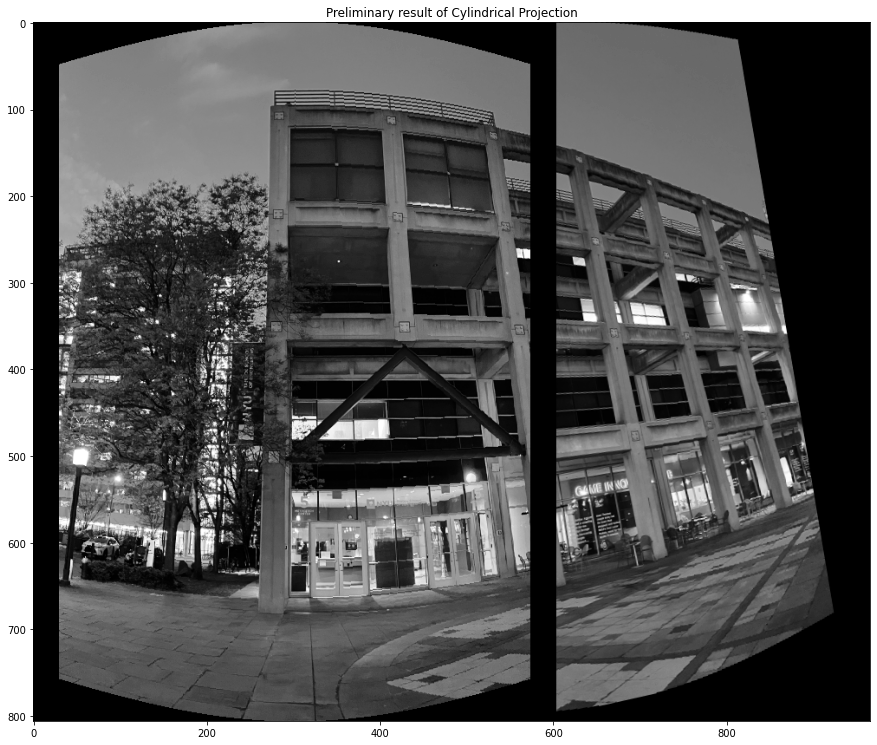

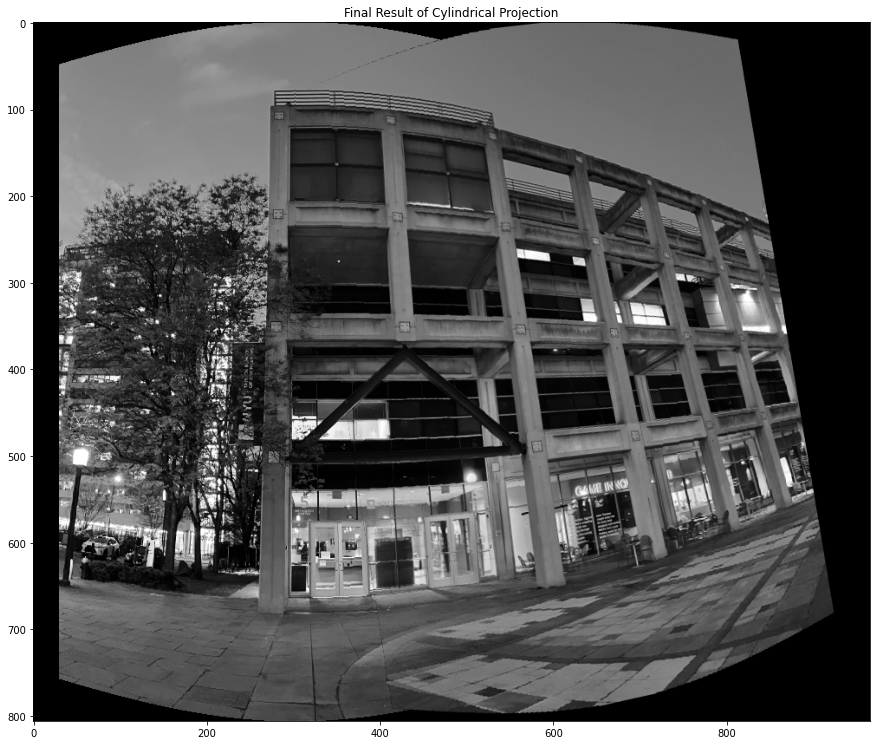

In [ ]:
i12 = stitch(i1,i2)

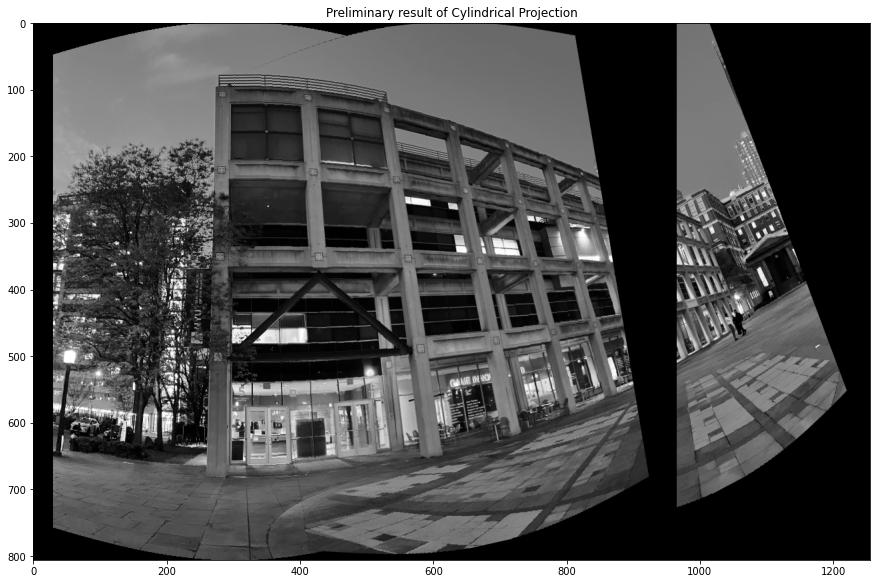

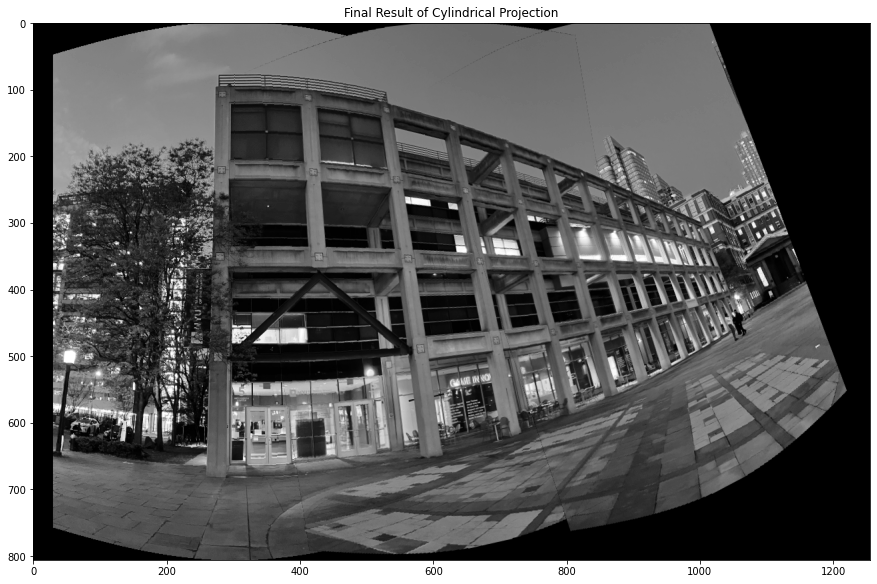

In [ ]:
i123 = stitch(i12,i3)

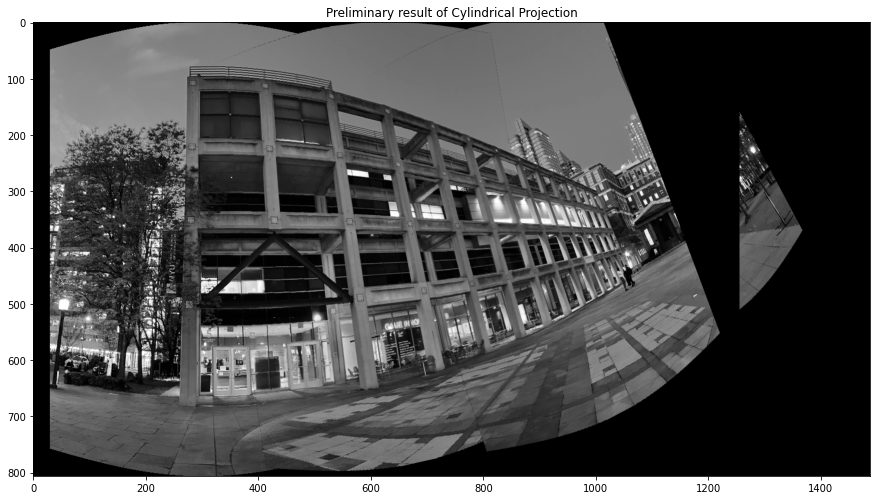

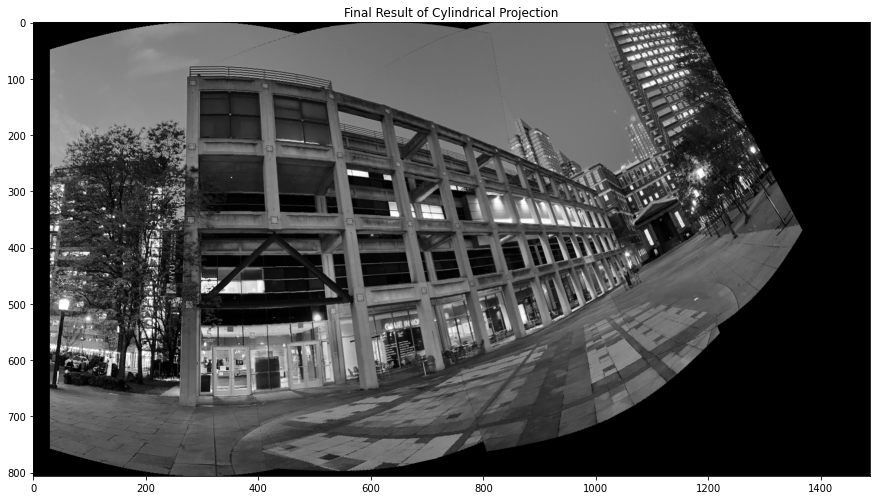

In [ ]:
i1234 = stitch(i123,i4)

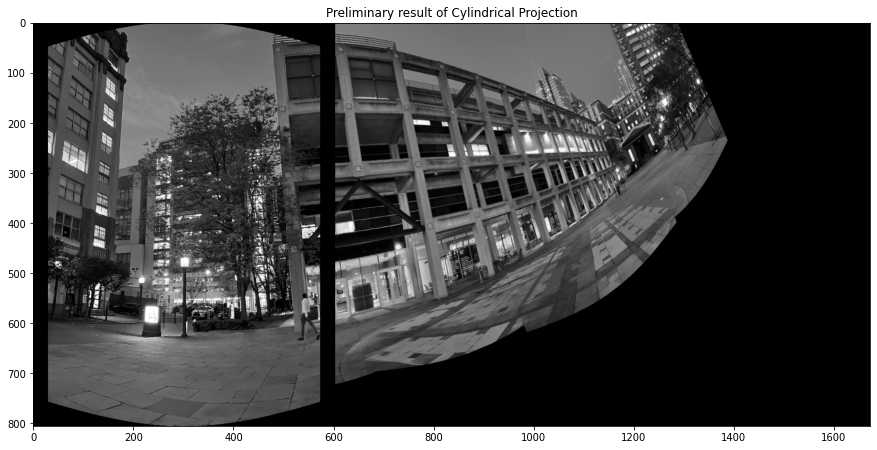

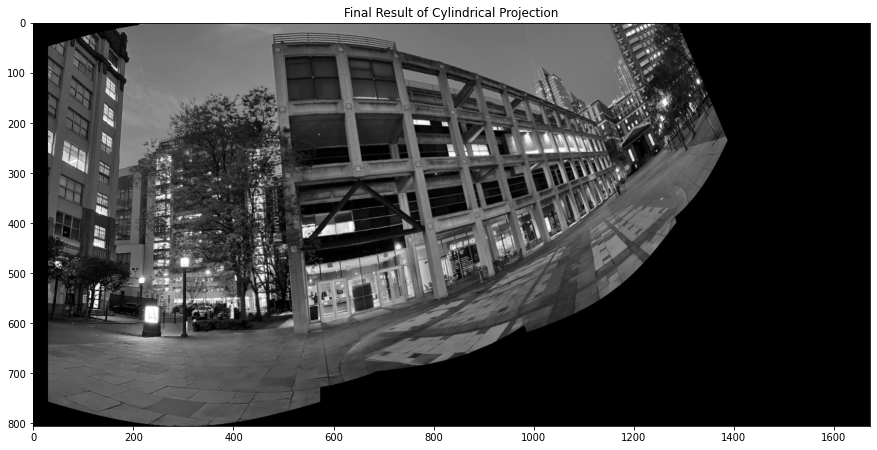

In [ ]:
i111234 = stitch(i11,i1234)

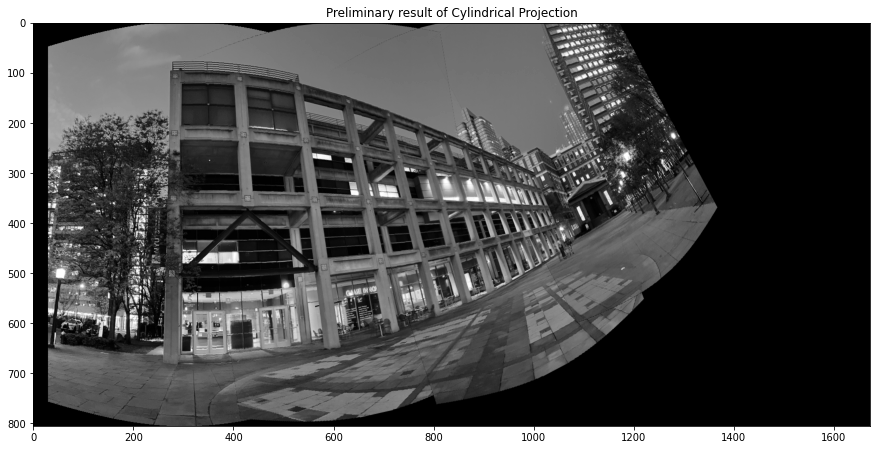

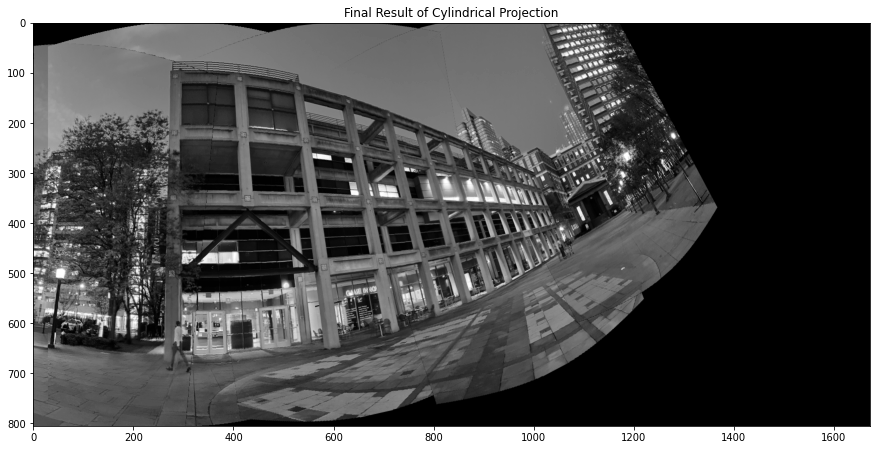

In [ ]:
i123411 = stitch(i1234,i11)

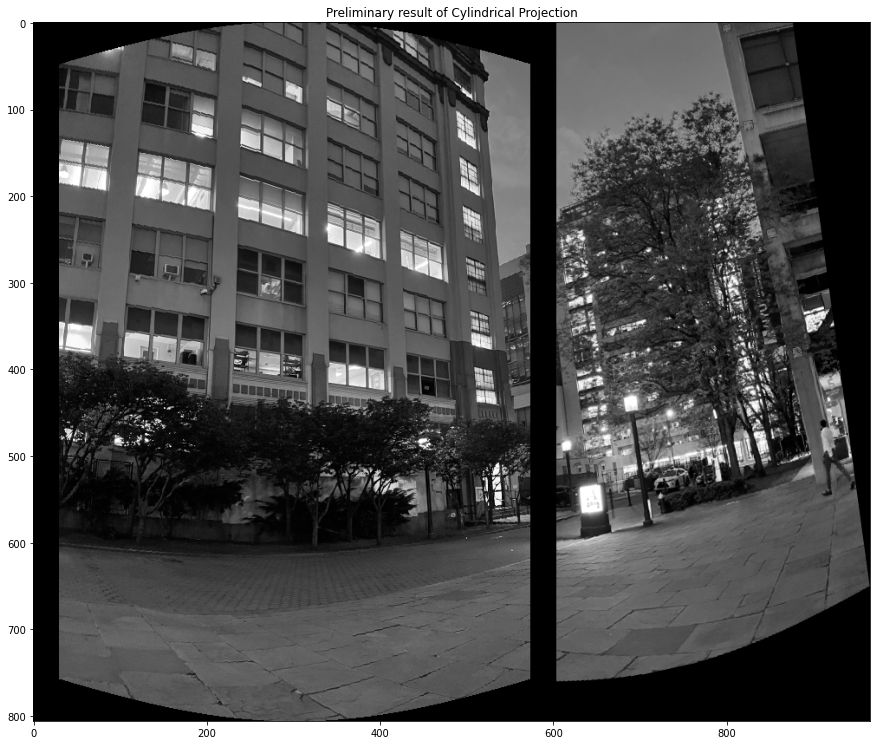

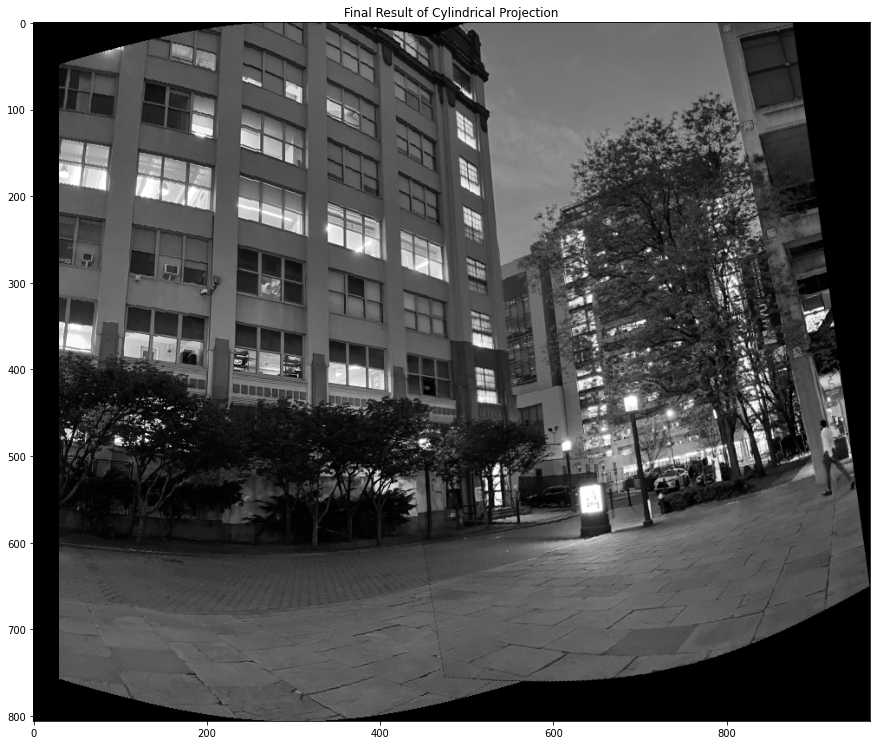

In [ ]:
i1011 = stitch(i10,i11)

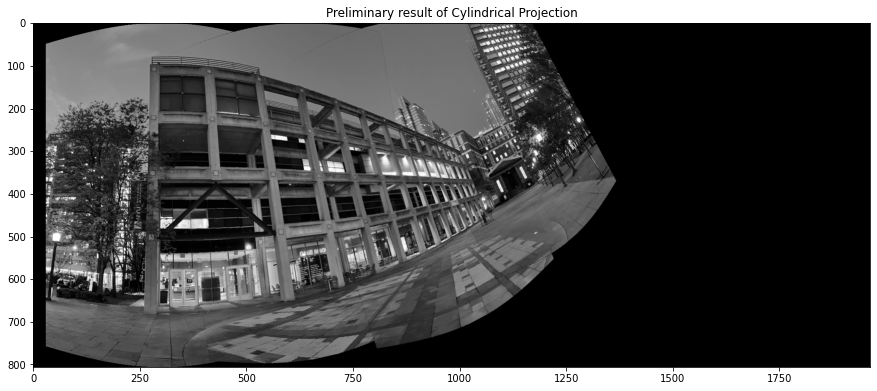

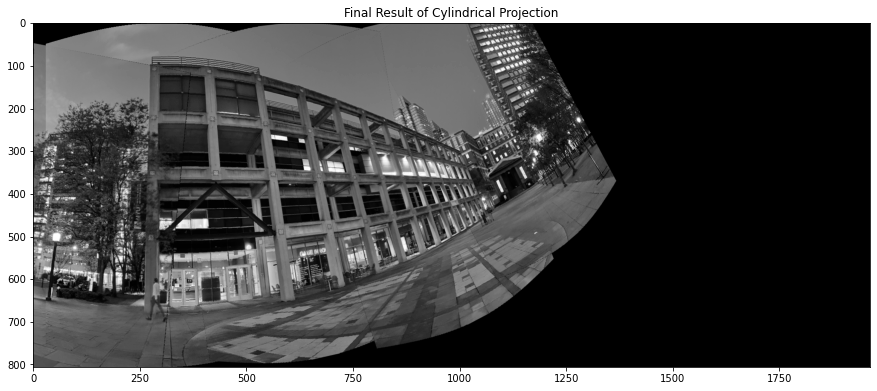

In [ ]:
i12341011 = stitch(i1234,i1011)

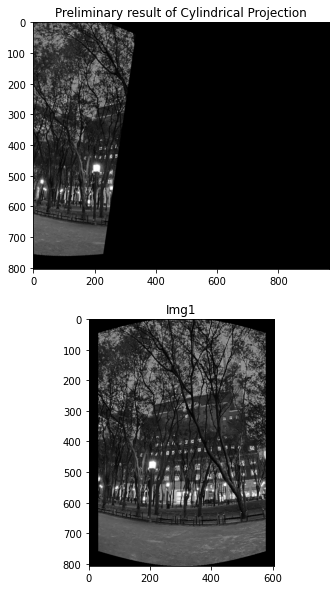

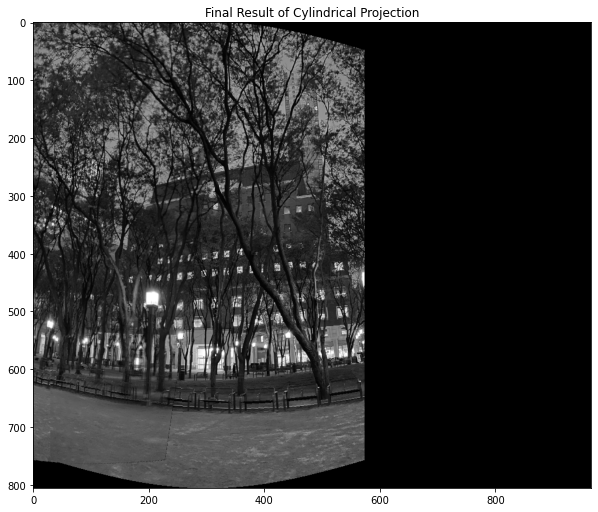

In [ ]:
i65 = stitch(i6,i5)

## f = 475

Text(0.5, 1.0, 'I6')

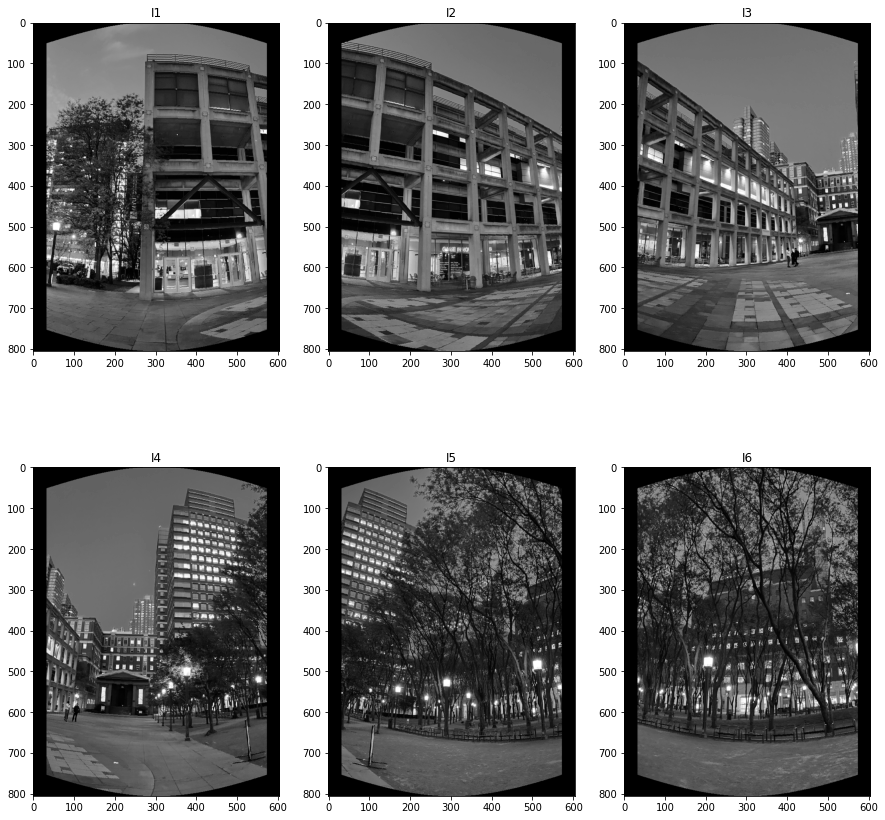

In [ ]:
# apply cylindrical projection
f = 475
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)
i8 = cylindrical_projection(i08, f)
i9 = cylindrical_projection(i09, f)
i10 = cylindrical_projection(i010, f)
i11 = cylindrical_projection(i011, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

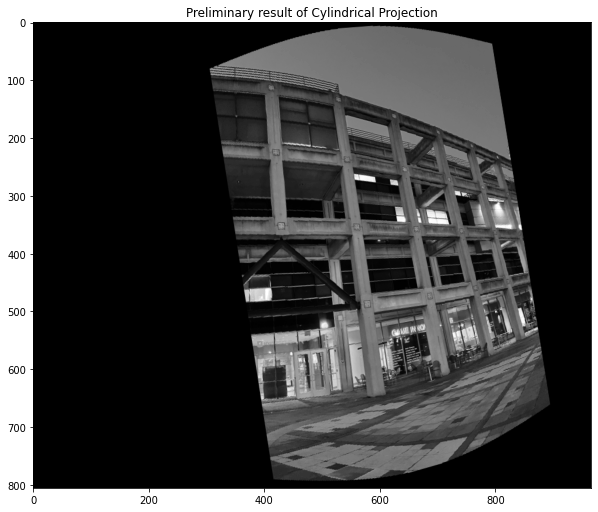

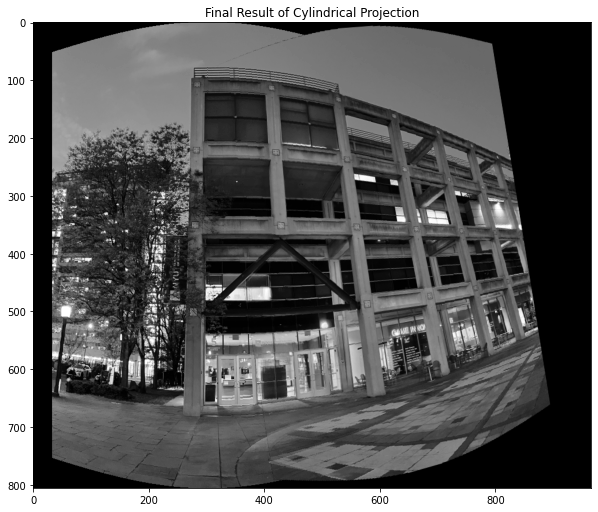

In [ ]:
i12 = stitch(i1,i2)

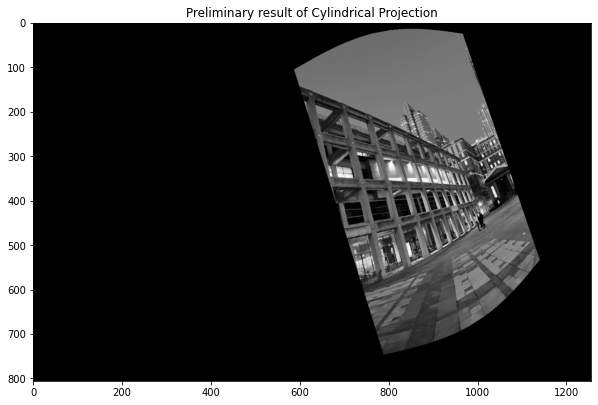

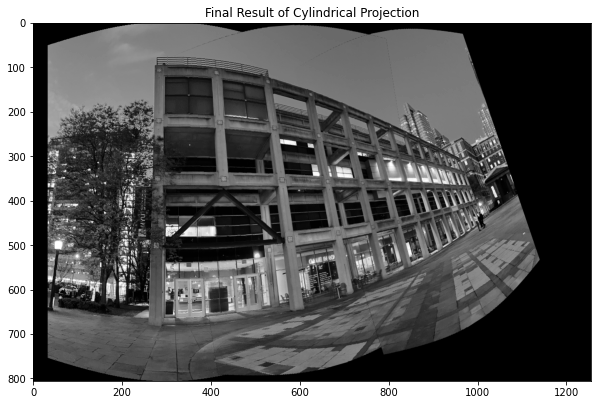

In [ ]:
i123 = stitch(i12,i3)

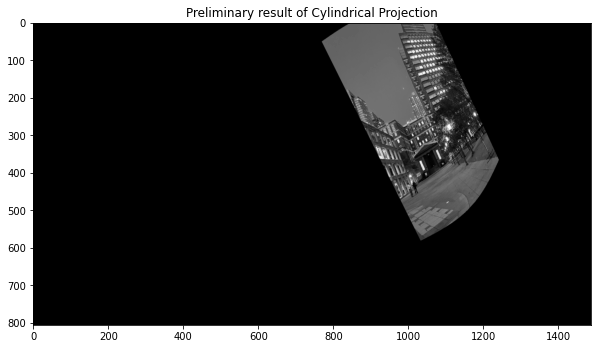

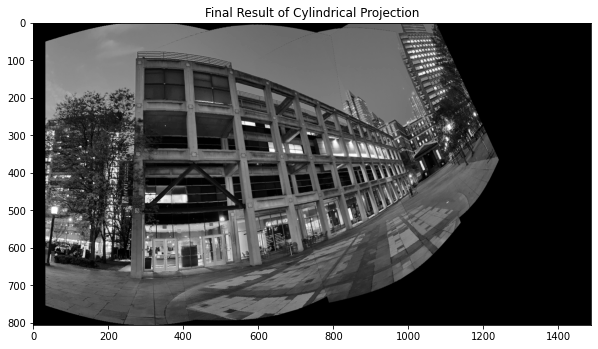

In [ ]:
i1234 = stitch(i123,i4)

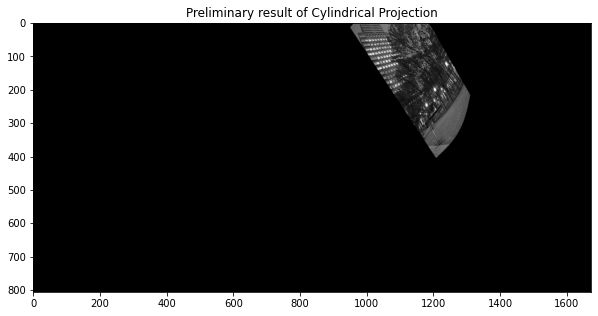

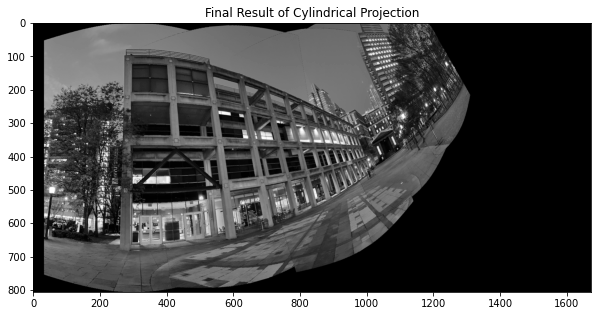

In [ ]:
i12345 = stitch(i1234,i5)

## f = 465

Text(0.5, 1.0, 'I6')

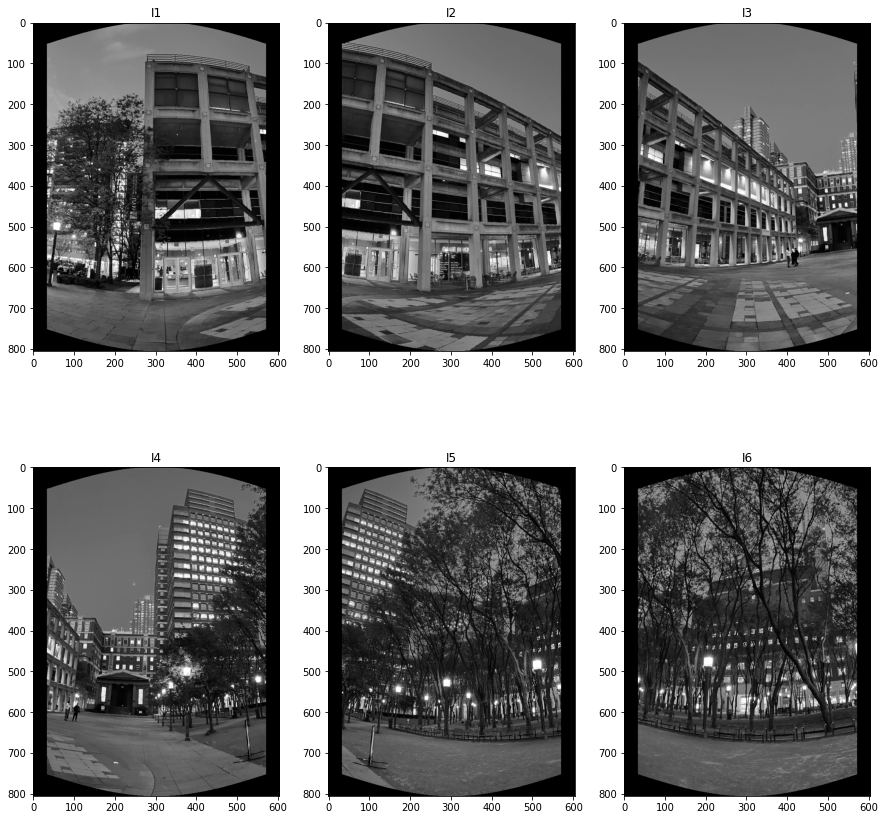

In [ ]:
# apply cylindrical projection
f = 465
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)
i8 = cylindrical_projection(i08, f)
i9 = cylindrical_projection(i09, f)
i10 = cylindrical_projection(i010, f)
i11 = cylindrical_projection(i011, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

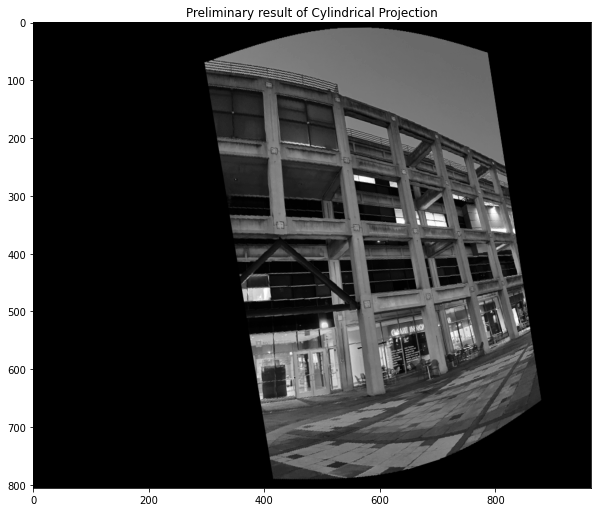

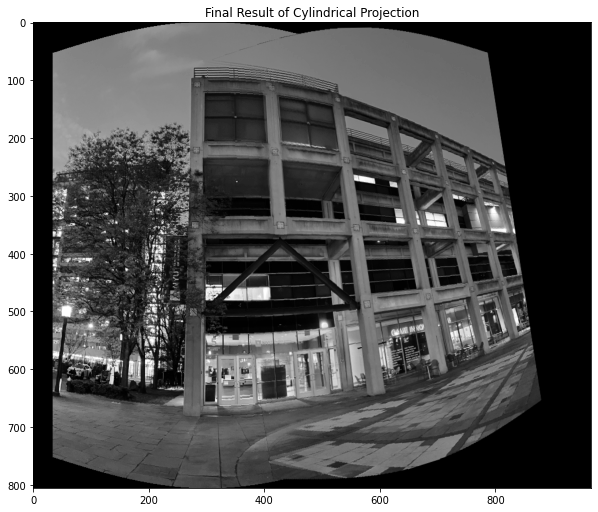

In [ ]:
i12 = stitch(i1,i2)

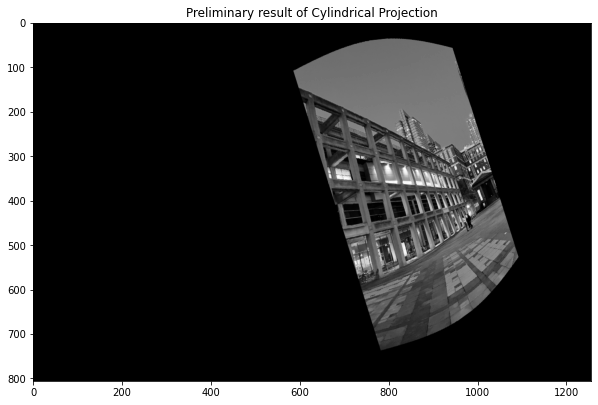

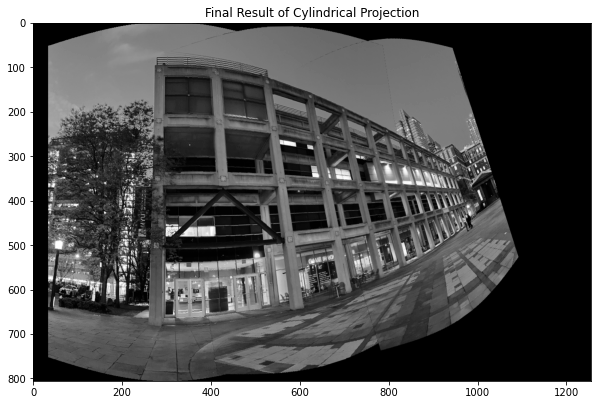

In [ ]:
i123 = stitch(i12,i3)

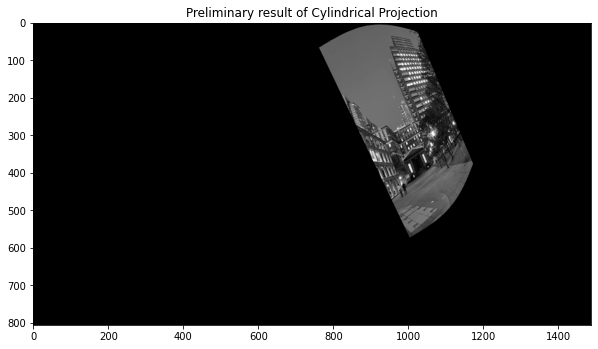

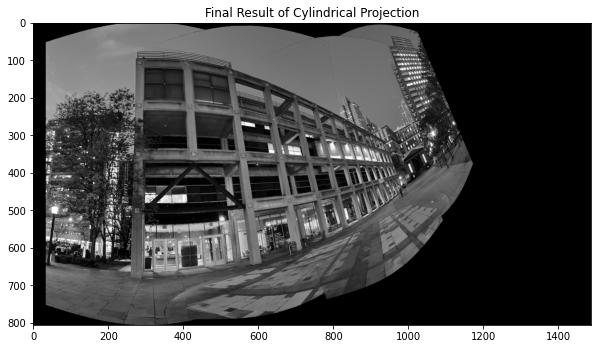

In [ ]:
i1234 = stitch(i123,i4)

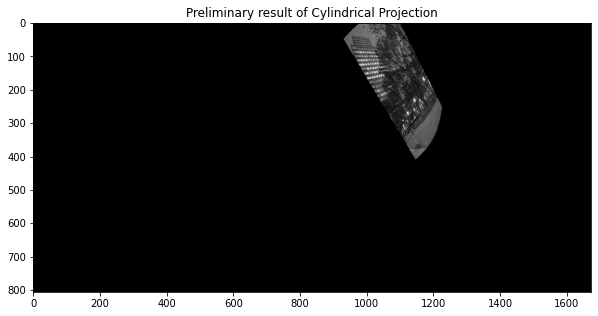

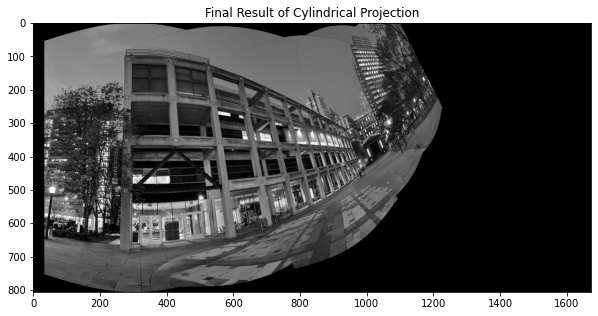

In [ ]:
i12345 = stitch(i1234,i5)

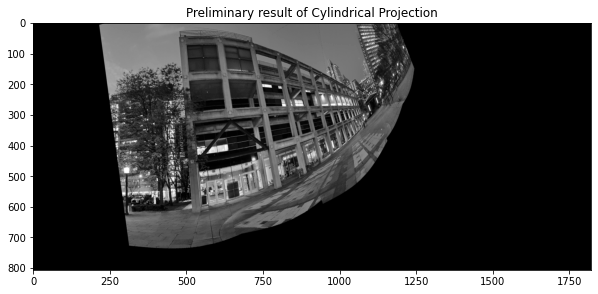

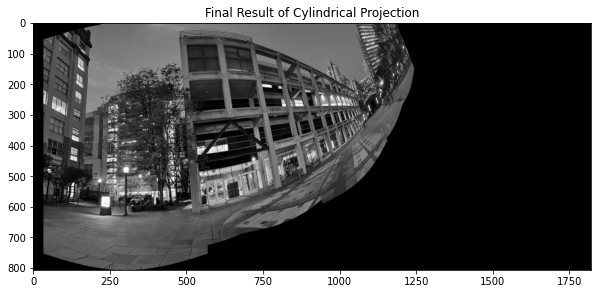

In [ ]:
i1112345 = stitch(i11,i12345)

# G images

In [ ]:
gpath = '/content/drive/MyDrive/IVP Image/Images_2g/'

In [ ]:
# Read images
i01 = cv2.imread(gpath + '1.jpg',0)
i02 = cv2.imread(gpath + '2.jpg',0)
i03 = cv2.imread(gpath + '3.jpg',0)
i04 = cv2.imread(gpath + '4.jpg',0)
i05 = cv2.imread(gpath + '5.jpg',0)
i06 = cv2.imread(gpath + '6.jpg',0)

In [ ]:
# Resized image to reduce computation of finding features and stitching
k = 5
height = int((i01.shape[0])/k)
width = int((i01.shape[1])/k)

# resize the image by resize() function of openCV library
i01 = cv2.resize(i01, (width, height), interpolation=cv2.INTER_AREA)
i02 = cv2.resize(i02, (width, height), interpolation=cv2.INTER_AREA)
i03 = cv2.resize(i03, (width, height), interpolation=cv2.INTER_AREA)
i04 = cv2.resize(i04, (width, height), interpolation=cv2.INTER_AREA)
i05 = cv2.resize(i05, (width, height), interpolation=cv2.INTER_AREA)
i06 = cv2.resize(i06, (width, height), interpolation=cv2.INTER_AREA)

In [ ]:
i01.shape

(604, 806)

## f = 195

Text(0.5, 1.0, 'I6')

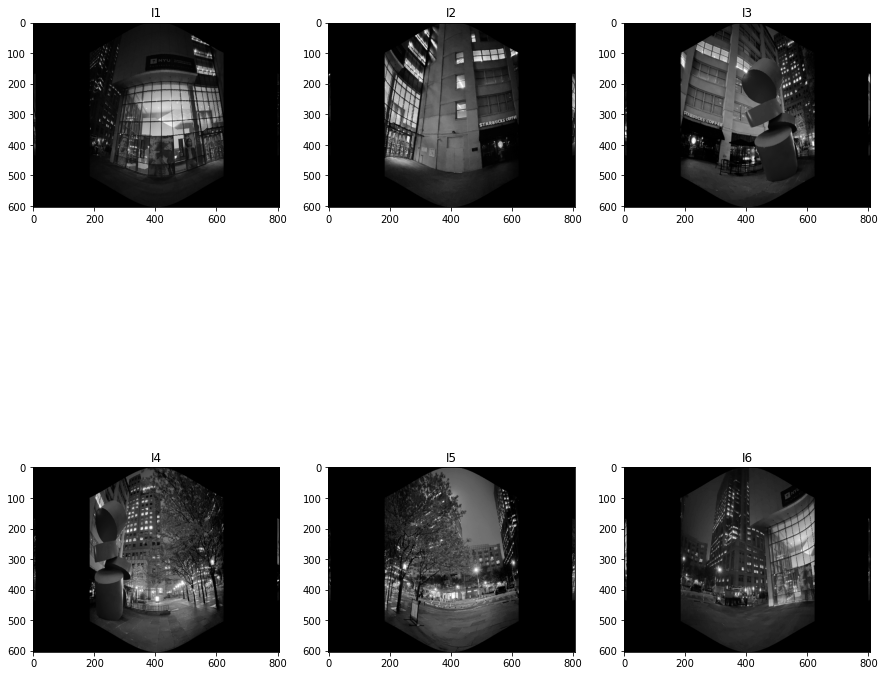

In [ ]:
# apply cylindrical projection
f = 195
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

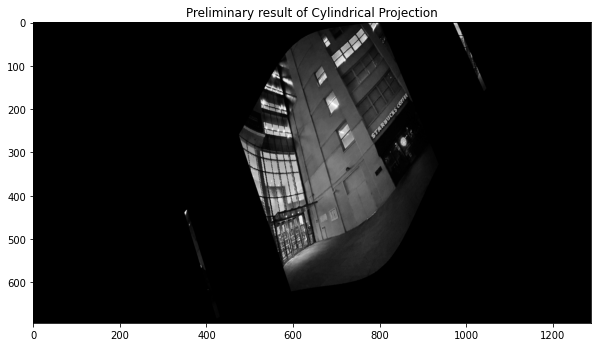

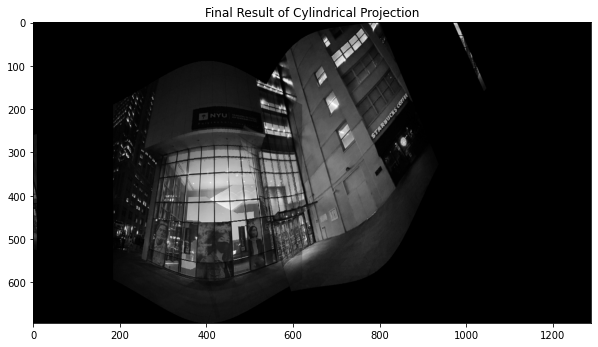

In [ ]:
i1_2 = stitch(i1, i2)

# Library

In [ ]:
lpath = '/content/drive/MyDrive/IVP Image/Images_4/'

In [ ]:
# Read images
i01 = cv2.imread(lpath + '1.jpg',0)
i02 = cv2.imread(lpath + '2.jpg',0)
i03 = cv2.imread(lpath + '3.jpg',0)
i04 = cv2.imread(lpath + '4.jpg',0)
i05 = cv2.imread(lpath + '5.jpg',0)
i06 = cv2.imread(lpath + '6.jpg',0)
i07 = cv2.imread(lpath + '7.jpg',0)
i08 = cv2.imread(lpath + '8.jpg',0)

In [ ]:
# Resized image to reduce computation of finding features and stitching
k = 5
height = int((i01.shape[0])/k)
width = int((i01.shape[1])/k)

# resize the image by resize() function of openCV library
i01 = cv2.resize(i01, (width, height), interpolation=cv2.INTER_AREA)
i02 = cv2.resize(i02, (width, height), interpolation=cv2.INTER_AREA)
i03 = cv2.resize(i03, (width, height), interpolation=cv2.INTER_AREA)
i04 = cv2.resize(i04, (width, height), interpolation=cv2.INTER_AREA)
i05 = cv2.resize(i05, (width, height), interpolation=cv2.INTER_AREA)
i06 = cv2.resize(i06, (width, height), interpolation=cv2.INTER_AREA)
i07 = cv2.resize(i07, (width, height), interpolation=cv2.INTER_AREA)
i08 = cv2.resize(i08, (width, height), interpolation=cv2.INTER_AREA)

In [ ]:
i01.shape

(604, 806)

## f = 520

Text(0.5, 1.0, 'I6')

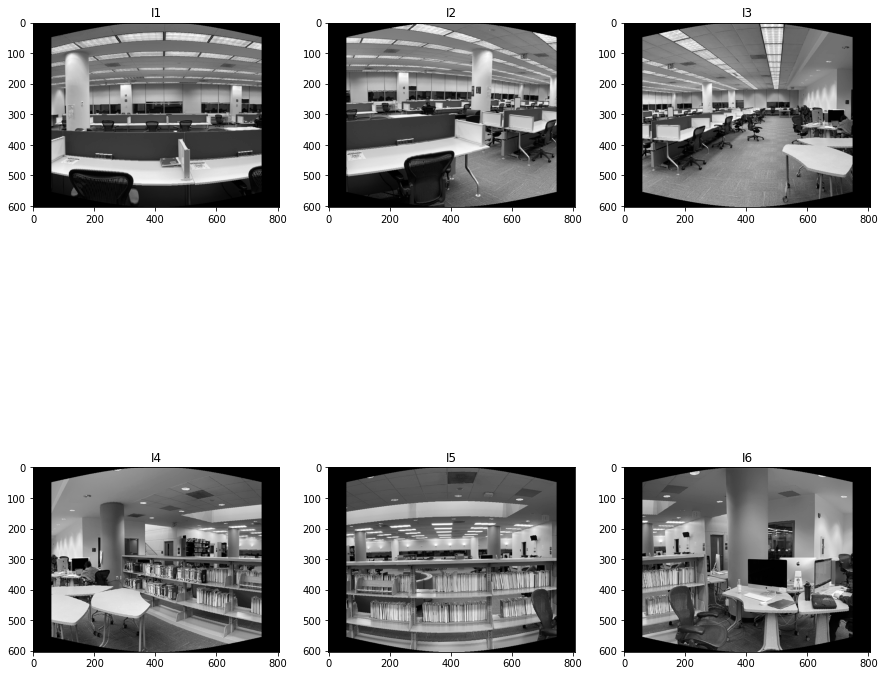

In [ ]:
# apply cylindrical projection
f = 520
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)
i8 = cylindrical_projection(i08, f)

plt.figure(figsize=(15,15))
plt.subplot(231)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(232)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(233)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(234)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(235)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(236)
plt.imshow(i6, 'gray')
plt.title('I6')

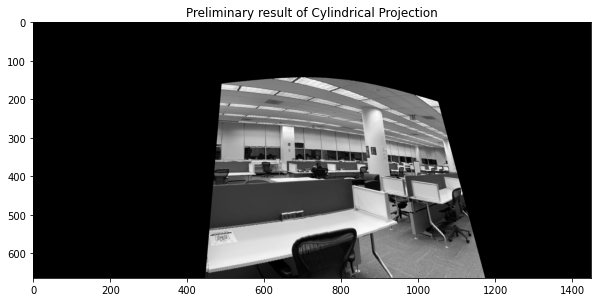

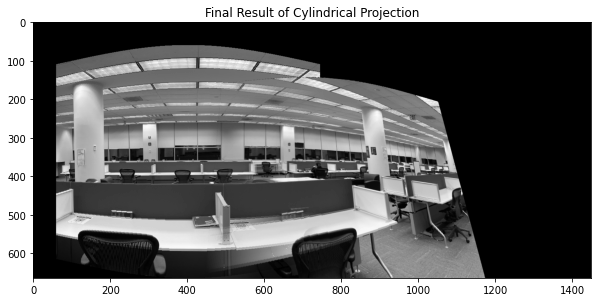

In [ ]:
i1_2 = stitch(i1,i2)

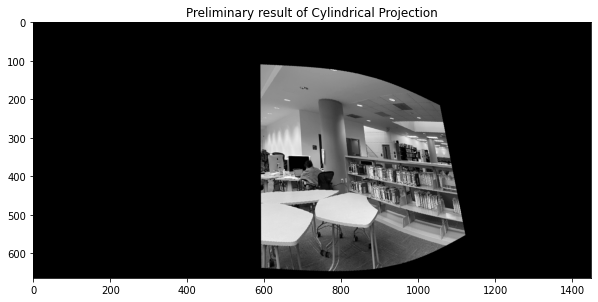

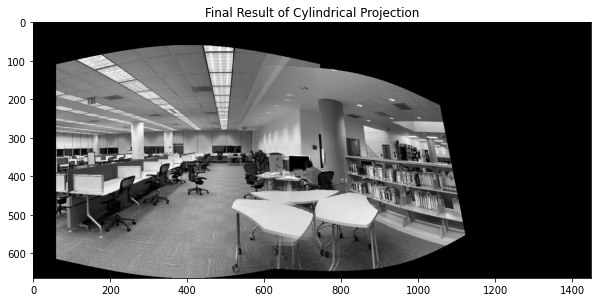

In [ ]:
i3_4 = stitch(i3,i4)

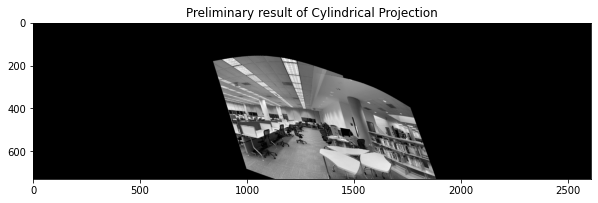

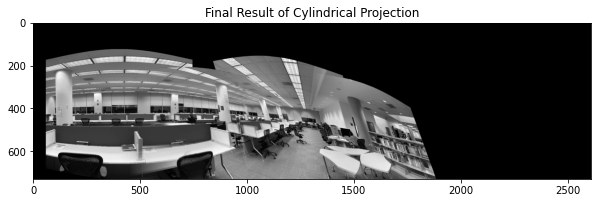

In [ ]:
i1_4 = stitch(i1_2, i3_4)

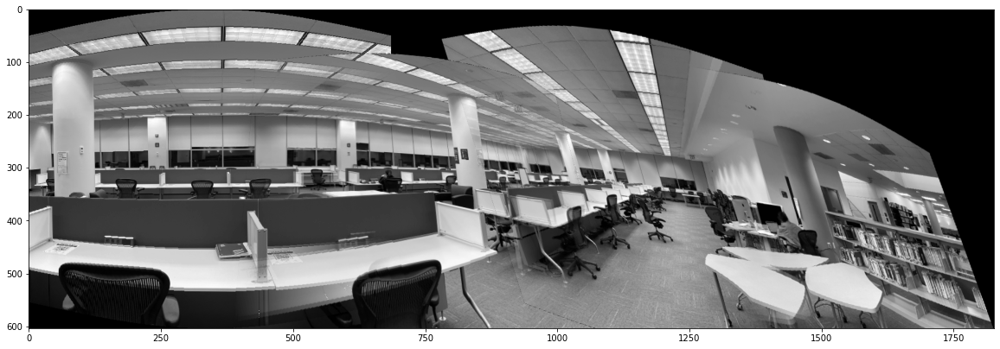

In [ ]:
i1_4_final = edge_delete(i1_4)

In [ ]:
cv2.imwrite('Library1_4_f520.jpg', i1_4_final)

True

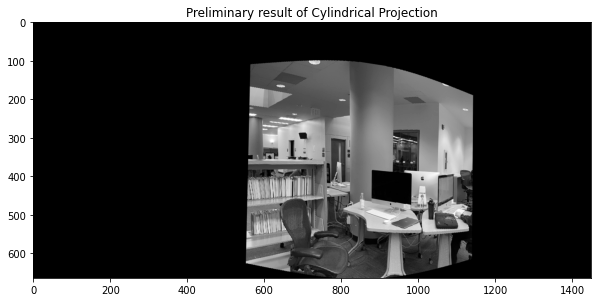

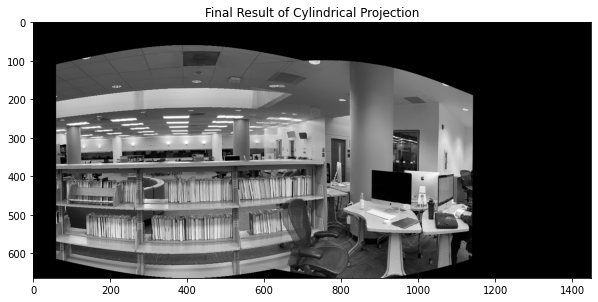

In [ ]:
i5_6 = stitch(i5,i6)

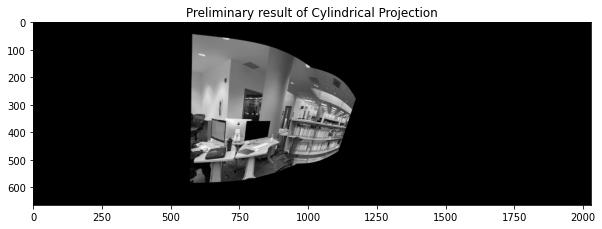

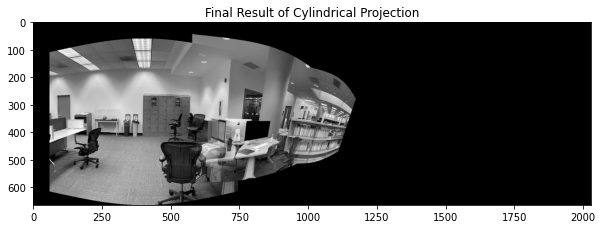

In [ ]:
i5_7_flip = stitch(np.flip(i7, 1), np.flip(i5_6, 1))

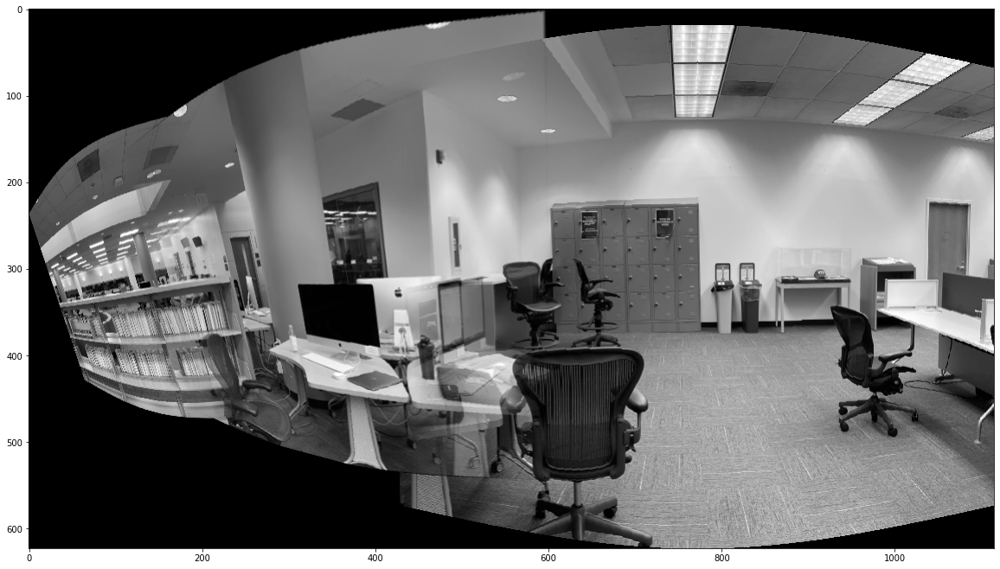

In [ ]:
i5_7_final = edge_delete(np.flip(i5_7_flip, 1))

In [ ]:
cv2.imwrite('Library5_7_f520.jpg', i5_7_final)

True

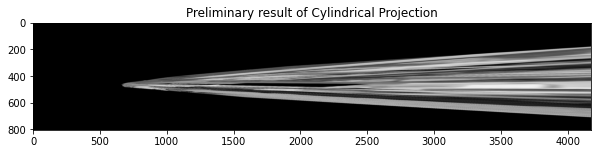

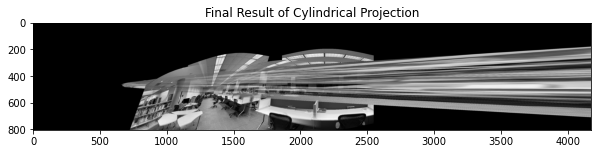

In [ ]:
i5_4_flip = stitch(np.flip(i1_4, 1), i5_7_flip)

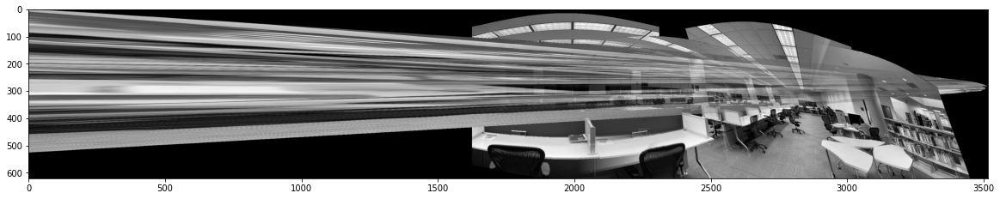

In [ ]:
i5_4_final = edge_delete(np.flip(i5_4_flip, 1))

In [ ]:
cv2.imwrite('LibraryAll_f520.jpg', i5_4_final)

True

5>6<7   2>3<4   3>6

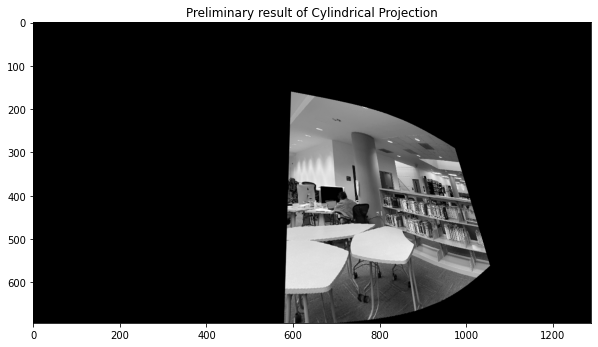

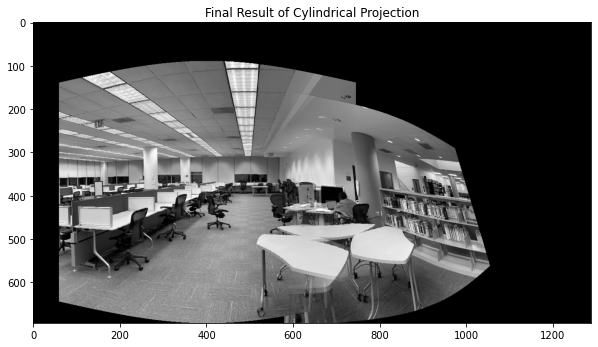

In [ ]:
i3_4 = stitch(i3,i4)

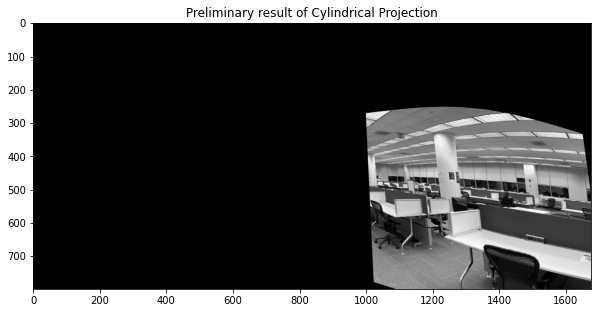

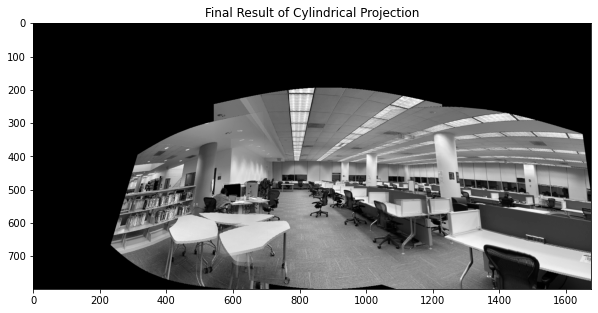

In [ ]:
i2_4_flip = stitch(np.flip(i3_4, 1), np.flip(i2, 1))

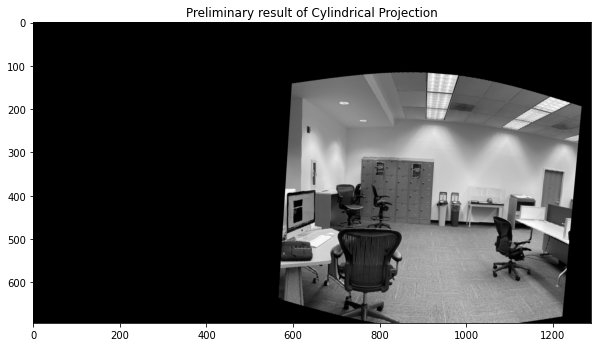

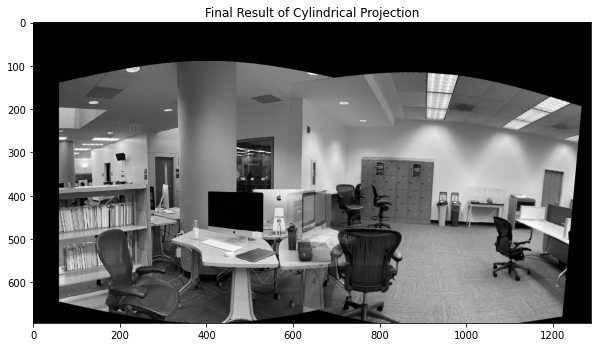

In [ ]:
i6_7 = stitch(i6, i7)

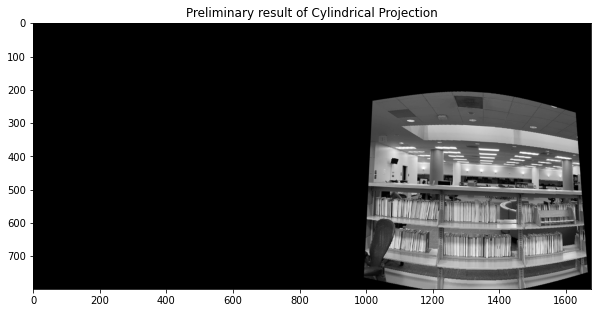

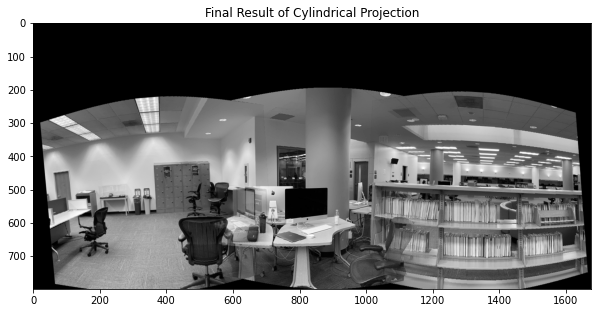

In [ ]:
i5_7_flip = stitch(np.flip(i6_7, 1), np.flip(i5, 1))

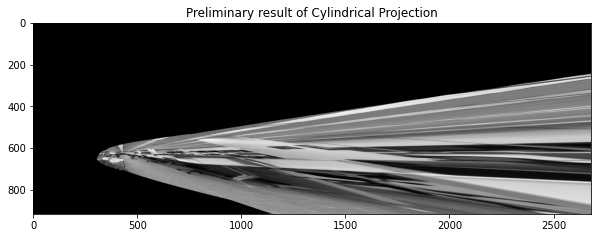

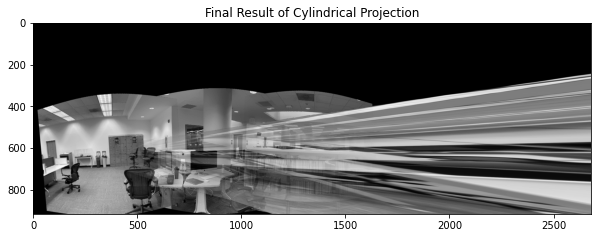

In [ ]:
i2_7_flip = stitch(i5_7_flip, i2_4_flip)

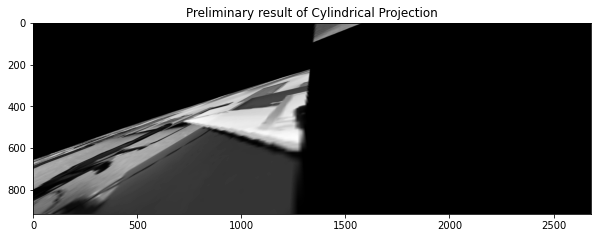

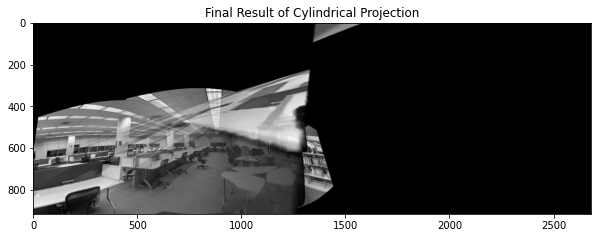

In [ ]:
i2_7 = stitch(np.flip(i2_4_flip, 1), np.flip(i5_7_flip, 1))

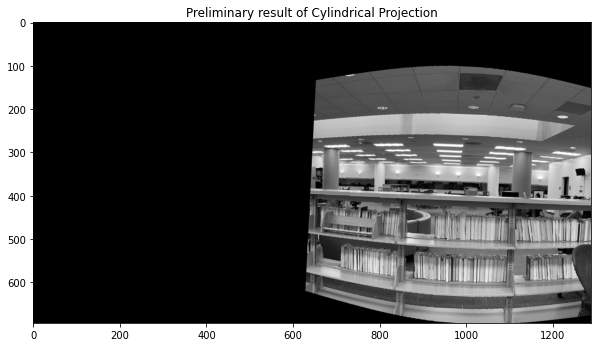

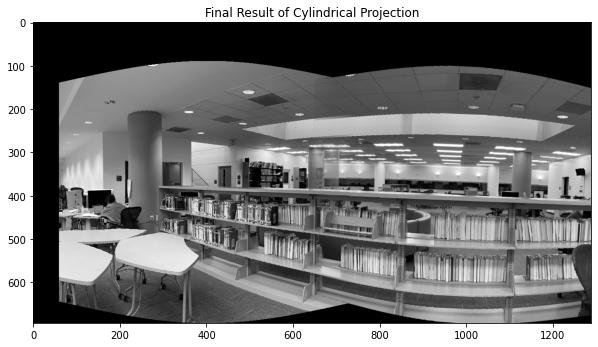

In [ ]:
i4_5 = stitch(i4,i5)

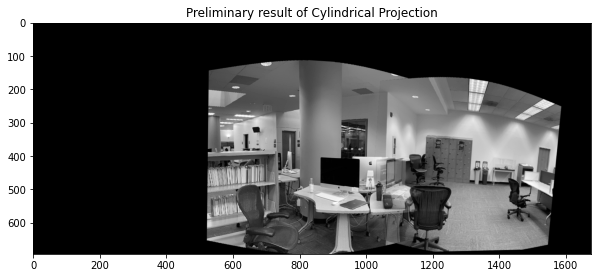

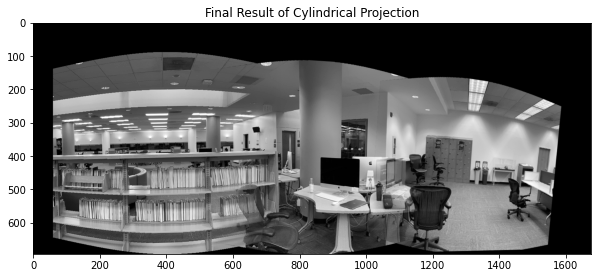

In [ ]:
i5_7 = stitch(i5, i6_7)

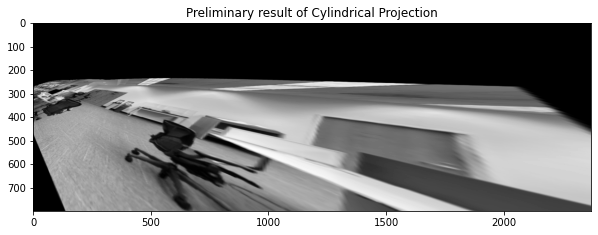

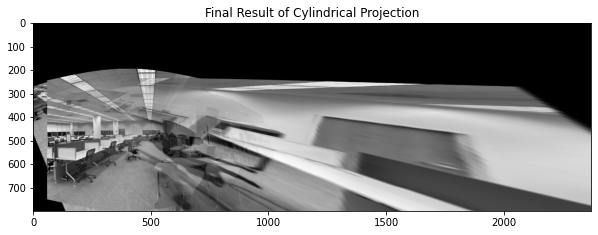

In [ ]:
i3_7 = stitch(i3_4, i5_7)

# RI

In [ ]:
path = '/content/drive/MyDrive/IVP Image/RI_3/'

In [ ]:
# Read images
i01 = cv2.imread(path + '1.jpg',0)
i02 = cv2.imread(path + '2.jpg',0)
i03 = cv2.imread(path + '3.jpg',0)
i04 = cv2.imread(path + '4.jpg',0)
i05 = cv2.imread(path + '5.jpg',0)
i06 = cv2.imread(path + '6.jpg',0)
i07 = cv2.imread(path + '7.jpg',0)

In [ ]:
# Resized image to reduce computation of finding features and stitching
k = 5
height = int((i01.shape[0])/k)
width = int((i01.shape[1])/k)

# resize the image by resize() function of openCV library
i01 = cv2.resize(i01, (width, height), interpolation=cv2.INTER_AREA)
i02 = cv2.resize(i02, (width, height), interpolation=cv2.INTER_AREA)
i03 = cv2.resize(i03, (width, height), interpolation=cv2.INTER_AREA)
i04 = cv2.resize(i04, (width, height), interpolation=cv2.INTER_AREA)
i05 = cv2.resize(i05, (width, height), interpolation=cv2.INTER_AREA)
i06 = cv2.resize(i06, (width, height), interpolation=cv2.INTER_AREA)
i07 = cv2.resize(i07, (width, height), interpolation=cv2.INTER_AREA)

print(i01.shape)

(604, 806)


## f = 540

Text(0.5, 1.0, 'I7')

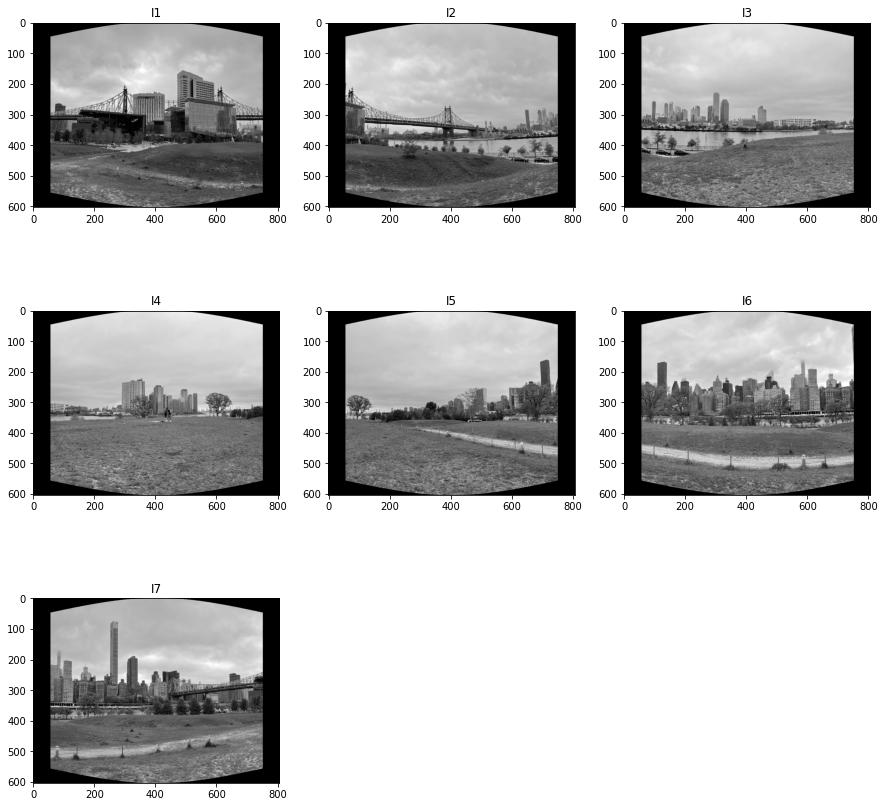

In [ ]:
# apply cylindrical projection
f = 540
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)

plt.figure(figsize=(15,15))
plt.subplot(331)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(332)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(333)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(334)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(335)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(336)
plt.imshow(i6, 'gray')
plt.title('I6')
plt.subplot(337)
plt.imshow(i7, 'gray')
plt.title('I7')

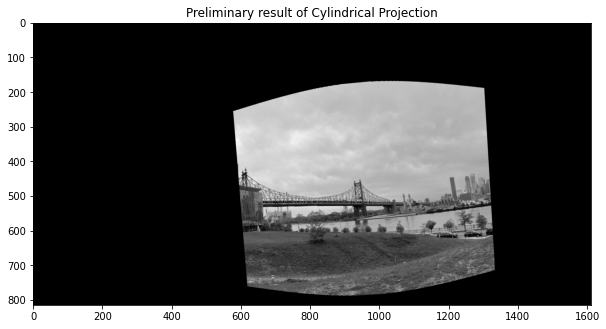

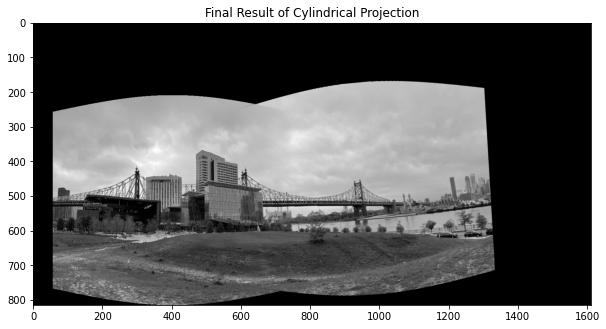

In [ ]:
i1_2 = stitch(i1,i2)

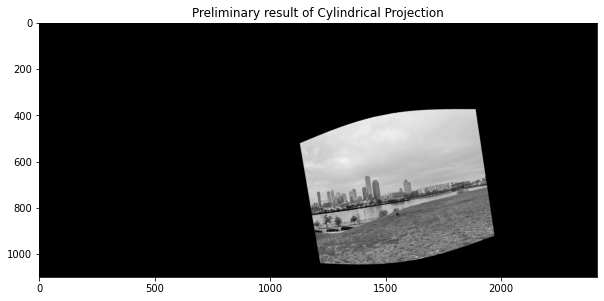

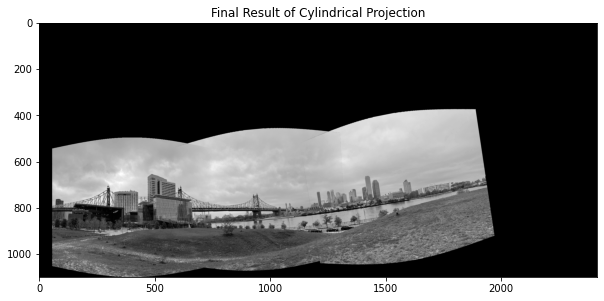

In [ ]:
i1_3 = stitch(i1_2, i3)

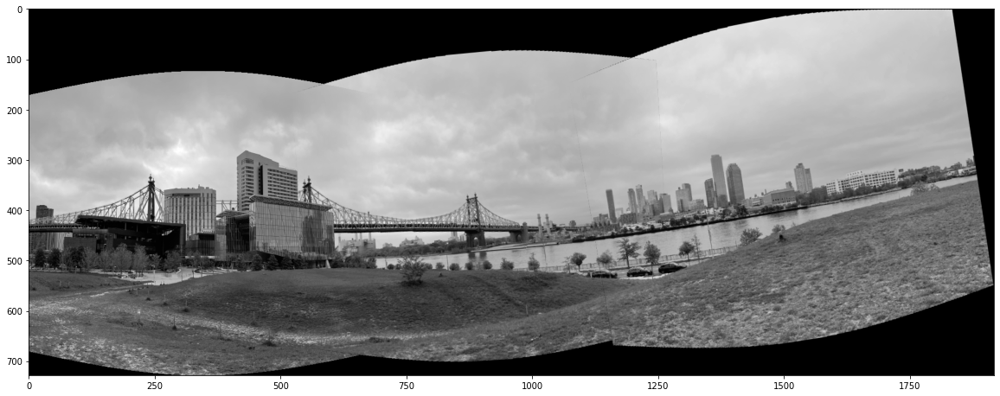

In [ ]:
i1_3_crop = edge_delete(i1_3)

In [ ]:
cv2.imwrite('RI_1_3_Projection.jpg', i1_3_crop)

True

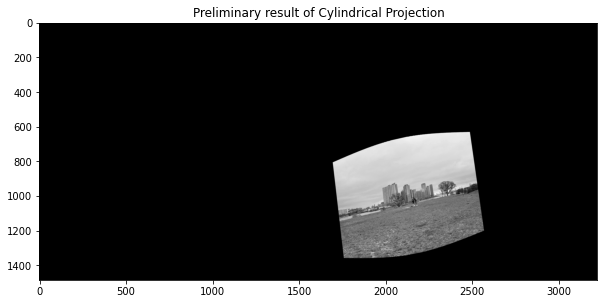

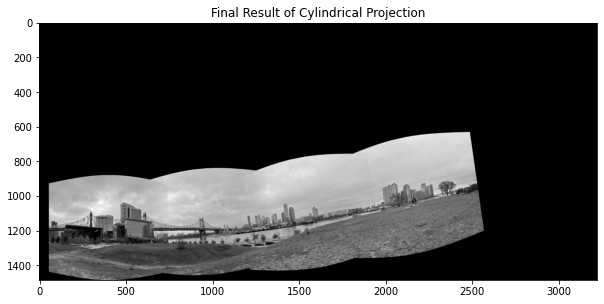

In [ ]:
i1_4 = stitch(i1_3, i4)

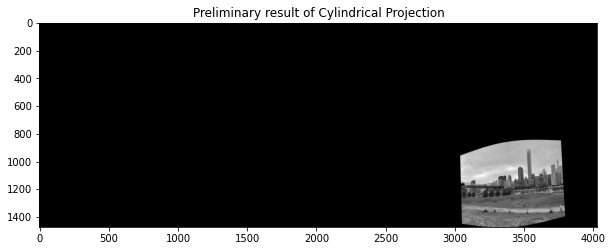

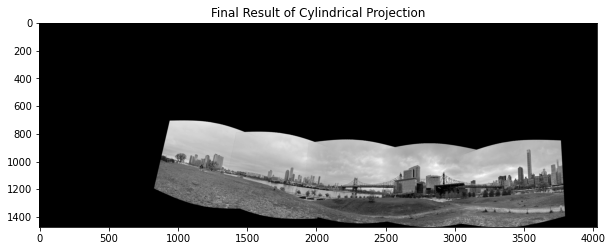

In [ ]:
i7_1_flip = stitch(np.flip(i1_4, 1), np.flip(i7, 1))

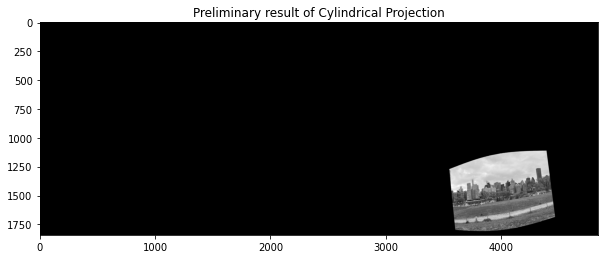

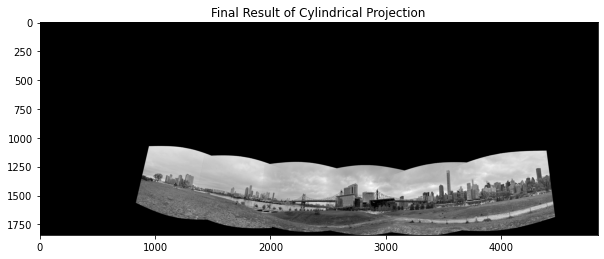

In [ ]:
i6_1_flip = stitch(i7_1_flip, np.flip(i6, 1))

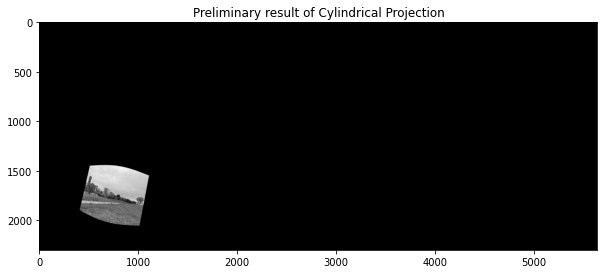

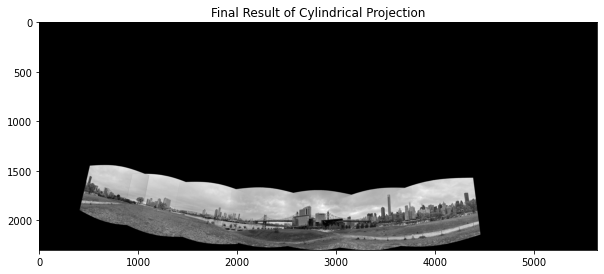

In [ ]:
i5_1_flip = stitch(i6_1_flip, np.flip(i5, 1))

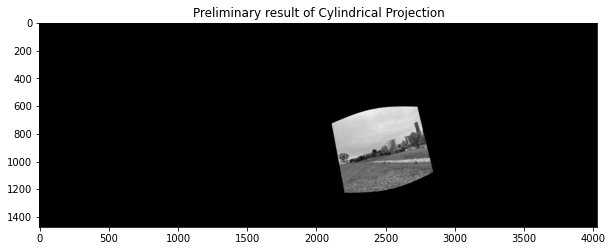

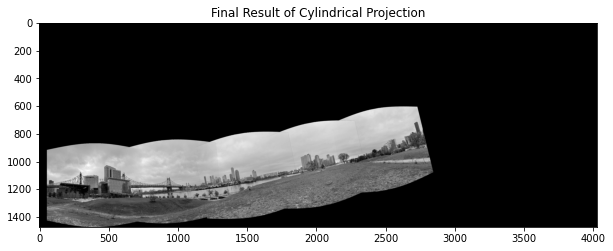

In [ ]:
i1_5 = stitch(i1_4,i5)

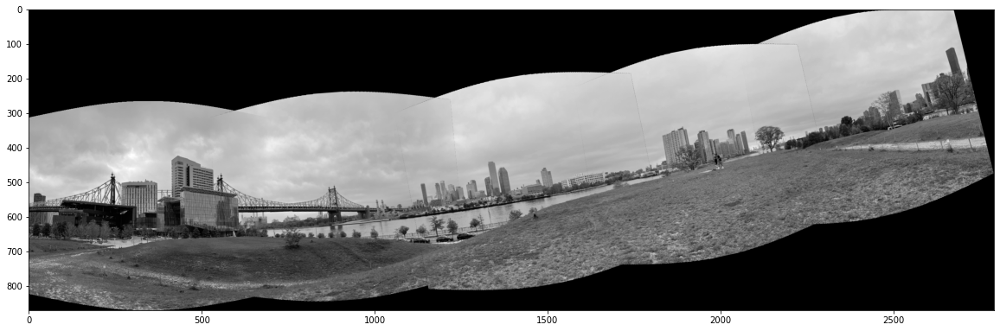

In [ ]:
i1_5_crop = edge_delete(i1_5)

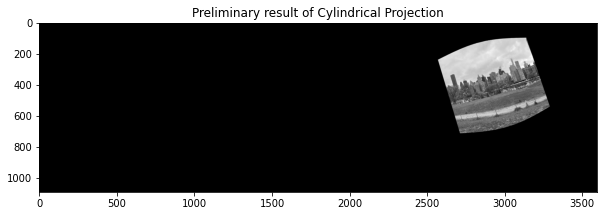

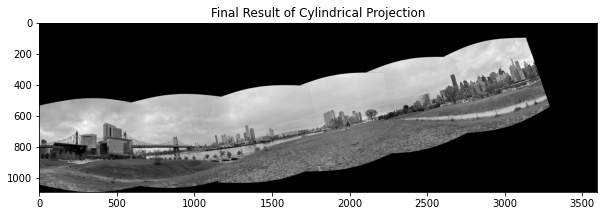

In [ ]:
i1_6 = stitch(i1_5_crop,i6)

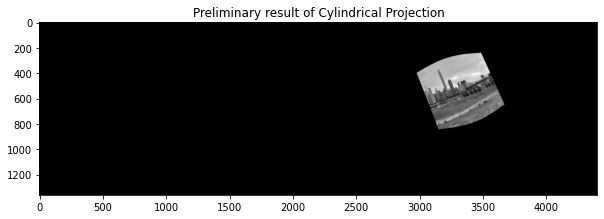

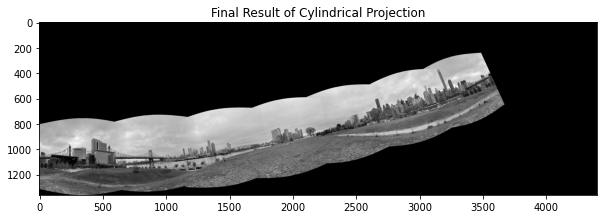

In [ ]:
i1_7 = stitch(i1_6,i7)

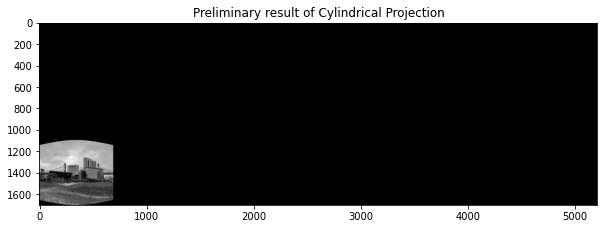

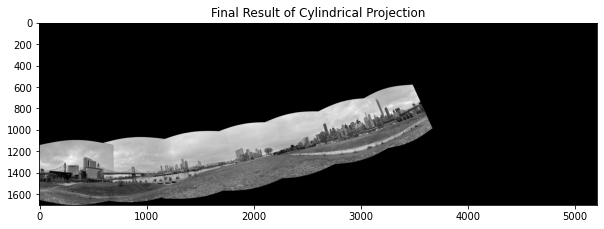

In [ ]:
i1_7_1 = stitch(i1_7,i1)

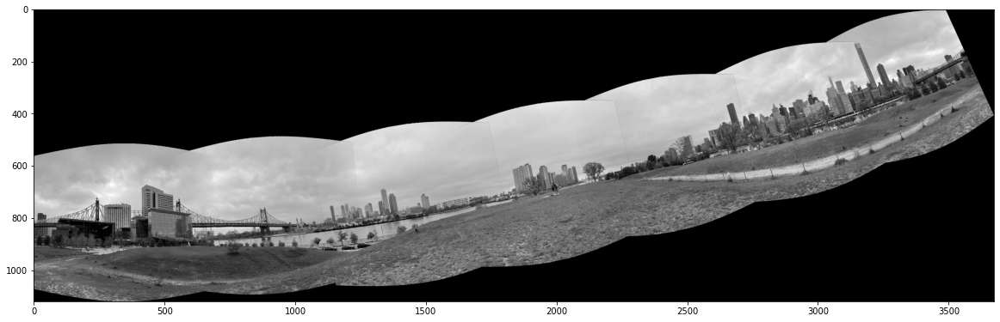

In [ ]:
i1_7_crop = edge_delete(i1_7)

In [ ]:
cv2.imwrite('RI_III_1_7.jpg', i1_7_crop)

True

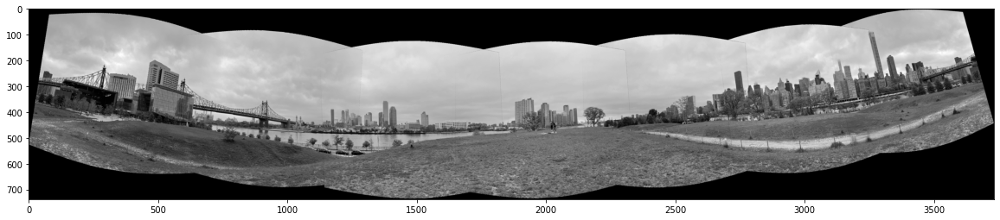

In [ ]:
i1_7_rotate = ndimage.rotate(i1_7_crop, -9)
i1_7_rotate_crop = edge_delete(i1_7_rotate)
plt.imshow(i1_7_rotate_crop, cmap='gray')

In [ ]:
cv2.imwrite('RI_III_1_7_Rotate.jpg', i1_7_rotate_crop)

True

### Center at I4

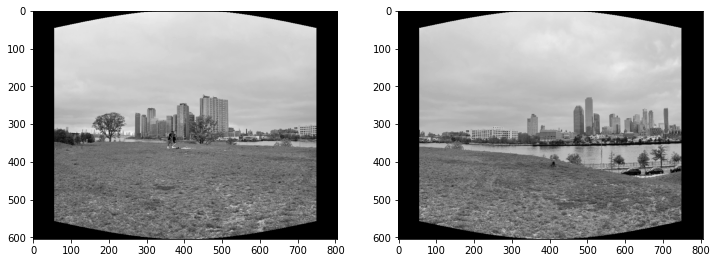

In [ ]:
plt.figure(figsize=(12,12))
plt.subplot(121)
plt.imshow(np.flip(i4,1), cmap='gray')
plt.subplot(122)
plt.imshow(np.flip(i3,1), cmap='gray')

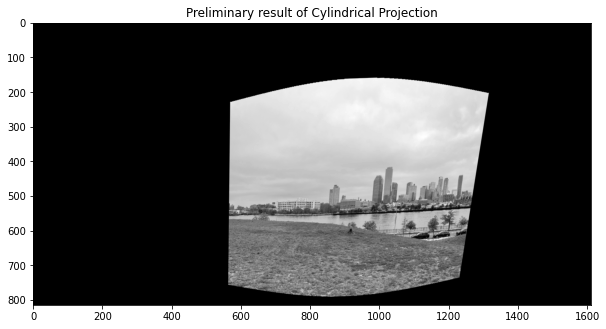

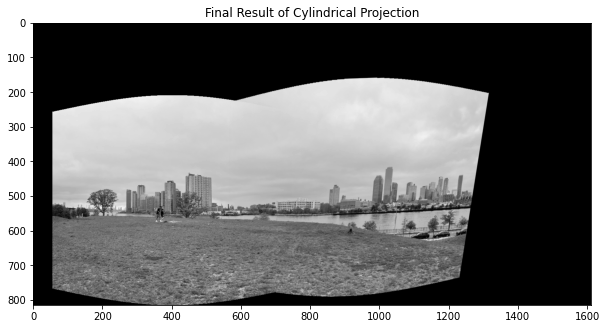

In [ ]:
i3_4_flip = stitch(np.flip(i4, 1), np.flip(i3, 1))

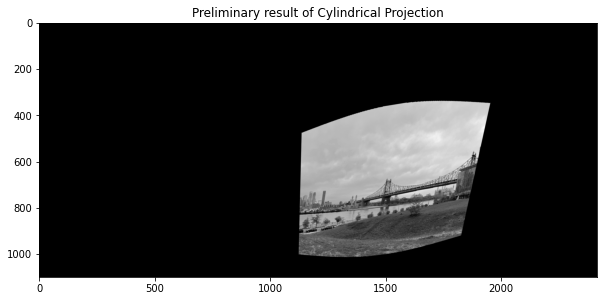

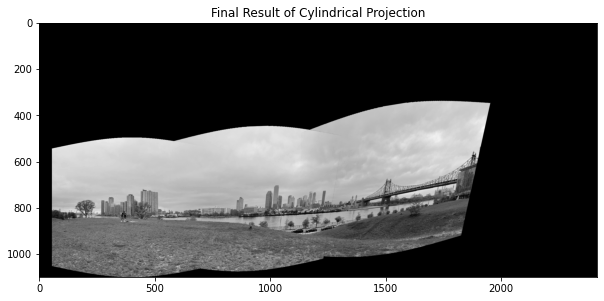

In [ ]:
i2_4_flip = stitch(i3_4_flip, np.flip(i2, 1))

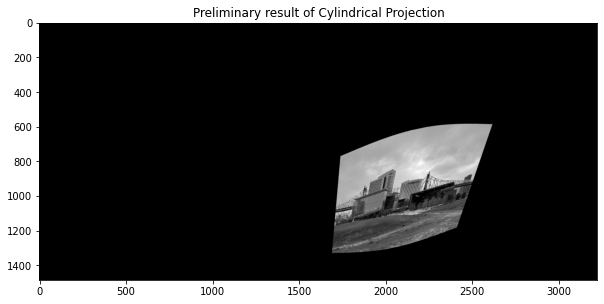

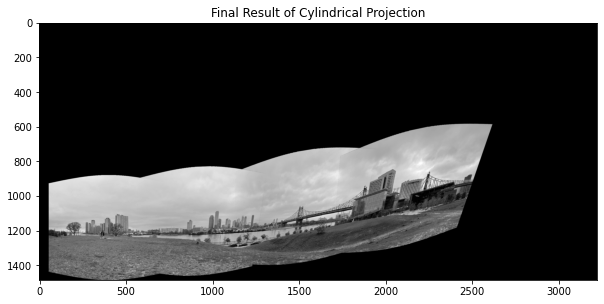

In [ ]:
i1_4_flip = stitch(i2_4_flip, np.flip(i1, 1))

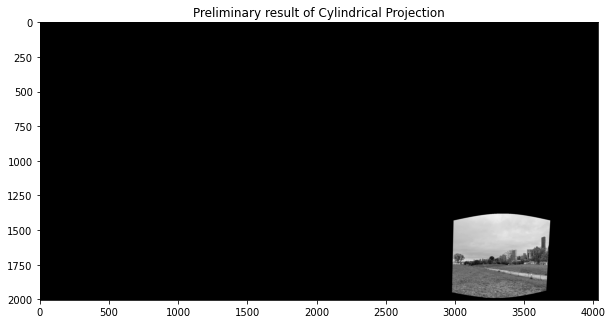

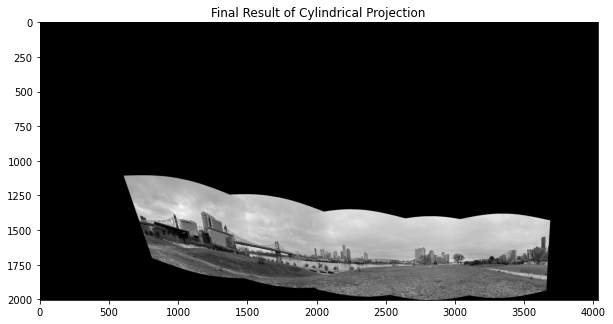

In [ ]:
i1_4_5 = stitch(np.flip(i1_4_flip, 1), i5)

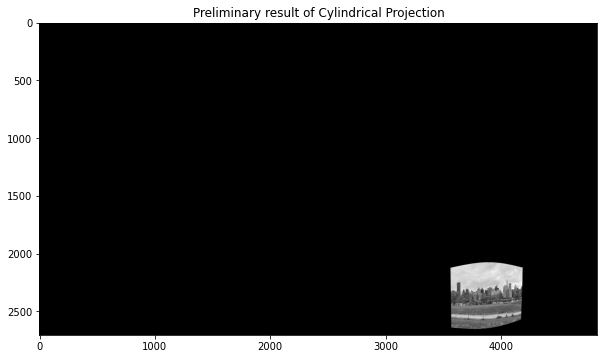

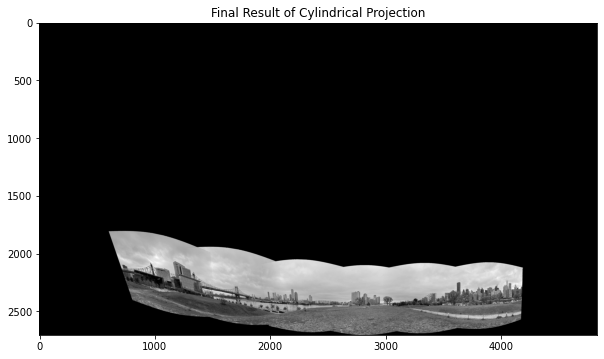

In [ ]:
i1_4_6 = stitch(i1_4_5, i6)

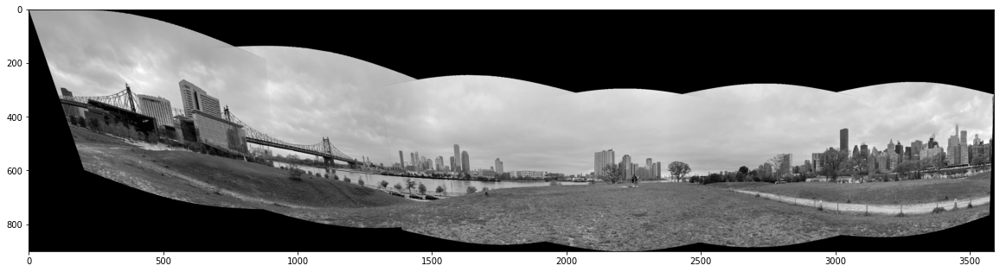

In [ ]:
i1_4_6_crop = edge_delete(i1_4_6)

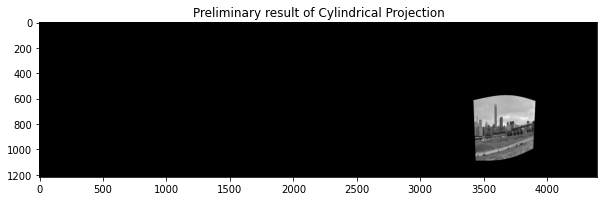

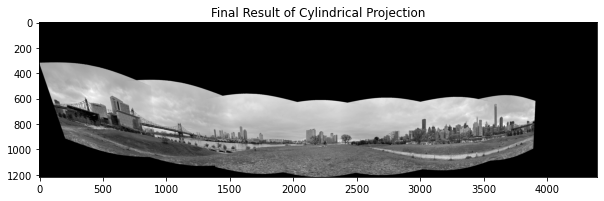

In [ ]:
i1_4_7 = stitch(i1_4_6_crop, i7)

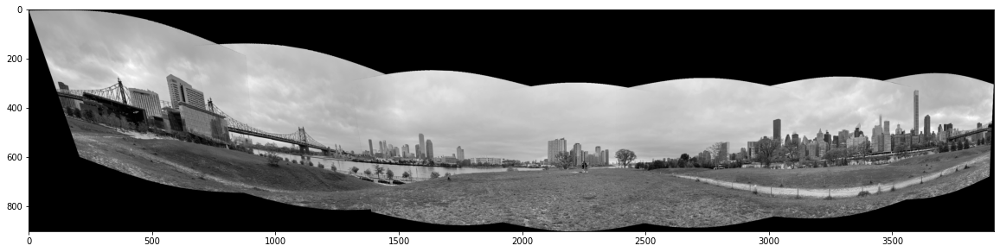

In [ ]:
i1_4_7_final = edge_delete(i1_4_7)

### Start at 3

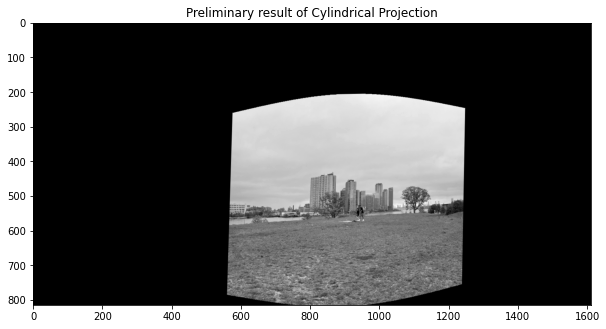

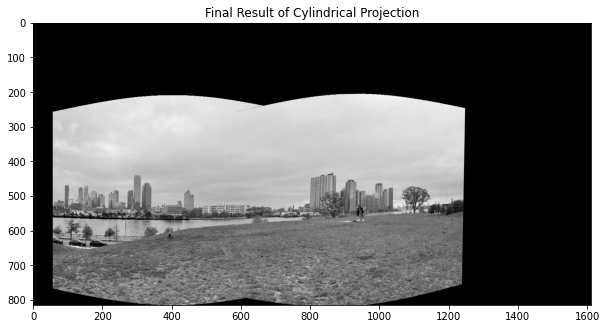

In [ ]:
i3_4 = stitch(i3,i4)

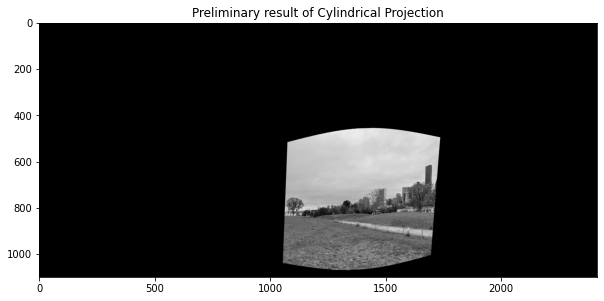

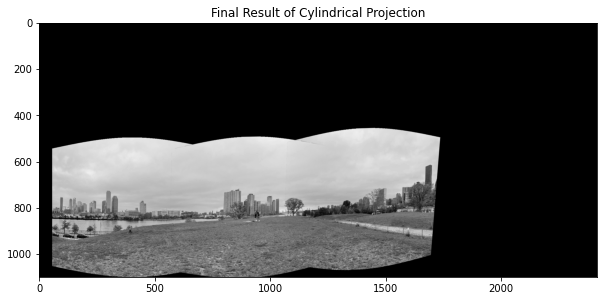

In [ ]:
i3_5 = stitch(i3_4, i5)

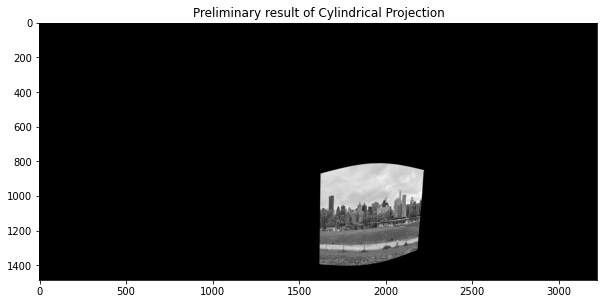

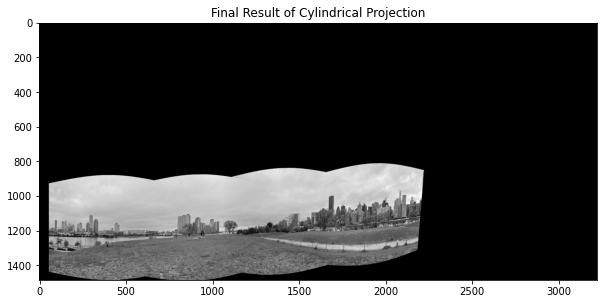

In [ ]:
i3_6 = stitch(i3_5, i6)

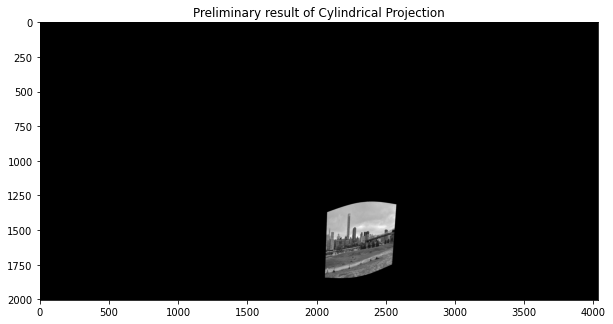

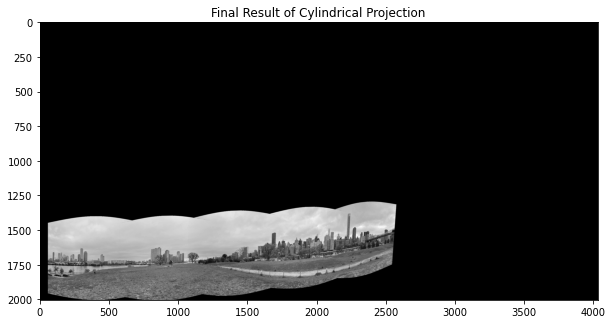

In [ ]:
i3_7 = stitch(i3_6, i7)

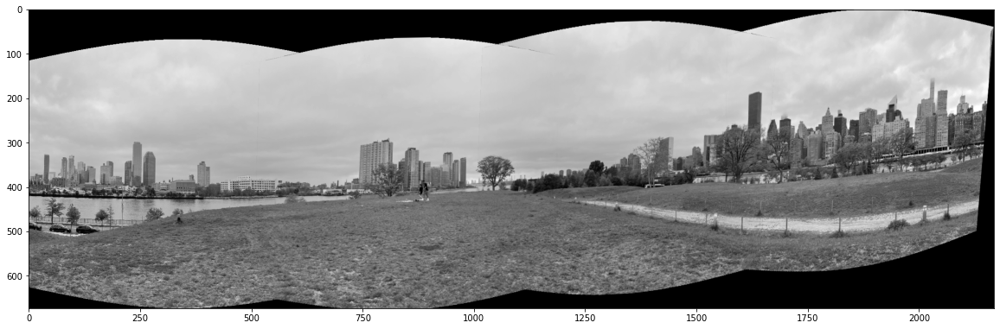

In [ ]:
i3_6_crop = edge_delete(i3_6)

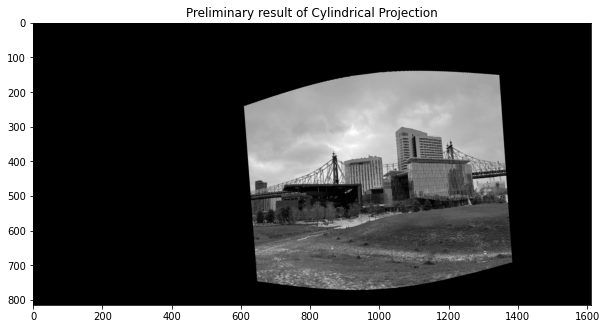

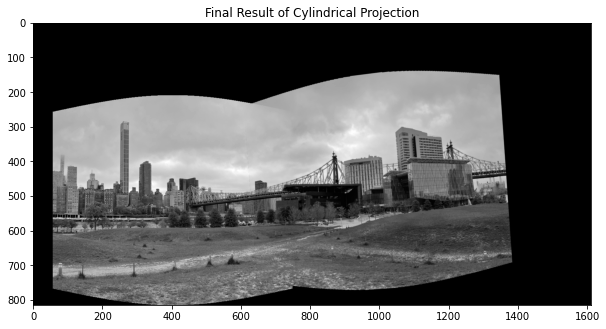

In [ ]:
i7_1 = stitch(i7, i1)

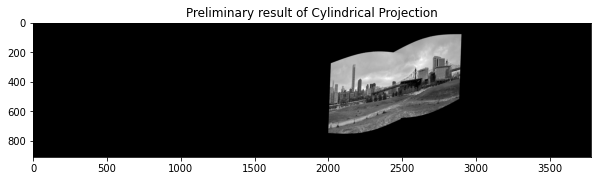

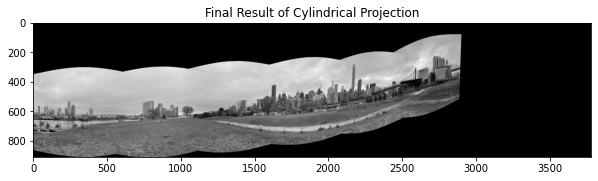

In [ ]:
i3_1 = stitch(i3_6_crop, i7_1)

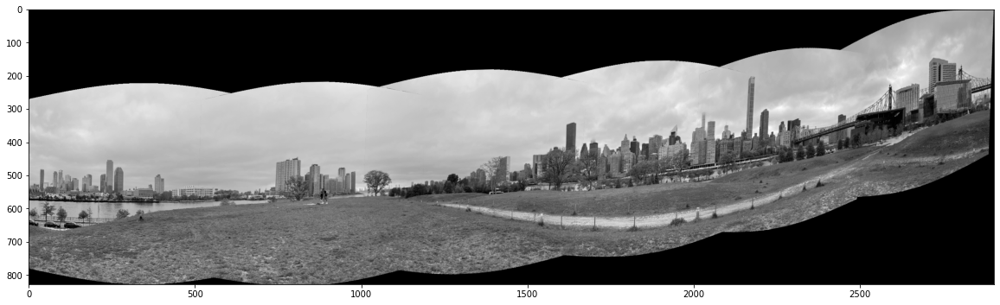

In [ ]:
i3_1_crop = edge_delete(i3_1)

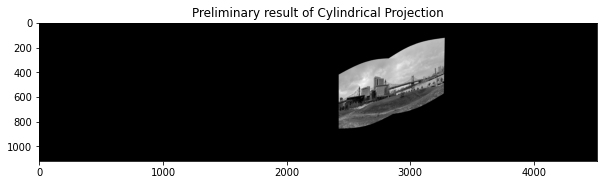

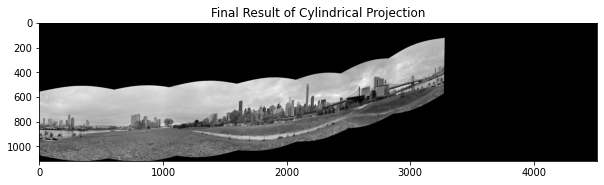

In [ ]:
i3_2 = stitch(i3_1_crop, i1_2)

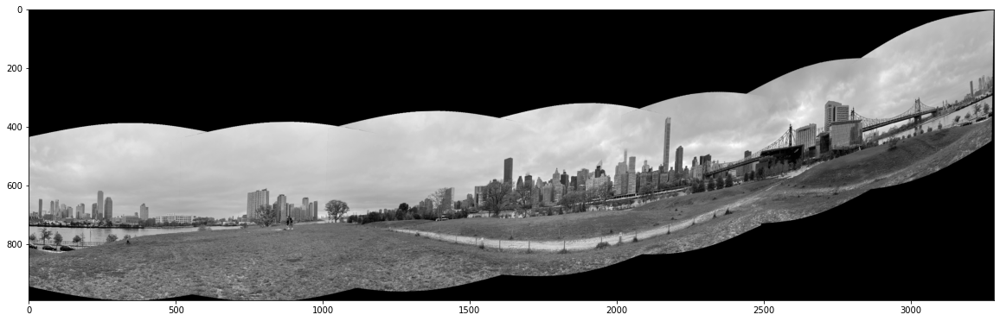

In [ ]:
i3_2_crop = edge_delete(i3_2)

# RI_rotate

In [ ]:
path = '/content/drive/MyDrive/IVP Image/RI_3_Rotate/'

In [ ]:
# Read images
i01 = cv2.imread(path + '1.jpg',0)
i02 = cv2.imread(path + '2.jpg',0)
i03 = cv2.imread(path + '3.jpg',0)
i04 = cv2.imread(path + '4.jpg',0)
i05 = cv2.imread(path + '5.jpg',0)
i06 = cv2.imread(path + '6.jpg',0)
i07 = cv2.imread(path + '7.jpg',0)

In [ ]:
# Resized image to reduce computation of finding features and stitching
#k = 5
#height = int((i01.shape[0])/k)
#width = int((i01.shape[1])/k)

size = (806, 604)

# resize the image by resize() function of openCV library
i01 = cv2.resize(i01, size, interpolation=cv2.INTER_AREA)
i02 = cv2.resize(i02, size, interpolation=cv2.INTER_AREA)
i03 = cv2.resize(i03, size, interpolation=cv2.INTER_AREA)
i04 = cv2.resize(i04, size, interpolation=cv2.INTER_AREA)
i05 = cv2.resize(i05, size, interpolation=cv2.INTER_AREA)
i06 = cv2.resize(i06, size, interpolation=cv2.INTER_AREA)
i07 = cv2.resize(i07, size, interpolation=cv2.INTER_AREA)

print(i01.shape)

(604, 806)


## f = 540

Text(0.5, 1.0, 'I7')

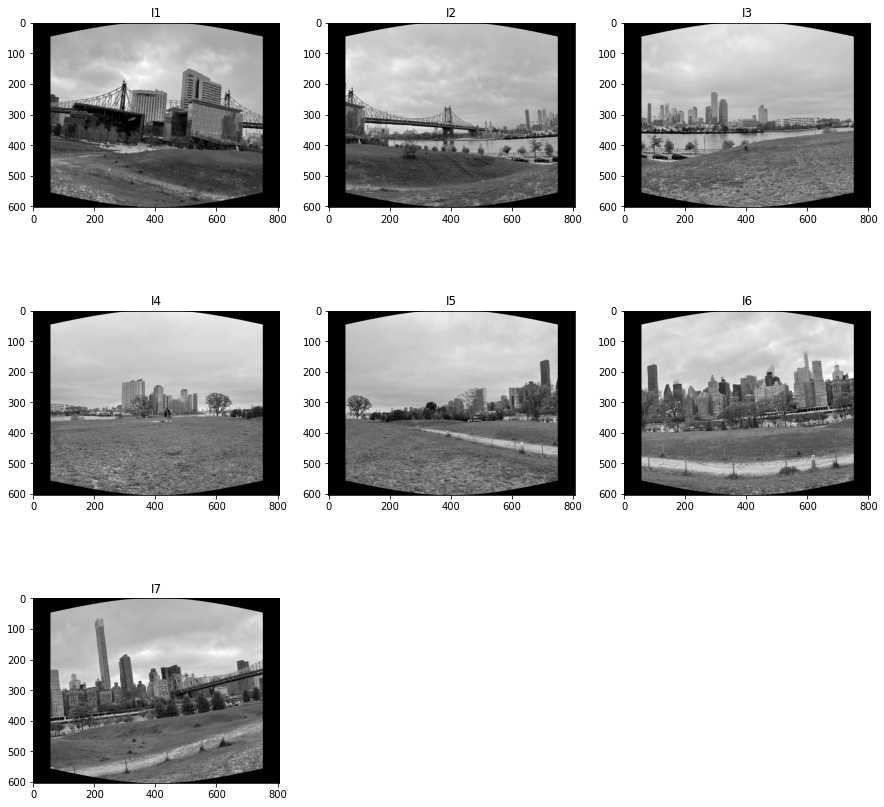

In [ ]:
# apply cylindrical projection
f = 540
i1 = cylindrical_projection(i01, f)
i2 = cylindrical_projection(i02, f)
i3 = cylindrical_projection(i03, f)
i4 = cylindrical_projection(i04, f)
i5 = cylindrical_projection(i05, f)
i6 = cylindrical_projection(i06, f)
i7 = cylindrical_projection(i07, f)

plt.figure(figsize=(15,15))
plt.subplot(331)
plt.imshow(i1, 'gray')
plt.title('I1')
plt.subplot(332)
plt.imshow(i2, 'gray')
plt.title('I2')
plt.subplot(333)
plt.imshow(i3, 'gray')
plt.title('I3')
plt.subplot(334)
plt.imshow(i4, 'gray')
plt.title('I4')
plt.subplot(335)
plt.imshow(i5, 'gray')
plt.title('I5')
plt.subplot(336)
plt.imshow(i6, 'gray')
plt.title('I6')
plt.subplot(337)
plt.imshow(i7, 'gray')
plt.title('I7')

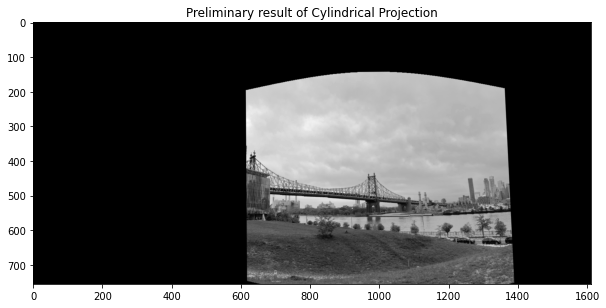

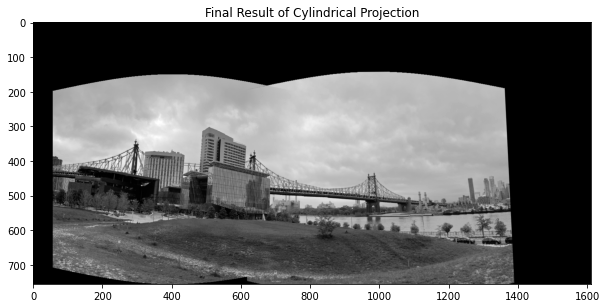

In [ ]:
i1_2 = stitch(i1,i2)

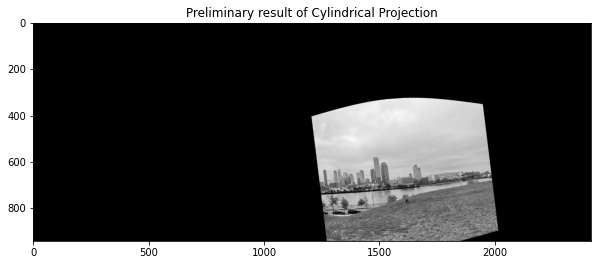

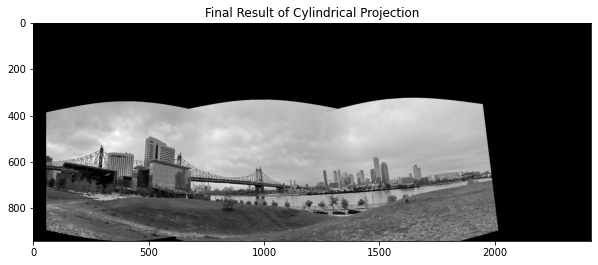

In [ ]:
i1_3 = stitch(i1_2, i3)

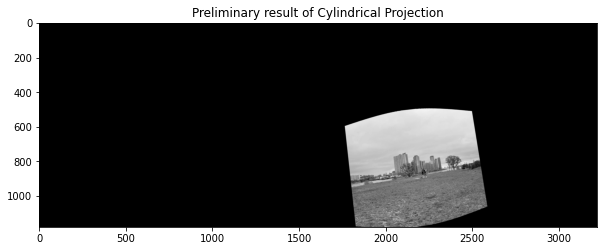

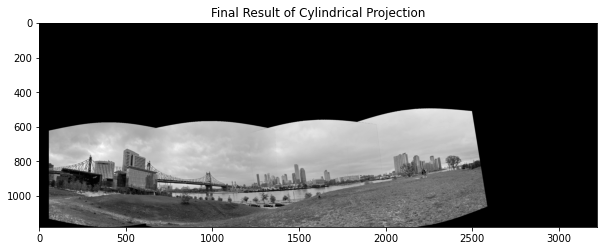

In [ ]:
i1_4 = stitch(i1_3, i4)

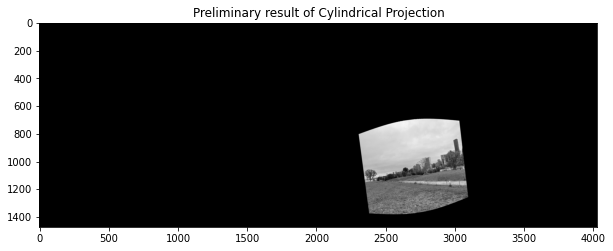

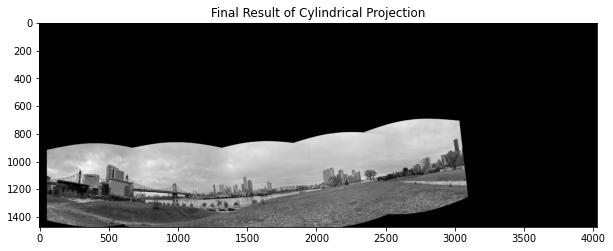

In [ ]:
i1_5 = stitch(i1_4, i5)

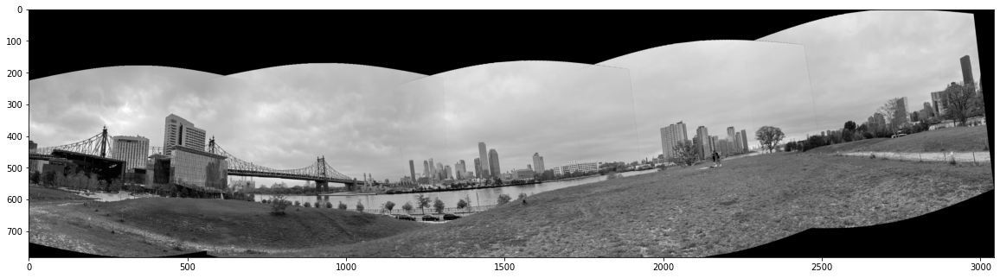

In [ ]:
i1_5_crop = edge_delete(i1_5)

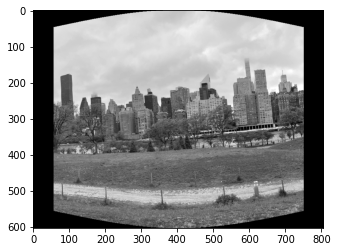

In [ ]:
plt.imshow(i6, cmap='gray')

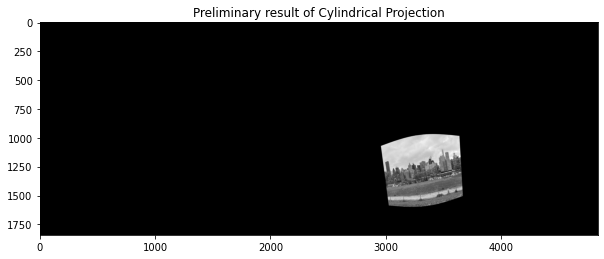

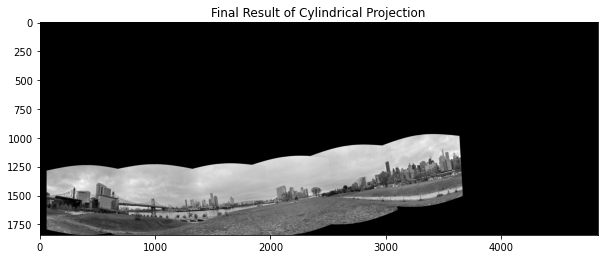

In [ ]:
i1_6 = stitch(i1_5, i6)

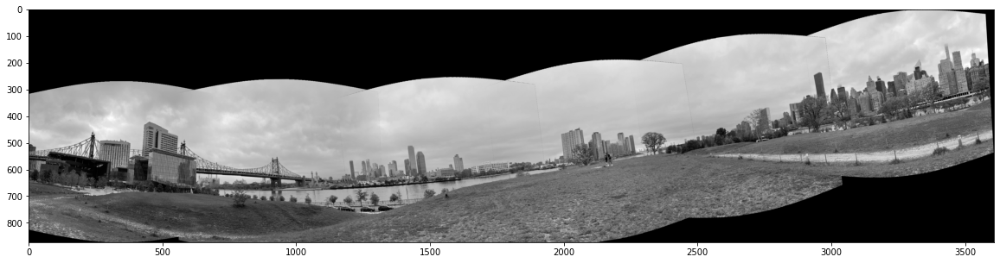

In [ ]:
i1_6_crop = edge_delete(i1_6)

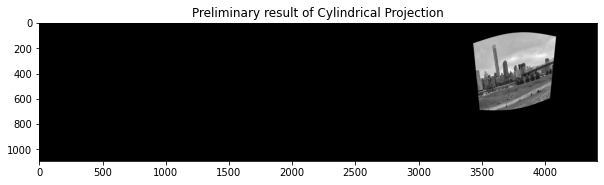

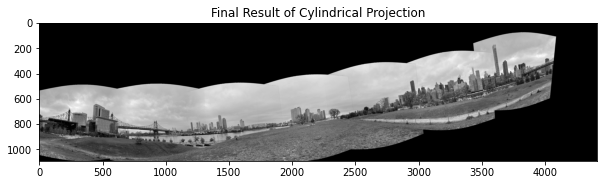

In [ ]:
i1_7 = stitch(i1_6_crop, i7)

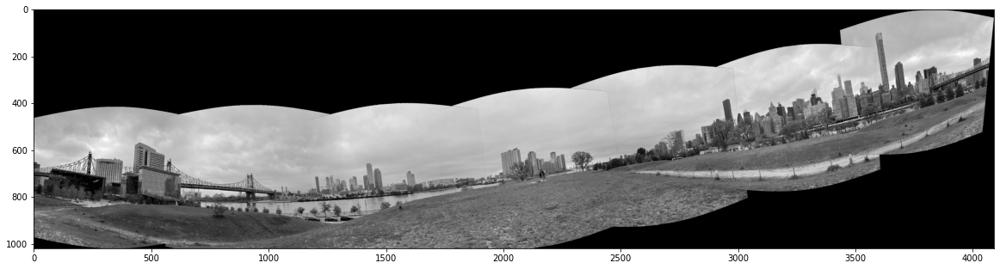

In [ ]:
i1_7_crop = edge_delete(i1_7)

# Improvement

*   左边拼到右边
*   调f
*   360特效（three.js)
*   一开始去黑边


